# Simple Linear Regression

In [1]:
import numpy as np
import tensorflow as tf
import statsmodels.api as sm
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import unipy.dataset.api as dm

/home/pydemia/apps/anaconda3/envs/tf-py36/lib/python3.6/importlib/_bootstrap.py:205: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)
/home/pydemia/apps/anaconda3/envs/tf-py36/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
dm.init()

['car90', 'births_small', 'births_big', 'breast_cancer', 'adult', 'diabetes', 'german_credit_scoring_fars2008', 'tips', 'titanic', 'winequality_red', 'nutrients', 'air_quality', 'anscombe', 'cars', 'iris', 'winequality_white']


In [3]:
#dm.init()
#data = dm.load('winequality_red')
data = dm.load('winequality_red')
data

Dataset : winequality_red


,fixed_acidity,volatile_acidity,citric_acid,residual_sugar,chlorides,free_sulfur_dioxide,total_sulfur_dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5
1,7.8,0.880,0.00,2.6,0.098,25.0,67.0,0.99680,3.20,0.68,9.8,5
2,7.8,0.760,0.04,2.3,0.092,15.0,54.0,0.99700,3.26,0.65,9.8,5
3,11.2,0.280,0.56,1.9,0.075,17.0,60.0,0.99800,3.16,0.58,9.8,6
4,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,5
5,7.4,0.660,0.00,1.8,0.075,13.0,40.0,0.99780,3.51,0.56,9.4,5
6,7.9,0.600,0.06,1.6,0.069,15.0,59.0,0.99640,3.30,0.46,9.4,5
7,7.3,0.650,0.00,1.2,0.065,15.0,21.0,0.99460,3.39,0.47,10.0,7
8,7.8,0.580,0.02,2.0,0.073,9.0,18.0,0.99680,3.36,0.57,9.5,7
9,7.5,0.500,0.36,6.1,0.071,17.0,102.0,0.99780,3.35,0.80,10.5,5


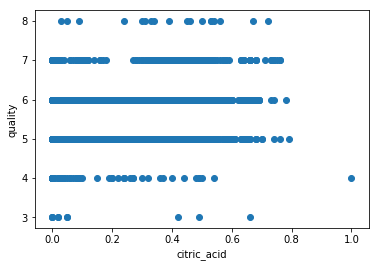

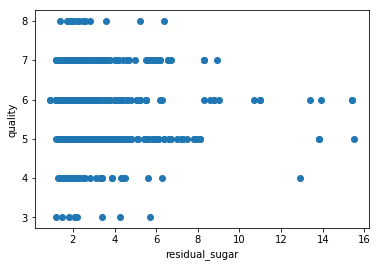

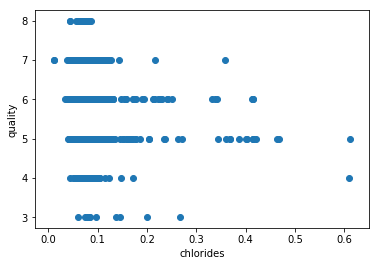

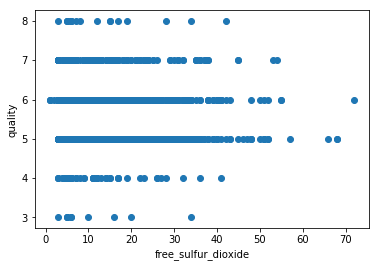

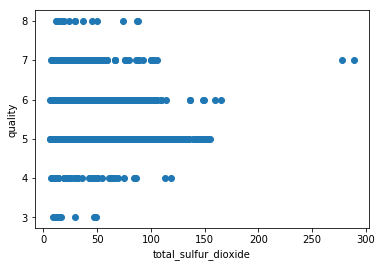

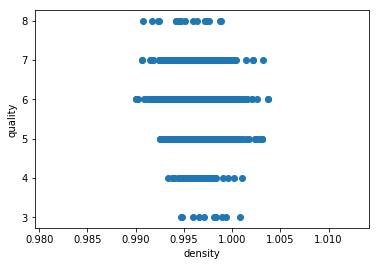

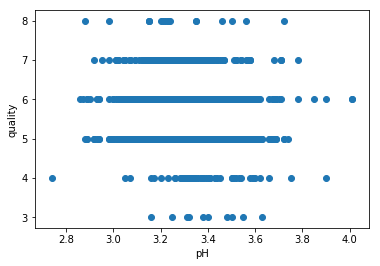

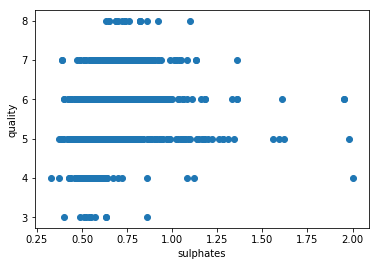

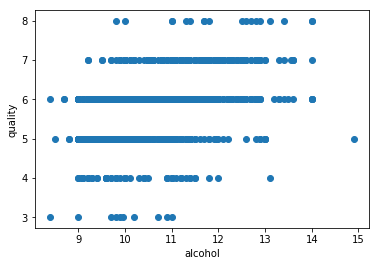

In [4]:
for _ in data.columns[2:-1]:
    x = data[_]
    y = data['quality']
    plt.scatter(x, y)
    plt.xlabel(_)
    plt.ylabel('quality')
    plt.show()

In [5]:
data.corr()

,fixed_acidity,volatile_acidity,citric_acid,residual_sugar,chlorides,free_sulfur_dioxide,total_sulfur_dioxide,density,pH,sulphates,alcohol,quality
fixed_acidity,1.000000,-0.256131,0.671703,0.114777,0.093705,-0.153794,-0.113181,0.668047,-0.682978,0.183006,-0.061668,0.124052
volatile_acidity,-0.256131,1.000000,-0.552496,0.001918,0.061298,-0.010504,0.076470,0.022026,0.234937,-0.260987,-0.202288,-0.390558
citric_acid,0.671703,-0.552496,1.000000,0.143577,0.203823,-0.060978,0.035533,0.364947,-0.541904,0.312770,0.109903,0.226373
residual_sugar,0.114777,0.001918,0.143577,1.000000,0.055610,0.187049,0.203028,0.355283,-0.085652,0.005527,0.042075,0.013732
chlorides,0.093705,0.061298,0.203823,0.055610,1.000000,0.005562,0.047400,0.200632,-0.265026,0.371260,-0.221141,-0.128907
free_sulfur_dioxide,-0.153794,-0.010504,-0.060978,0.187049,0.005562,1.000000,0.667666,-0.021946,0.070377,0.051658,-0.069408,-0.050656
total_sulfur_dioxide,-0.113181,0.076470,0.035533,0.203028,0.047400,0.667666,1.000000,0.071269,-0.066495,0.042947,-0.205654,-0.185100
density,0.668047,0.022026,0.364947,0.355283,0.200632,-0.021946,0.071269,1.000000,-0.341699,0.148506,-0.496180,-0.174919
pH,-0.682978,0.234937,-0.541904,-0.085652,-0.265026,0.070377,-0.066495,-0.341699,1.000000,-0.196648,0.205633,-0.057731
sulphates,0.183006,-0.260987,0.312770,0.005527,0.371260,0.051658,0.042947,0.148506,-0.196648,1.000000,0.093595,0.251397


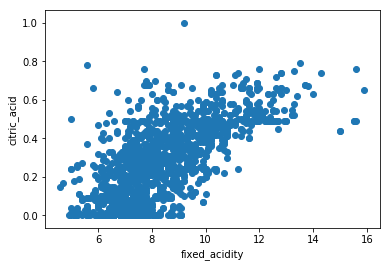

In [6]:
x = data['fixed_acidity']
y = data['citric_acid']
plt.scatter(x, y)
plt.xlabel('fixed_acidity')
plt.ylabel('citric_acid')
plt.show()

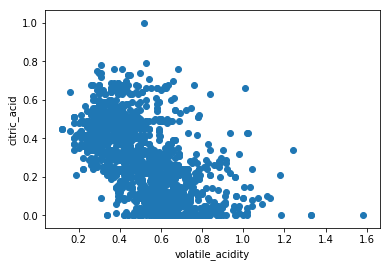

In [7]:
x = data['volatile_acidity']
y = data['citric_acid']
plt.scatter(x, y)
plt.xlabel('volatile_acidity')
plt.ylabel('citric_acid')
plt.show()

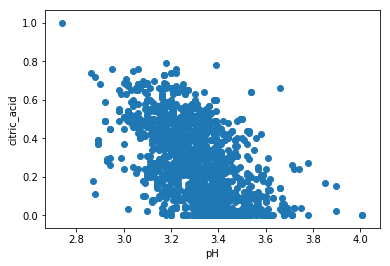

In [8]:
x = data['pH']
y = data['citric_acid']
plt.scatter(x, y)
plt.xlabel('pH')
plt.ylabel('citric_acid')
plt.show()

## Linear Regression with `statsmodel`

In [9]:
rowFlag = int(data.shape[0] * 7 /10)
colFlag = int(data.shape[1])
trainSet = data.iloc[:rowFlag, :]
testSet  = data.iloc[rowFlag:, :]

trainX0 = trainSet[['fixed_acidity']].values
trainX1 = trainSet[['fixed_acidity', 'volatile_acidity']].values
trainX2 = trainSet[['fixed_acidity', 'volatile_acidity', 'pH']].values

trainY = trainSet[['citric_acid']].values
testY  = testSet[['citric_acid']].values

ols_trainX1 = trainX1.copy()
ols_trainX1 = sm.add_constant(ols_trainX1)

est = sm.OLS(trainY, ols_trainX1).fit()
est.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.610
Model:                            OLS   Adj. R-squared:                  0.609
Method:                 Least Squares   F-statistic:                     871.7
Date:                Tue, 12 Jun 2018   Prob (F-statistic):          9.71e-229
Time:                        15:55:44   Log-Likelihood:                 746.75
No. Observations:                1119   AIC:                            -1488.
Df Residuals:                    1116   BIC:                            -1472.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0281      0.025     -1.144      0.253      -0.076       0.020
x1             0.0637      0.002     29.576      0.000       0.059       0.068
x2            -0.4378      0.022    -20.272      0.000      -0.480      -0.395
==============================================================================
Omnibus:                      177.067   Durbin-Watson:                   1.546
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              419.872
Skew:                           0.869   Prob(JB):                     6.70e-92
Kurtosis:                       5.446   Cond. No.                         72.0
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

---
## Start

In [10]:
learning_rate = .01
training_epochs = 10000  #
display_step = 100

In [11]:
rowFlag = int(data.shape[0] * 7 /10)
colFlag = int(data.shape[1])
trainSet = data.iloc[:rowFlag, :]
testSet  = data.iloc[rowFlag:, :]

trainX0 = trainSet[['fixed_acidity']].values
trainX1 = trainSet[['fixed_acidity', 'volatile_acidity']].values
trainX2 = trainSet[['fixed_acidity', 'volatile_acidity', 'pH']].values

trainY = trainSet[['citric_acid']].values
testY  = testSet[['citric_acid']].values

nDim0 = trainX0.shape[1]
nDim1 = trainX1.shape[1]
nDim2 = trainX2.shape[1]

In [12]:
print(trainX0.shape)
print(trainX1.shape)
print(trainX2.shape)
print(trainY.shape)

(1119, 1)
(1119, 2)
(1119, 3)
(1119, 1)


# Using `ndarray`, calculated by `tensorflow`

In [13]:
# Variables
trainX0
trainY

W0 = tf.Variable(tf.random_uniform([1], -1, 1), name='weight')
b0 = tf.Variable(tf.random_uniform([1], -1, 1), name='bias')

In [14]:
y_0 = trainX0 * W0 + b0
costFunc = tf.reduce_mean(tf.square(y_0 - trainY))  # Mean Squared Error

optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
model0 = optimizer.minimize(costFunc)

In [15]:
config = tf.ConfigProto(log_device_placement=True)
config.gpu_options.allow_growth = True
with tf.Session(config=config) as sess:
    sess.run(tf.global_variables_initializer())
    for step in range(training_epochs):
        
        sess.run(model0)

        if step % display_step == 0:
            print(step, sess.run(W0), sess.run(b0))

0 [0.25169384] [-0.47627124]
100 [0.08926239] [-0.48366025]
200 [0.08819776] [-0.4740311]
300 [0.08721602] [-0.4651517]
400 [0.08631074] [-0.4569638]
500 [0.08547597] [-0.4494136]
600 [0.08470619] [-0.4424513]
700 [0.08399635] [-0.43603107]
800 [0.08334178] [-0.4301108]
900 [0.0827382] [-0.42465165]
1000 [0.08218163] [-0.41961765]
1100 [0.08166838] [-0.41497558]
1200 [0.08119511] [-0.41069505]
1300 [0.08075869] [-0.40674782]
1400 [0.08035625] [-0.40310788]
1500 [0.07998515] [-0.39975145]
1600 [0.07964295] [-0.39665642]
1700 [0.0793274] [-0.39380234]
1800 [0.07903641] [-0.39117053]
1900 [0.07876809] [-0.3887437]
2000 [0.07852066] [-0.38650578]
2100 [0.0782925] [-0.38444215]
2200 [0.07808211] [-0.38253924]
2300 [0.0778881] [-0.38078457]
2400 [0.0777092] [-0.37916648]
2500 [0.07754423] [-0.37767443]
2600 [0.07739211] [-0.37629855]
2700 [0.07725183] [-0.3750297]
2800 [0.07712246] [-0.3738597]
2900 [0.07700319] [-0.37278092]
3000 [0.0768932] [-0.37178603]
3100 [0.07679177] [-0.37086865]
320

### Using `tf.placeholder`

In [16]:
# Variables
trainX0
trainY

X0 = tf.placeholder(tf.float32, [None, nDim0])
Y_train = tf.placeholder(tf.float32, [None, 1])

W0 = tf.Variable(tf.random_uniform([nDim0, 1], -1, 1), name='weight')
b0 = tf.Variable(tf.random_uniform([1], -1, 1), name='bias')

In [17]:
y_pred = tf.add(tf.matmul(X0, W0), b0)

costFunc = tf.reduce_mean(tf.square(Y_train - y_pred))  # Mean Squared Error
Y_mean = tf.reduce_mean(Y_train)
rsquareFunc = 1 - (tf.reduce_sum(tf.square(Y_train - y_pred)) /
                   tf.reduce_sum(tf.square(Y_train - Y_mean)))
#rsquareFunc = tf.reduce_sum(tf.square(y_pred - Y_mean)) / tf.reduce_sum(tf.square(y_train - Y_mean))

optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
model0 = optimizer.minimize(costFunc)

In [18]:
config = tf.ConfigProto(log_device_placement=True)
config.gpu_options.allow_growth = True
with tf.Session(config=config) as sess:
    sess.run(tf.global_variables_initializer())
    for step in range(training_epochs):
        
        feedDict = feedDict = {X0: trainX0, Y_train: trainY}
        sess.run(model0, feed_dict=feedDict)

        if step % display_step == 0:
            print(step, sess.run(W0), sess.run(b0))

0 [[-0.19447282]] [-0.05972227]
100 [[0.04233795]] [-0.05924828]
200 [[0.04492738]] [-0.08266863]
300 [[0.04731517]] [-0.10426524]
400 [[0.04951703]] [-0.12418009]
500 [[0.05154743]] [-0.14254418]
600 [[0.05341971]] [-0.15947823]
700 [[0.0551462]] [-0.17509358]
800 [[0.05673824]] [-0.1894929]
900 [[0.05820631]] [-0.20277104]
1000 [[0.05956006]] [-0.21501508]
1100 [[0.06080838]] [-0.22630565]
1200 [[0.06195951]] [-0.23671706]
1300 [[0.06302098]] [-0.24631768]
1400 [[0.06399982]] [-0.25517082]
1500 [[0.0649024]] [-0.2633344]
1600 [[0.06573476]] [-0.27086264]
1700 [[0.06650225]] [-0.27780432]
1800 [[0.06720998]] [-0.28420547]
1900 [[0.06786261]] [-0.29010814]
2000 [[0.0684644]] [-0.29555112]
2100 [[0.06901934]] [-0.30057028]
2200 [[0.06953105]] [-0.30519852]
2300 [[0.07000292]] [-0.3094664]
2400 [[0.07043803]] [-0.31340185]
2500 [[0.07083929]] [-0.31703103]
2600 [[0.0712093]] [-0.32037756]
2700 [[0.07155049]] [-0.32346347]
2800 [[0.0718651]] [-0.32630903]
2900 [[0.07215522]] [-0.32893306]

STEP:   0, MSE: 28.5987, R2: -723.1653
Weights: [[-0.6264665]], Bias: [0.53731906]


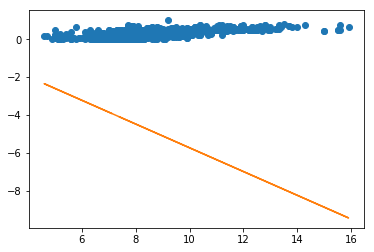

STEP: 100, MSE: 0.0534, R2: -0.3532
Weights: [[-0.02260828]], Bias: [0.5281632]


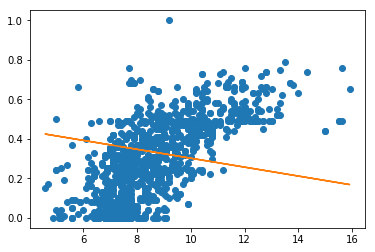

STEP: 200, MSE: 0.0486, R2: -0.2306
Weights: [[-0.0149614]], Bias: [0.4590003]


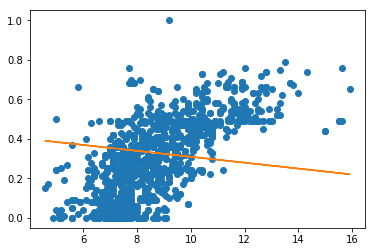

STEP: 300, MSE: 0.0445, R2: -0.1263
Weights: [[-0.00790999]], Bias: [0.39522326]


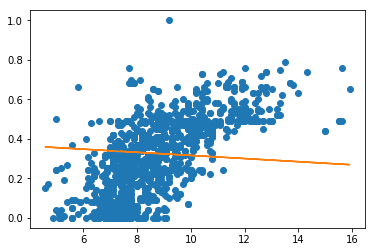

STEP: 400, MSE: 0.0410, R2: -0.0377
Weights: [[-0.00140768]], Bias: [0.33641264]


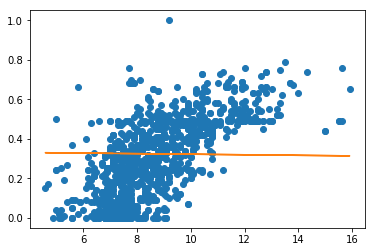

STEP: 500, MSE: 0.0380, R2: 0.0377
Weights: [[0.00458828]], Bias: [0.28218162]


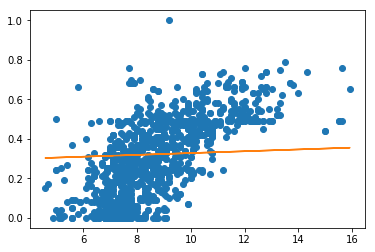

STEP: 600, MSE: 0.0355, R2: 0.1018
Weights: [[0.01011733]], Bias: [0.2321737]


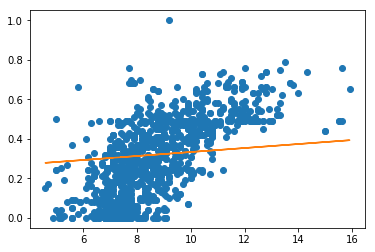

STEP: 700, MSE: 0.0333, R2: 0.1563
Weights: [[0.01521582]], Bias: [0.18605997]


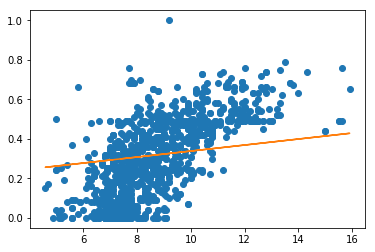

STEP: 800, MSE: 0.0315, R2: 0.2027
Weights: [[0.0199173]], Bias: [0.1435371]


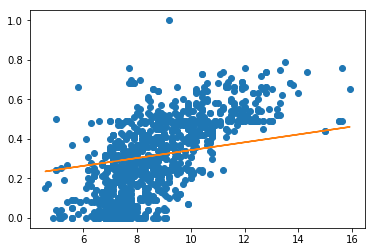

STEP: 900, MSE: 0.0299, R2: 0.2421
Weights: [[0.02425265]], Bias: [0.10432564]


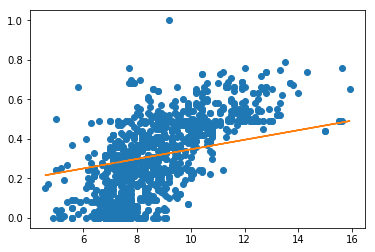

STEP: 1000, MSE: 0.0286, R2: 0.2756
Weights: [[0.02825041]], Bias: [0.06816758]


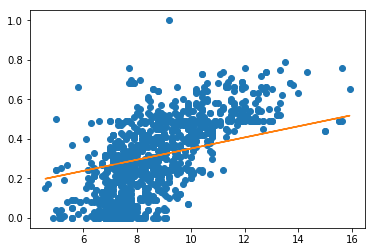

STEP: 1100, MSE: 0.0275, R2: 0.3041
Weights: [[0.03193686]], Bias: [0.03482518]


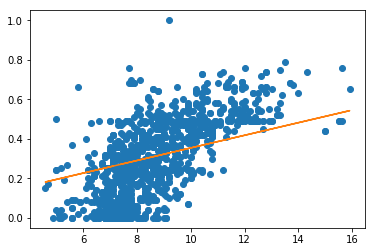

STEP: 1200, MSE: 0.0265, R2: 0.3283
Weights: [[0.03533624]], Bias: [0.00407919]


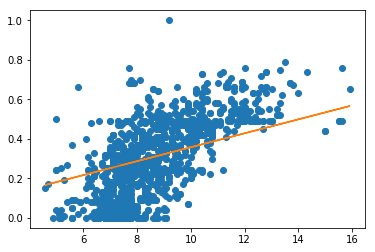

STEP: 1300, MSE: 0.0257, R2: 0.3490
Weights: [[0.03847091]], Bias: [-0.02427257]


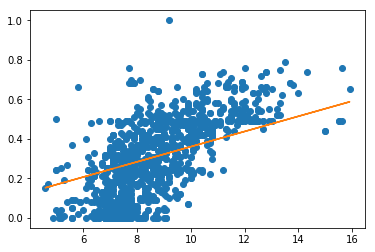

STEP: 1400, MSE: 0.0250, R2: 0.3665
Weights: [[0.04136148]], Bias: [-0.05041653]


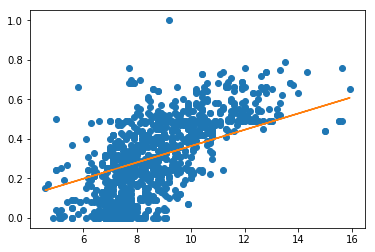

STEP: 1500, MSE: 0.0244, R2: 0.3814
Weights: [[0.04402695]], Bias: [-0.0745246]


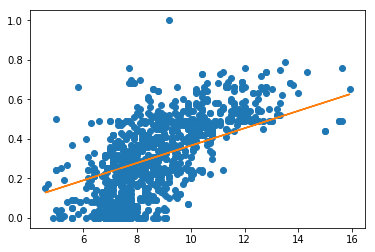

STEP: 1600, MSE: 0.0239, R2: 0.3940
Weights: [[0.04648486]], Bias: [-0.09675539]


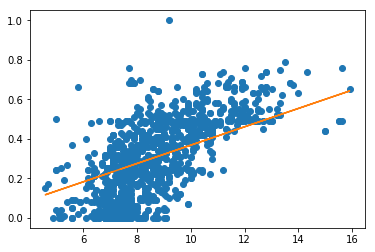

STEP: 1700, MSE: 0.0235, R2: 0.4048
Weights: [[0.04875137]], Bias: [-0.11725501]


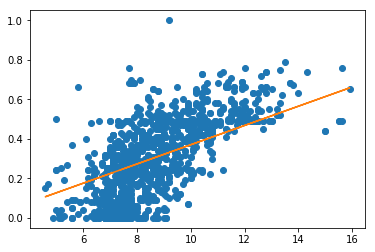

STEP: 1800, MSE: 0.0231, R2: 0.4140
Weights: [[0.05084139]], Bias: [-0.13615836]


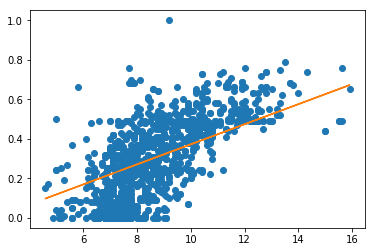

STEP: 1900, MSE: 0.0228, R2: 0.4218
Weights: [[0.05276865]], Bias: [-0.15358965]


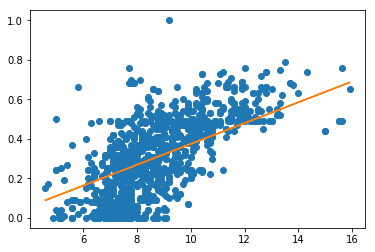

STEP: 2000, MSE: 0.0226, R2: 0.4284
Weights: [[0.05454583]], Bias: [-0.1696635]


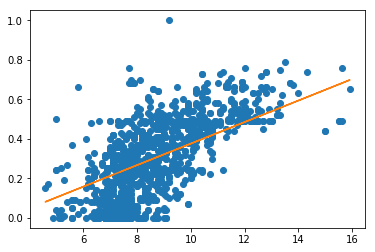

STEP: 2100, MSE: 0.0224, R2: 0.4340
Weights: [[0.05618462]], Bias: [-0.18448567]


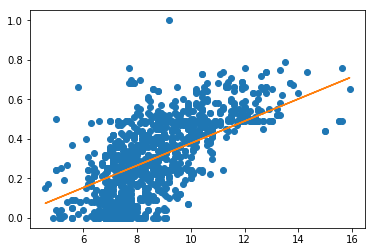

STEP: 2200, MSE: 0.0222, R2: 0.4388
Weights: [[0.05769579]], Bias: [-0.19815357]


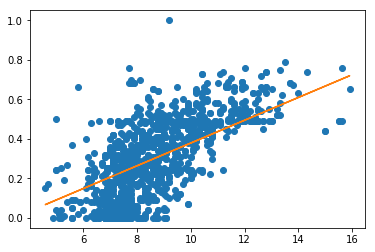

STEP: 2300, MSE: 0.0220, R2: 0.4429
Weights: [[0.0590893]], Bias: [-0.21075724]


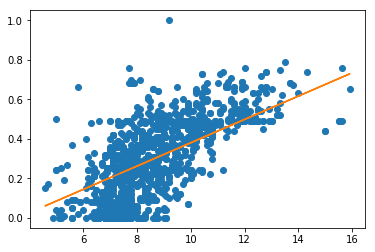

STEP: 2400, MSE: 0.0219, R2: 0.4463
Weights: [[0.06037429]], Bias: [-0.22237946]


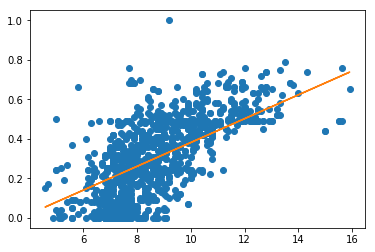

STEP: 2500, MSE: 0.0217, R2: 0.4493
Weights: [[0.06155921]], Bias: [-0.23309654]


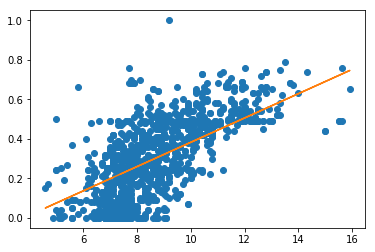

STEP: 2600, MSE: 0.0216, R2: 0.4518
Weights: [[0.06265186]], Bias: [-0.24297911]


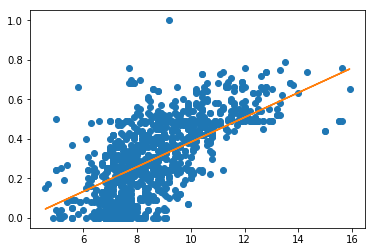

STEP: 2700, MSE: 0.0216, R2: 0.4539
Weights: [[0.06365941]], Bias: [-0.25209203]


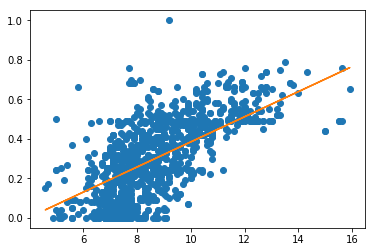

STEP: 2800, MSE: 0.0215, R2: 0.4557
Weights: [[0.06458852]], Bias: [-0.2604954]


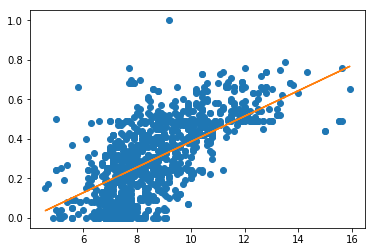

STEP: 2900, MSE: 0.0214, R2: 0.4573
Weights: [[0.06544526]], Bias: [-0.26824427]


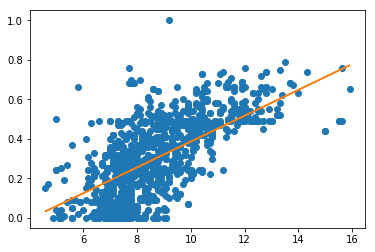

STEP: 3000, MSE: 0.0214, R2: 0.4586
Weights: [[0.06623529]], Bias: [-0.27538976]


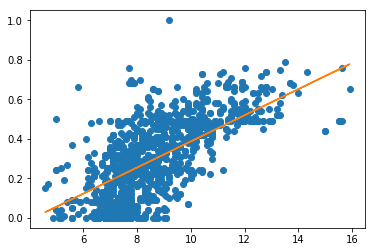

STEP: 3100, MSE: 0.0213, R2: 0.4597
Weights: [[0.06696381]], Bias: [-0.28197888]


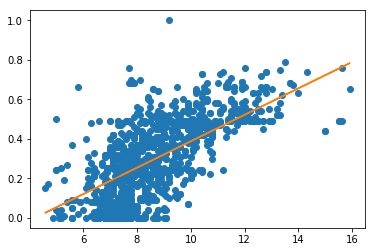

STEP: 3200, MSE: 0.0213, R2: 0.4606
Weights: [[0.0676356]], Bias: [-0.28805494]


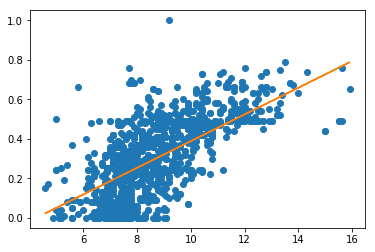

STEP: 3300, MSE: 0.0213, R2: 0.4614
Weights: [[0.06825509]], Bias: [-0.29365802]


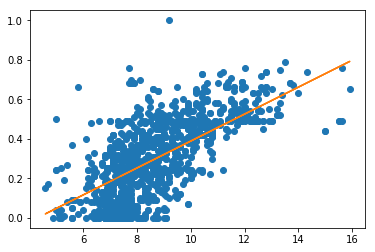

STEP: 3400, MSE: 0.0212, R2: 0.4621
Weights: [[0.06882633]], Bias: [-0.29882455]


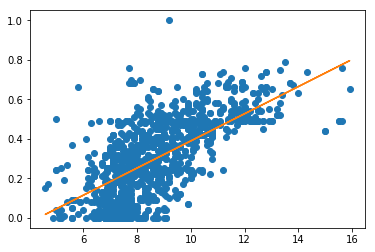

STEP: 3500, MSE: 0.0212, R2: 0.4627
Weights: [[0.06935309]], Bias: [-0.3035889]


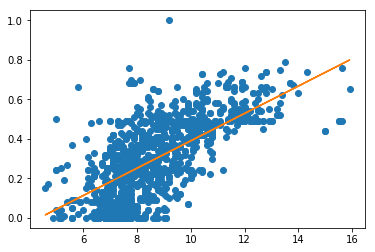

STEP: 3600, MSE: 0.0212, R2: 0.4632
Weights: [[0.06983881]], Bias: [-0.30798215]


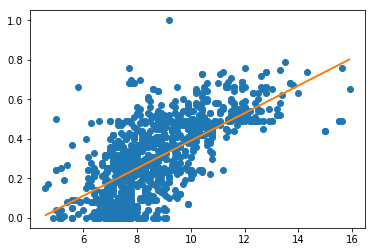

STEP: 3700, MSE: 0.0212, R2: 0.4636
Weights: [[0.07028673]], Bias: [-0.31203327]


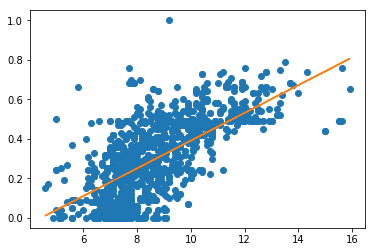

STEP: 3800, MSE: 0.0212, R2: 0.4640
Weights: [[0.07069978]], Bias: [-0.31576923]


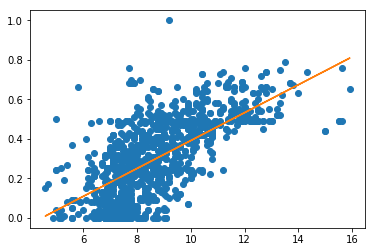

STEP: 3900, MSE: 0.0212, R2: 0.4643
Weights: [[0.07108065]], Bias: [-0.31921402]


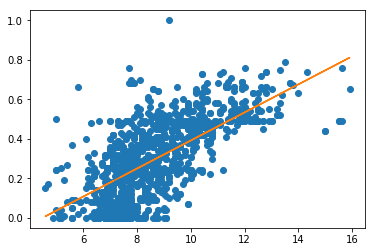

STEP: 4000, MSE: 0.0211, R2: 0.4645
Weights: [[0.07143185]], Bias: [-0.3223905]


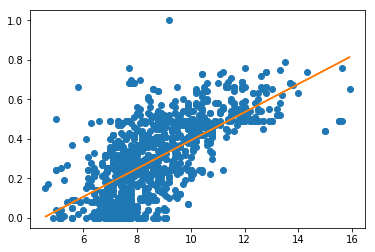

STEP: 4100, MSE: 0.0211, R2: 0.4648
Weights: [[0.07175571]], Bias: [-0.32531962]


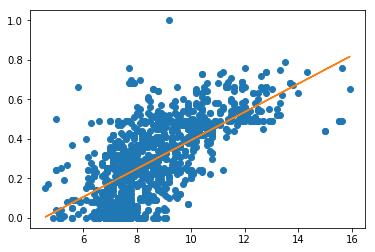

STEP: 4200, MSE: 0.0211, R2: 0.4649
Weights: [[0.07205436]], Bias: [-0.32802072]


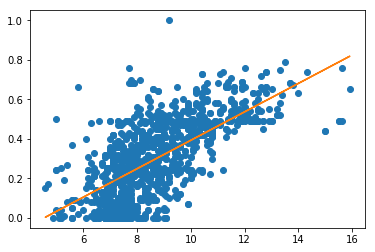

STEP: 4300, MSE: 0.0211, R2: 0.4651
Weights: [[0.07232973]], Bias: [-0.33051142]


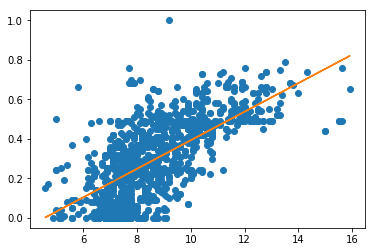

STEP: 4400, MSE: 0.0211, R2: 0.4652
Weights: [[0.07258368]], Bias: [-0.3328082]


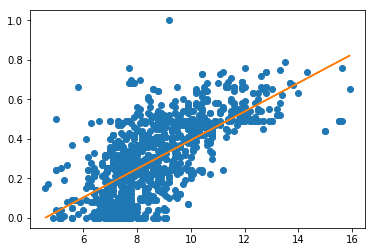

STEP: 4500, MSE: 0.0211, R2: 0.4654
Weights: [[0.07281783]], Bias: [-0.33492613]


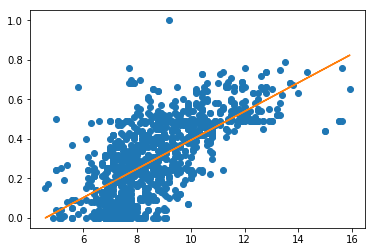

STEP: 4600, MSE: 0.0211, R2: 0.4655
Weights: [[0.07303377]], Bias: [-0.3368791]


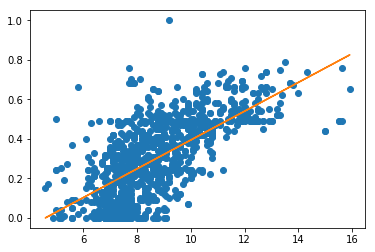

STEP: 4700, MSE: 0.0211, R2: 0.4655
Weights: [[0.07323287]], Bias: [-0.33867994]


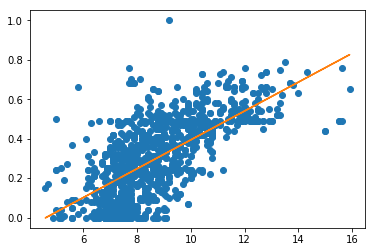

STEP: 4800, MSE: 0.0211, R2: 0.4656
Weights: [[0.07341648]], Bias: [-0.34034058]


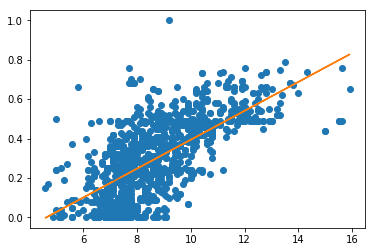

STEP: 4900, MSE: 0.0211, R2: 0.4657
Weights: [[0.07358579]], Bias: [-0.3418719]


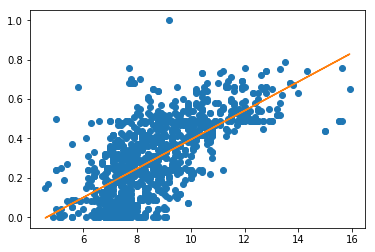

STEP: 5000, MSE: 0.0211, R2: 0.4657
Weights: [[0.0737419]], Bias: [-0.3432839]


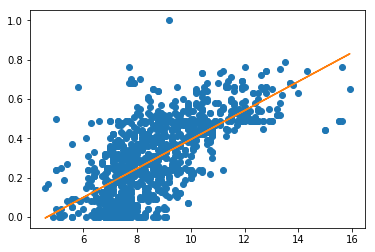

STEP: 5100, MSE: 0.0211, R2: 0.4658
Weights: [[0.07388587]], Bias: [-0.34458604]


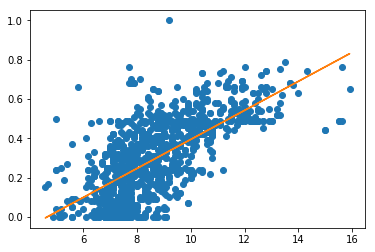

STEP: 5200, MSE: 0.0211, R2: 0.4658
Weights: [[0.07401864]], Bias: [-0.3457869]


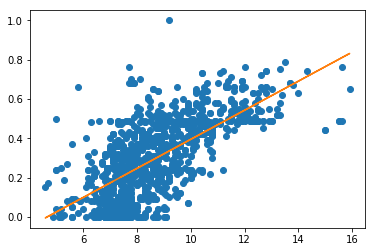

STEP: 5300, MSE: 0.0211, R2: 0.4658
Weights: [[0.07414105]], Bias: [-0.34689403]


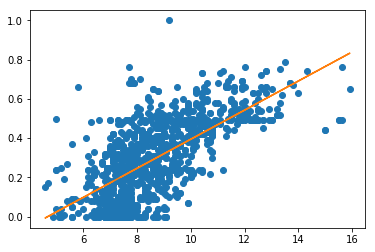

STEP: 5400, MSE: 0.0211, R2: 0.4659
Weights: [[0.07425393]], Bias: [-0.34791502]


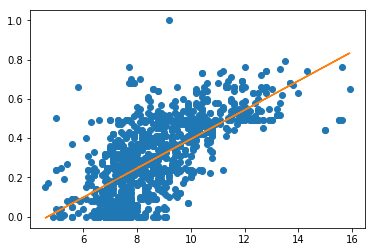

STEP: 5500, MSE: 0.0211, R2: 0.4659
Weights: [[0.07435803]], Bias: [-0.3488565]


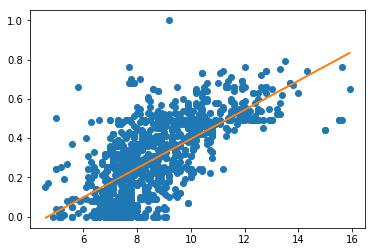

STEP: 5600, MSE: 0.0211, R2: 0.4659
Weights: [[0.07445402]], Bias: [-0.34972465]


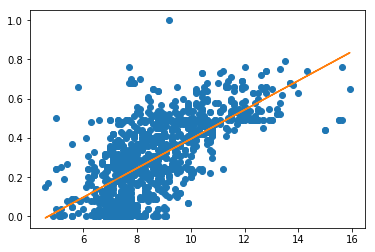

STEP: 5700, MSE: 0.0211, R2: 0.4659
Weights: [[0.07454252]], Bias: [-0.3505252]


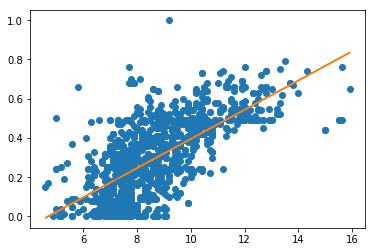

STEP: 5800, MSE: 0.0211, R2: 0.4659
Weights: [[0.07462415]], Bias: [-0.3512635]


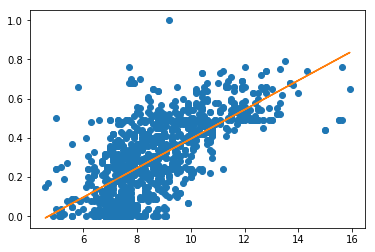

STEP: 5900, MSE: 0.0211, R2: 0.4659
Weights: [[0.07469942]], Bias: [-0.3519442]


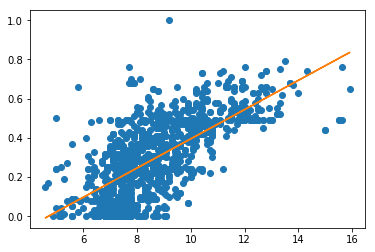

STEP: 6000, MSE: 0.0211, R2: 0.4660
Weights: [[0.07476882]], Bias: [-0.3525719]


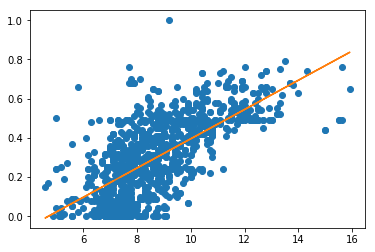

STEP: 6100, MSE: 0.0211, R2: 0.4660
Weights: [[0.07483282]], Bias: [-0.3531508]


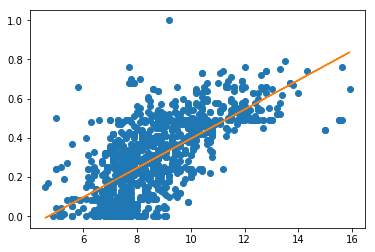

STEP: 6200, MSE: 0.0211, R2: 0.4660
Weights: [[0.07489184]], Bias: [-0.35368457]


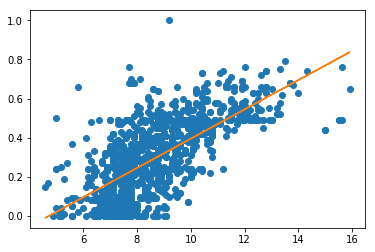

STEP: 6300, MSE: 0.0211, R2: 0.4660
Weights: [[0.07494625]], Bias: [-0.3541768]


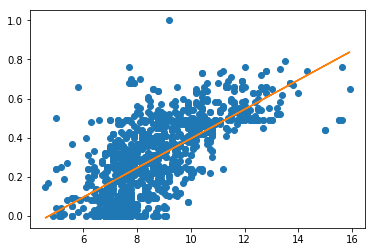

STEP: 6400, MSE: 0.0211, R2: 0.4660
Weights: [[0.07499643]], Bias: [-0.35463062]


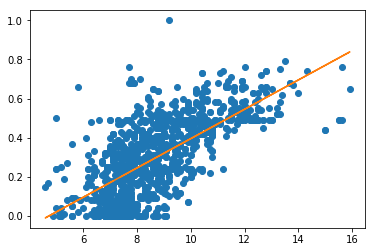

STEP: 6500, MSE: 0.0211, R2: 0.4660
Weights: [[0.07504271]], Bias: [-0.35504916]


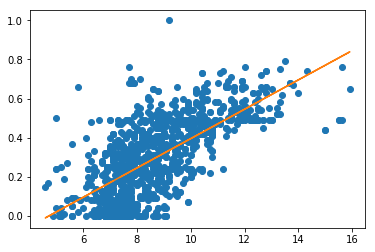

STEP: 6600, MSE: 0.0211, R2: 0.4660
Weights: [[0.07508538]], Bias: [-0.3554351]


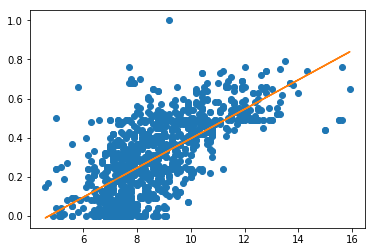

STEP: 6700, MSE: 0.0211, R2: 0.4660
Weights: [[0.07512473]], Bias: [-0.35579097]


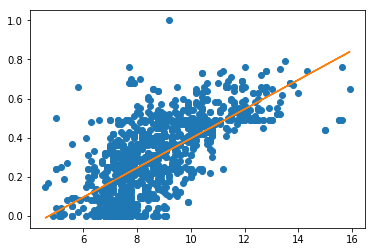

STEP: 6800, MSE: 0.0211, R2: 0.4660
Weights: [[0.07516101]], Bias: [-0.35611916]


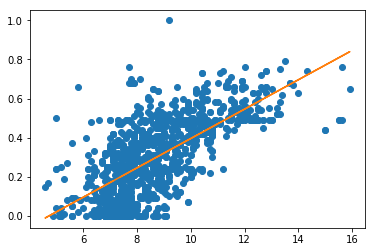

STEP: 6900, MSE: 0.0211, R2: 0.4660
Weights: [[0.07519447]], Bias: [-0.3564218]


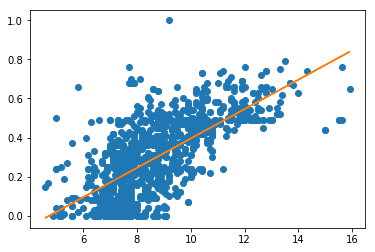

STEP: 7000, MSE: 0.0211, R2: 0.4660
Weights: [[0.07522532]], Bias: [-0.3567008]


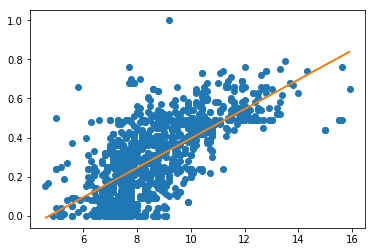

STEP: 7100, MSE: 0.0211, R2: 0.4660
Weights: [[0.07525377]], Bias: [-0.35695812]


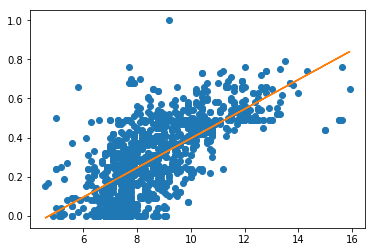

STEP: 7200, MSE: 0.0211, R2: 0.4660
Weights: [[0.07528001]], Bias: [-0.35719544]


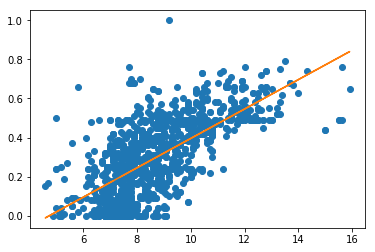

STEP: 7300, MSE: 0.0211, R2: 0.4660
Weights: [[0.0753042]], Bias: [-0.35741428]


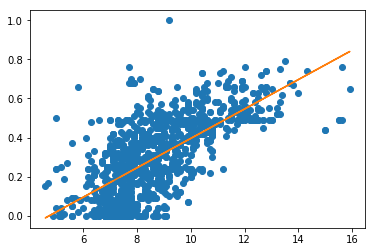

STEP: 7400, MSE: 0.0211, R2: 0.4660
Weights: [[0.07532651]], Bias: [-0.357616]


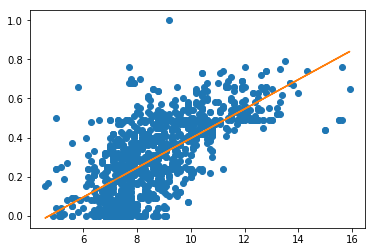

STEP: 7500, MSE: 0.0211, R2: 0.4660
Weights: [[0.07534708]], Bias: [-0.35780206]


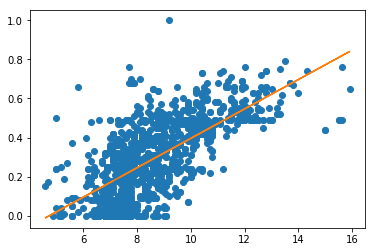

STEP: 7600, MSE: 0.0211, R2: 0.4660
Weights: [[0.07536605]], Bias: [-0.35797366]


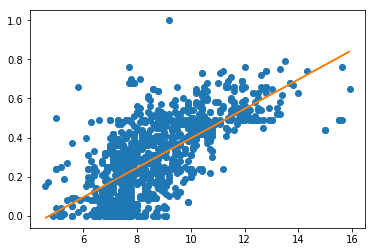

STEP: 7700, MSE: 0.0211, R2: 0.4660
Weights: [[0.07538354]], Bias: [-0.3581319]


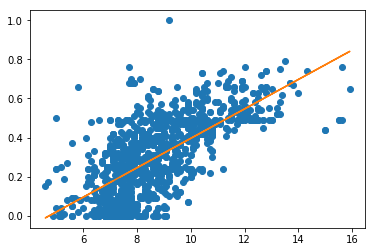

STEP: 7800, MSE: 0.0211, R2: 0.4660
Weights: [[0.07539967]], Bias: [-0.35827777]


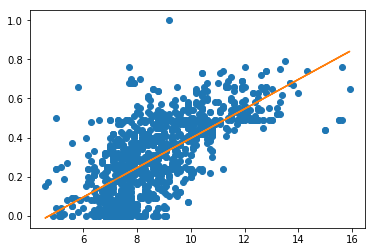

STEP: 7900, MSE: 0.0211, R2: 0.4660
Weights: [[0.07541455]], Bias: [-0.35841236]


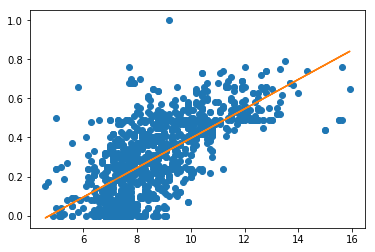

STEP: 8000, MSE: 0.0211, R2: 0.4660
Weights: [[0.07542826]], Bias: [-0.35853633]


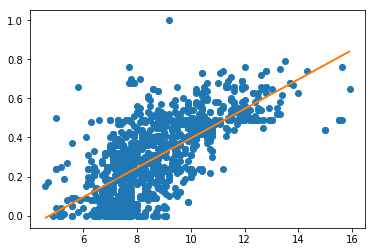

STEP: 8100, MSE: 0.0211, R2: 0.4660
Weights: [[0.07544091]], Bias: [-0.35865077]


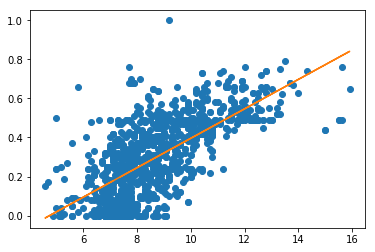

STEP: 8200, MSE: 0.0211, R2: 0.4660
Weights: [[0.07545258]], Bias: [-0.35875627]


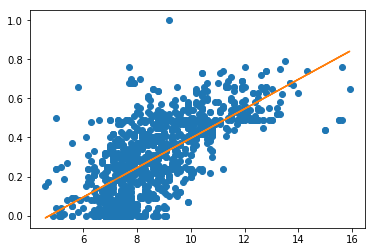

STEP: 8300, MSE: 0.0211, R2: 0.4660
Weights: [[0.07546334]], Bias: [-0.3588536]


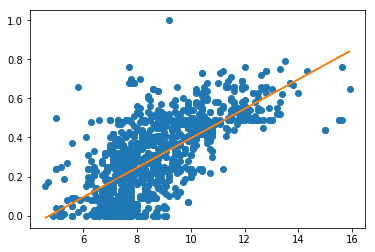

STEP: 8400, MSE: 0.0211, R2: 0.4660
Weights: [[0.07547325]], Bias: [-0.35894325]


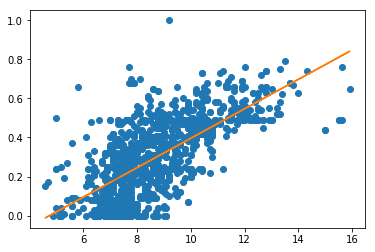

STEP: 8500, MSE: 0.0211, R2: 0.4660
Weights: [[0.07548241]], Bias: [-0.35902607]


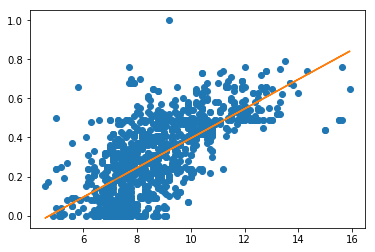

STEP: 8600, MSE: 0.0211, R2: 0.4660
Weights: [[0.07549084]], Bias: [-0.35910237]


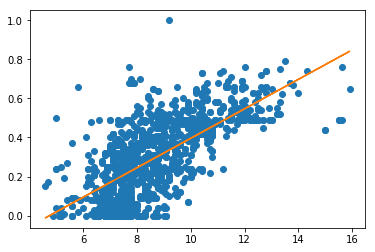

STEP: 8700, MSE: 0.0211, R2: 0.4660
Weights: [[0.07549861]], Bias: [-0.3591726]


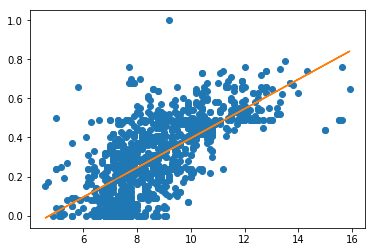

STEP: 8800, MSE: 0.0211, R2: 0.4660
Weights: [[0.07550578]], Bias: [-0.3592374]


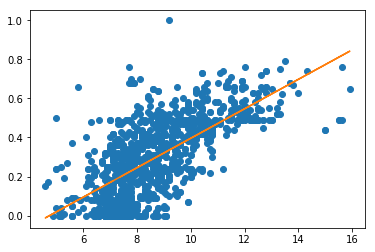

STEP: 8900, MSE: 0.0211, R2: 0.4660
Weights: [[0.07551239]], Bias: [-0.35929728]


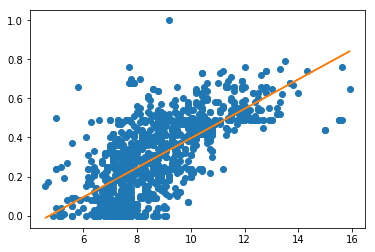

STEP: 9000, MSE: 0.0211, R2: 0.4660
Weights: [[0.07551849]], Bias: [-0.3593524]


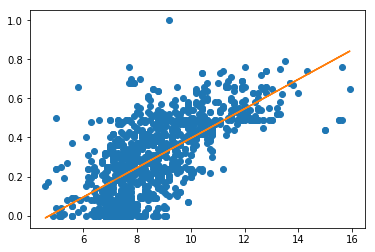

STEP: 9100, MSE: 0.0211, R2: 0.4660
Weights: [[0.07552413]], Bias: [-0.3594034]


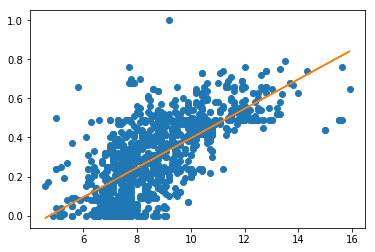

STEP: 9200, MSE: 0.0211, R2: 0.4660
Weights: [[0.07552929]], Bias: [-0.35945013]


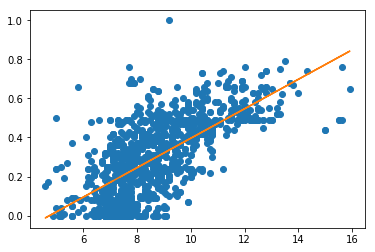

STEP: 9300, MSE: 0.0211, R2: 0.4660
Weights: [[0.07553407]], Bias: [-0.35949335]


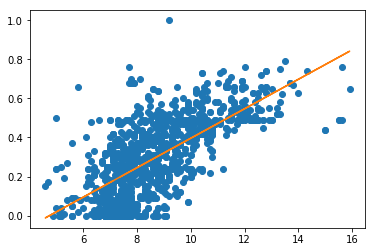

STEP: 9400, MSE: 0.0211, R2: 0.4660
Weights: [[0.07553849]], Bias: [-0.35953325]


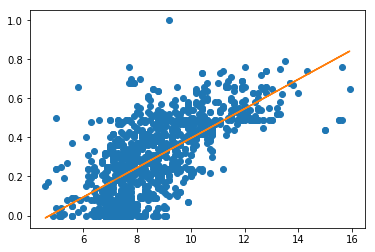

STEP: 9500, MSE: 0.0211, R2: 0.4660
Weights: [[0.07554255]], Bias: [-0.35957]


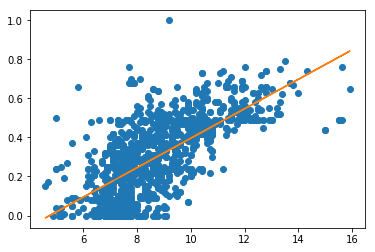

STEP: 9600, MSE: 0.0211, R2: 0.4660
Weights: [[0.07554629]], Bias: [-0.35960385]


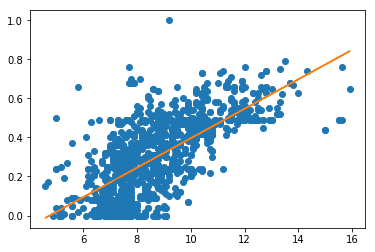

STEP: 9700, MSE: 0.0211, R2: 0.4660
Weights: [[0.07554974]], Bias: [-0.35963508]


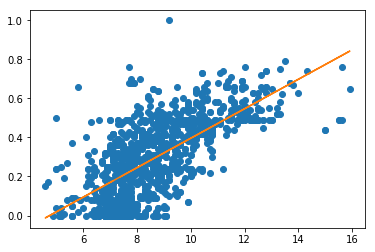

STEP: 9800, MSE: 0.0211, R2: 0.4660
Weights: [[0.07555295]], Bias: [-0.35966405]


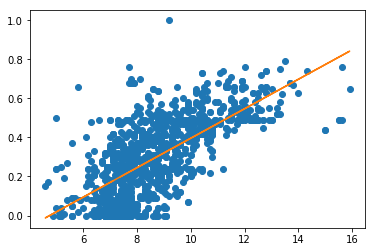

STEP: 9900, MSE: 0.0211, R2: 0.4660
Weights: [[0.07555591]], Bias: [-0.35969087]


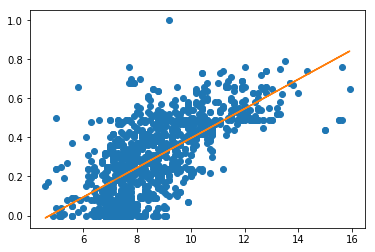

In [19]:
config = tf.ConfigProto(log_device_placement=True)
config.gpu_options.allow_growth = True
with tf.Session(config=config) as sess:
    sess.run(tf.global_variables_initializer())
    for step in range(training_epochs):
        
        feedDict = feedDict = {X0: trainX0, Y_train: trainY}
        #sess.run(model0, feed_dict=feedDict)
        model0.run(feedDict)

        if step % display_step == 0:
            cost_step = costFunc.eval(feedDict)
            rsquare = rsquareFunc.eval(feedDict)
            msg0 = 'STEP: {:>3}, MSE: {:02.4f}, R2: {:02.4f}'.format(step, cost_step, rsquare)
            msg1 = 'Weights: {}, Bias: {}'.format(sess.run(W0).reshape((1,1)), sess.run(b0))
            print(msg0)
            print(msg1)
            
            plt.plot(trainX0, trainY, 'o', label='STEP: {step}'.format(step=step))
            plt.plot(trainX0, sess.run(W0) * trainX0 + sess.run(b0))
            plt.show()

### Using `tf.placeholder`, 2 columns

In [20]:
# Variables
X1 = tf.placeholder(tf.float32, [None, nDim1])
Y_train = tf.placeholder(tf.float32, [None, 1])

W1 = tf.Variable(tf.random_normal([nDim1, 1]), name='weight')
b1 = tf.Variable(tf.random_normal([1]), name='bias')

In [21]:
y_pred = tf.add(tf.matmul(X1, W1), b1)

costFunc = tf.reduce_mean(tf.square(Y_train - y_pred))  # Mean Squared Error
Y_mean = tf.reduce_mean(Y_train)
rsquareFunc = 1 - (tf.reduce_sum(tf.square(Y_train - y_pred)) / tf.reduce_sum(tf.square(Y_train - Y_mean)))
#rsquareFunc = tf.reduce_sum(tf.square(y_pred - Y_mean)) / tf.reduce_sum(tf.square(y_train - Y_mean))

optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
model1 = optimizer.minimize(costFunc)

STEP:   0, MSE: 0.7857, R2: -18.8957
Weights: [[0.00169224 0.2925689 ]], Bias: [-0.72743595]


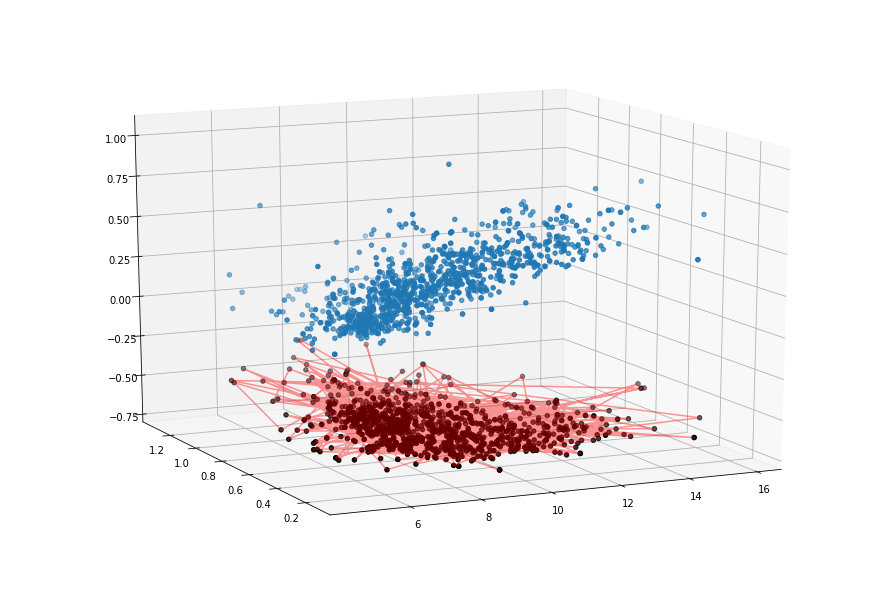

STEP: 100, MSE: 0.0309, R2: 0.2185
Weights: [[0.09882209 0.26409507]], Bias: [-0.70535725]


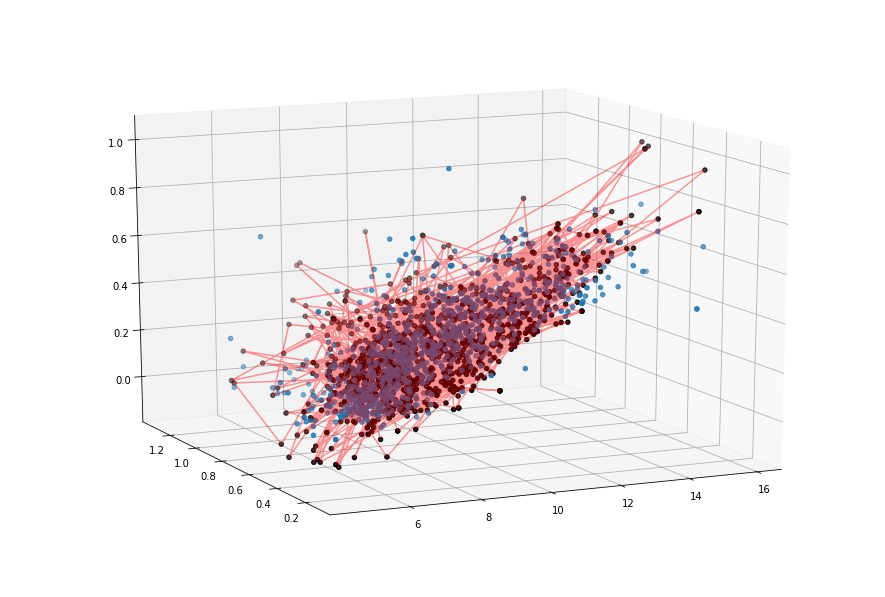

STEP: 200, MSE: 0.0297, R2: 0.2471
Weights: [[0.09921569 0.23286644]], Bias: [-0.6929304]


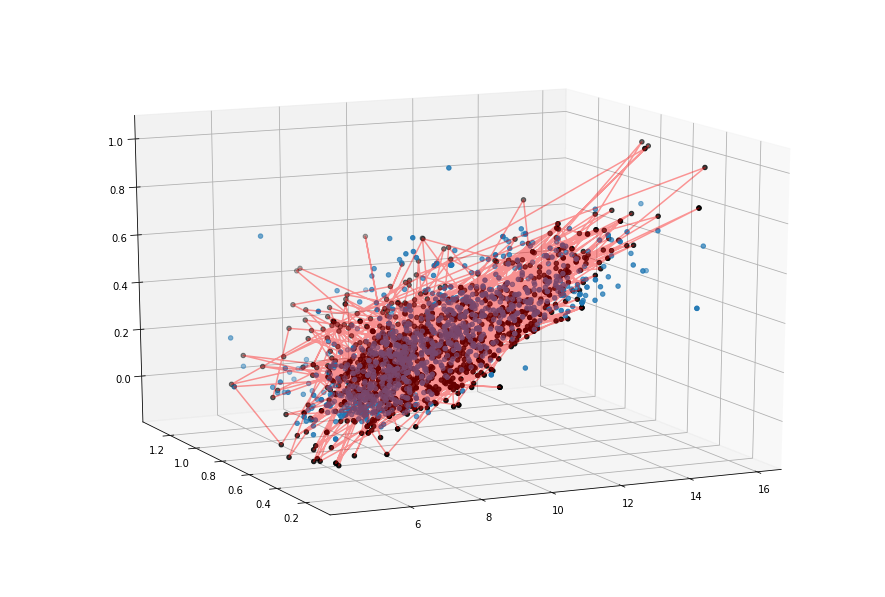

STEP: 300, MSE: 0.0287, R2: 0.2726
Weights: [[0.0993871  0.20402032]], Bias: [-0.67971385]


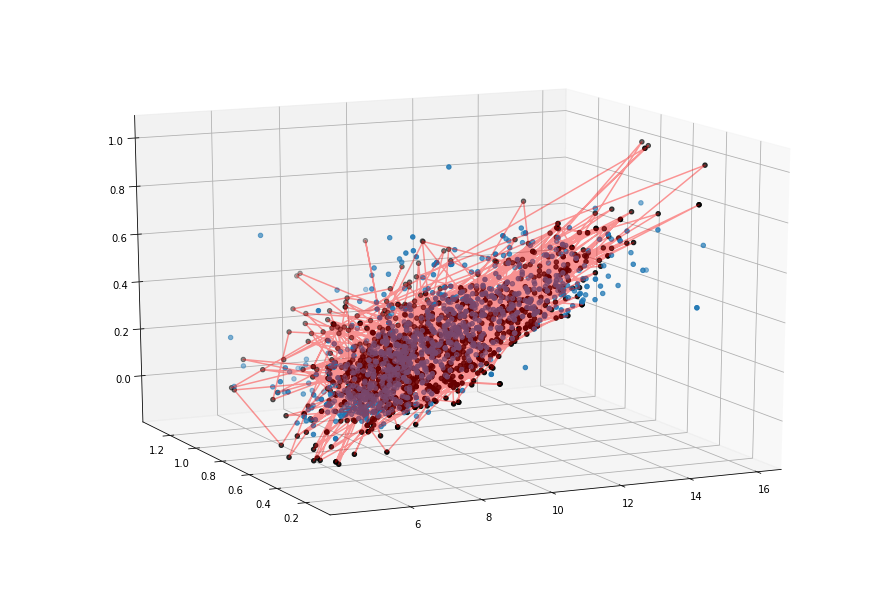

STEP: 400, MSE: 0.0278, R2: 0.2955
Weights: [[0.09937339 0.17727736]], Bias: [-0.66589993]


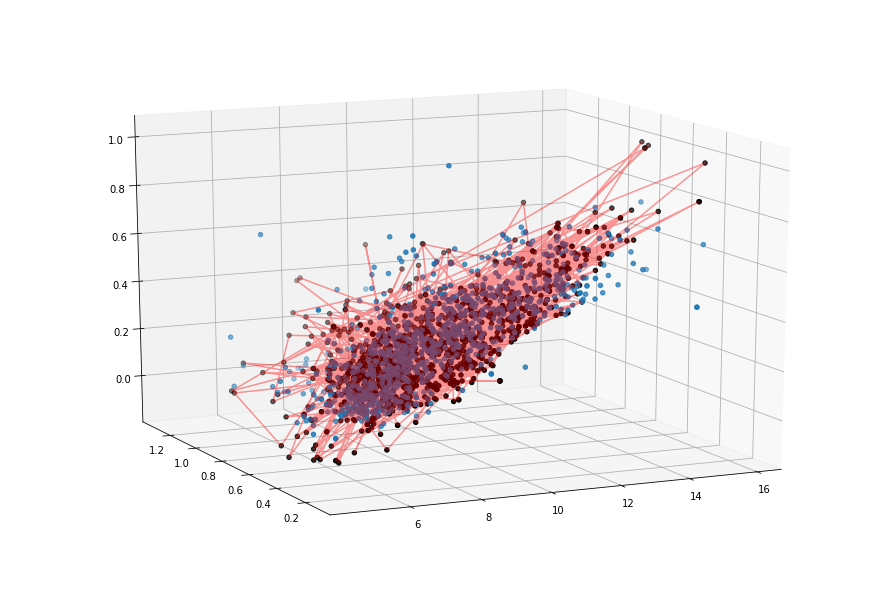

STEP: 500, MSE: 0.0270, R2: 0.3163
Weights: [[0.0992061 0.1523968]], Bias: [-0.65165067]


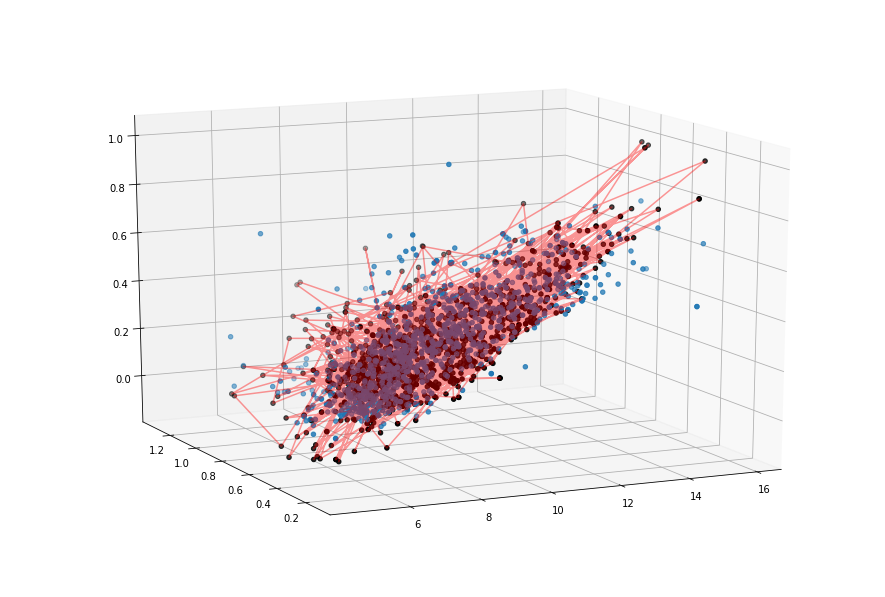

STEP: 600, MSE: 0.0262, R2: 0.3354
Weights: [[0.09891205 0.12917039]], Bias: [-0.63710195]


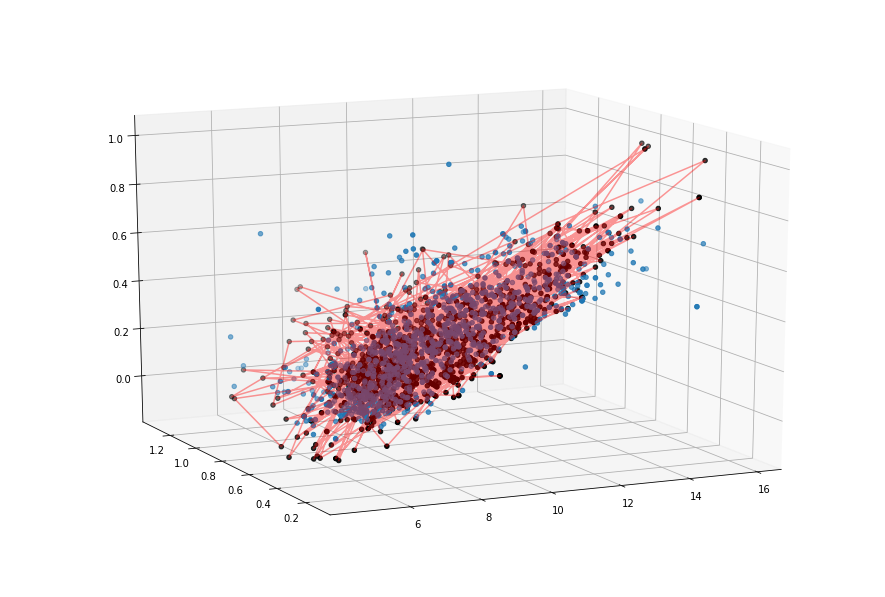

STEP: 700, MSE: 0.0256, R2: 0.3528
Weights: [[0.09851411 0.10741831]], Bias: [-0.62236845]


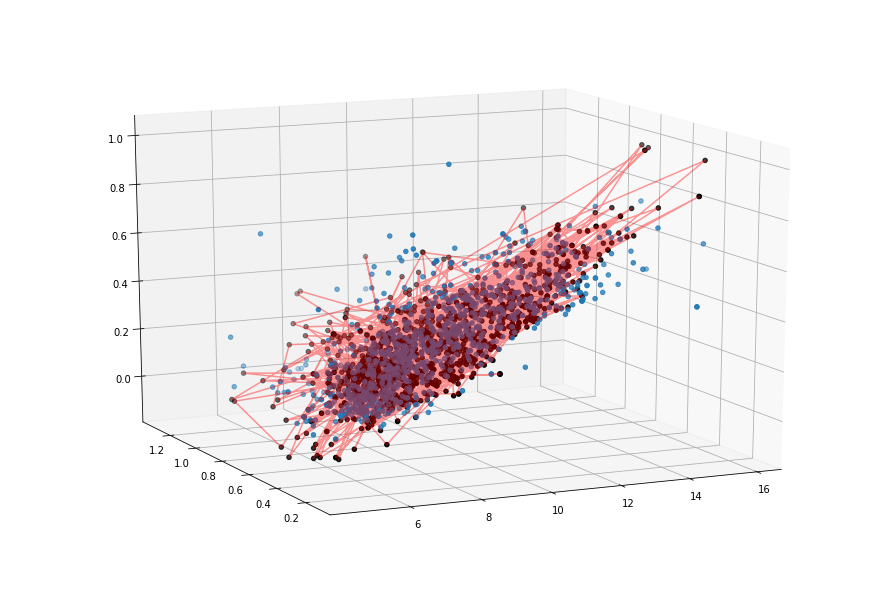

STEP: 800, MSE: 0.0249, R2: 0.3690
Weights: [[0.09803169 0.08698477]], Bias: [-0.6075459]


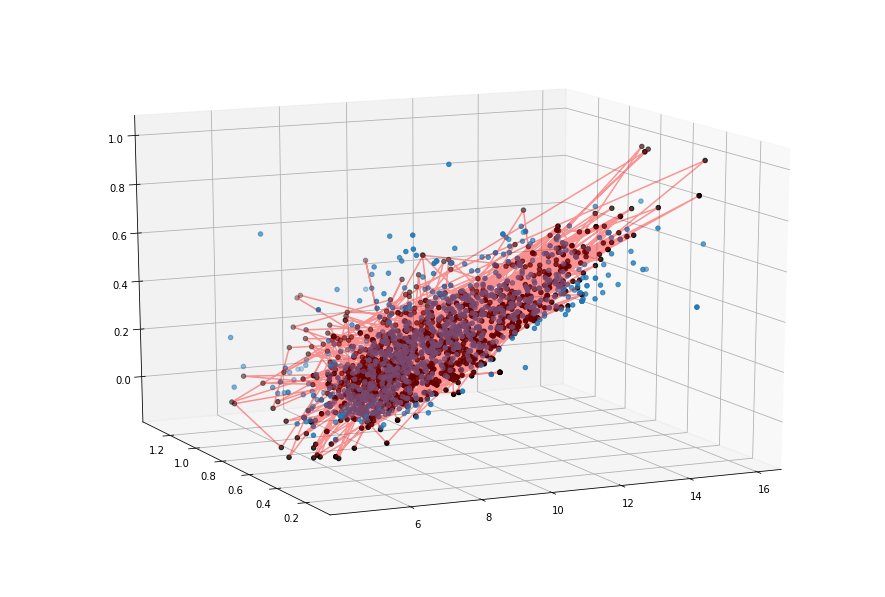

STEP: 900, MSE: 0.0243, R2: 0.3839
Weights: [[0.09748121 0.06773478]], Bias: [-0.59271383]


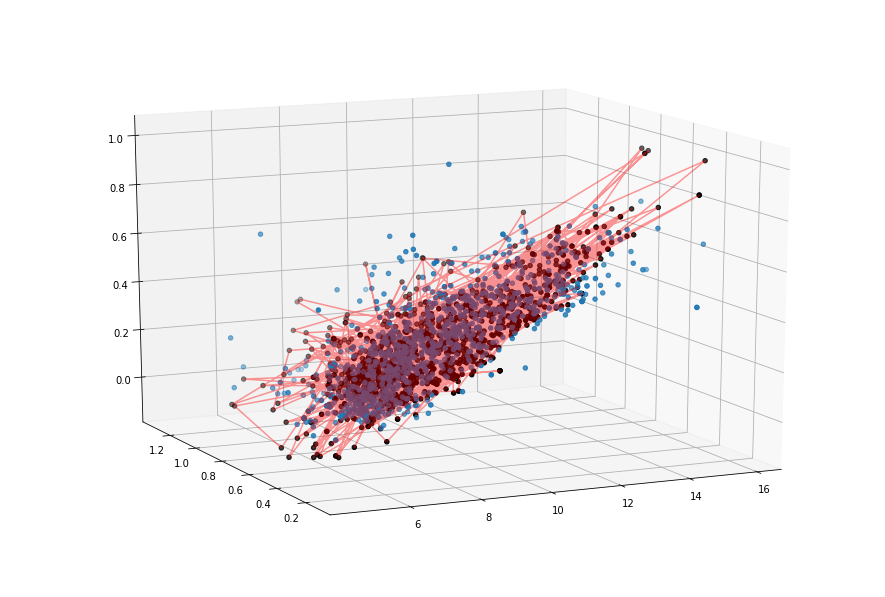

STEP: 1000, MSE: 0.0238, R2: 0.3979
Weights: [[0.09687673 0.04955111]], Bias: [-0.5779394]


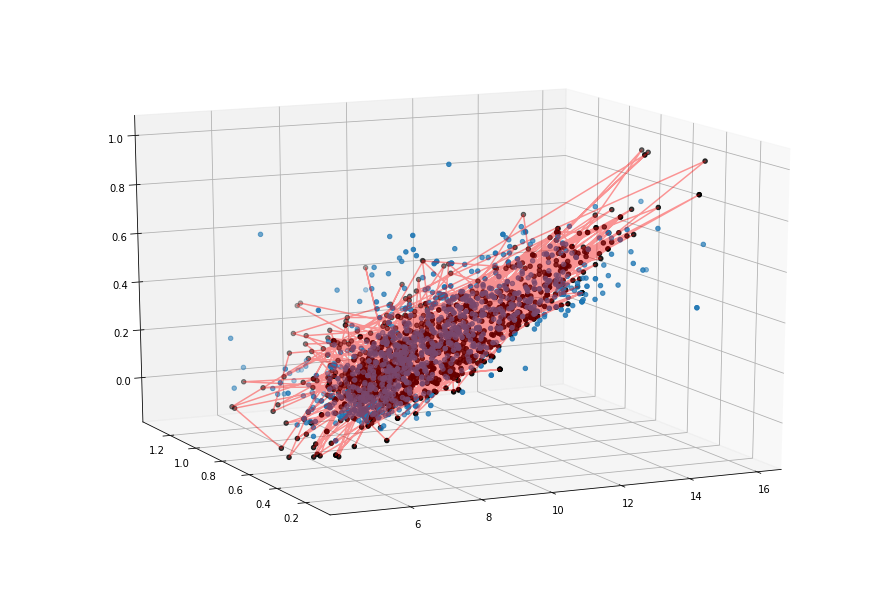

STEP: 1100, MSE: 0.0233, R2: 0.4108
Weights: [[0.09623004 0.03233181]], Bias: [-0.5632768]


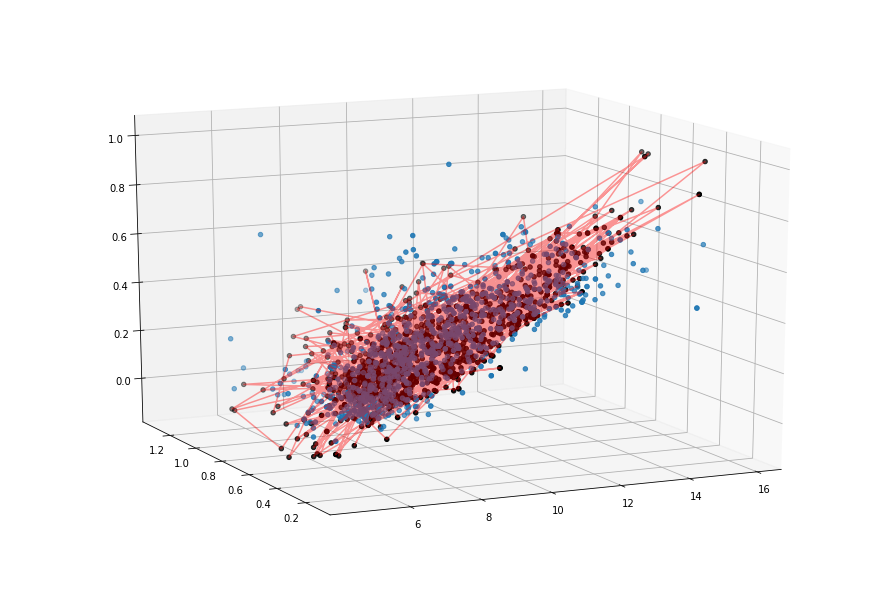

STEP: 1200, MSE: 0.0228, R2: 0.4229
Weights: [[0.09555114 0.01598804]], Bias: [-0.5487712]


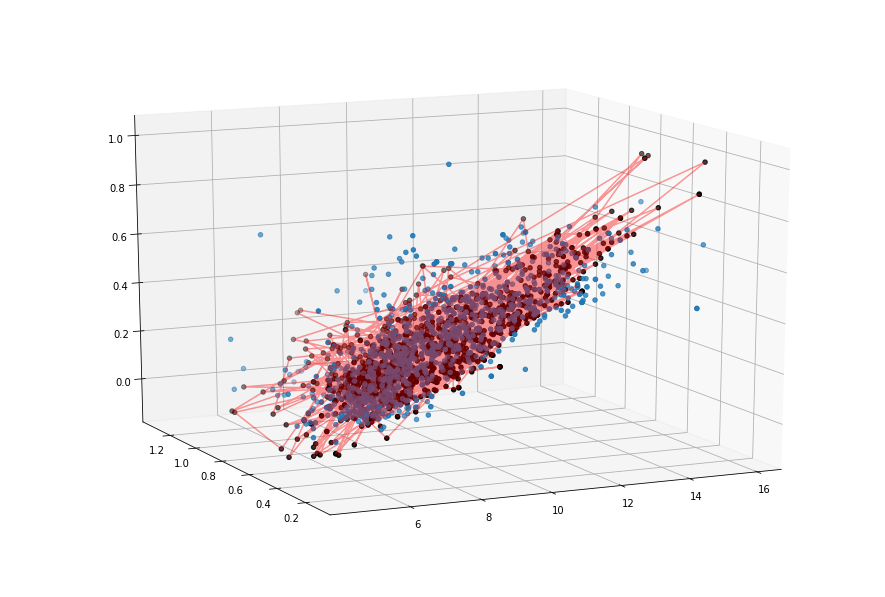

STEP: 1300, MSE: 0.0223, R2: 0.4342
Weights: [[0.09484845 0.00044229]], Bias: [-0.534459]


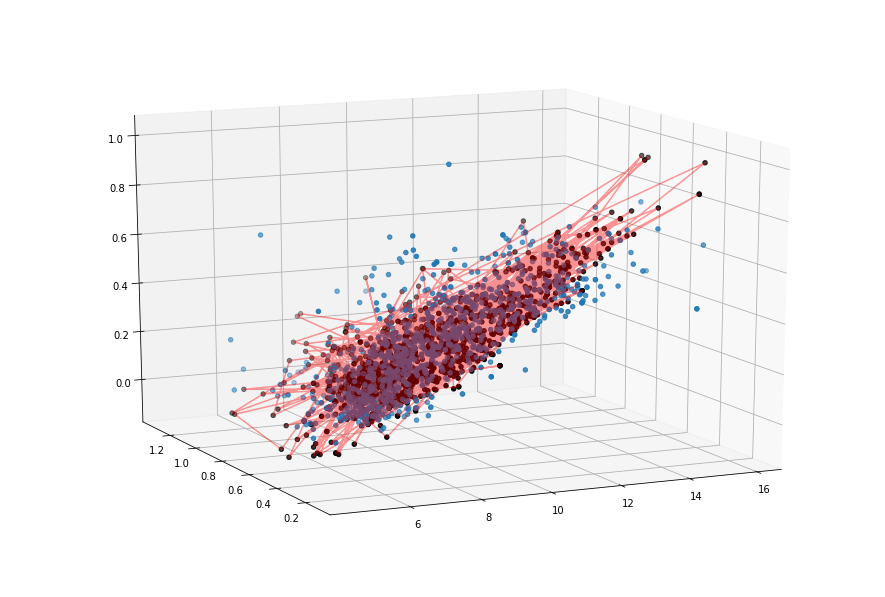

STEP: 1400, MSE: 0.0219, R2: 0.4448
Weights: [[ 0.09412914 -0.01437328]], Bias: [-0.5203701]


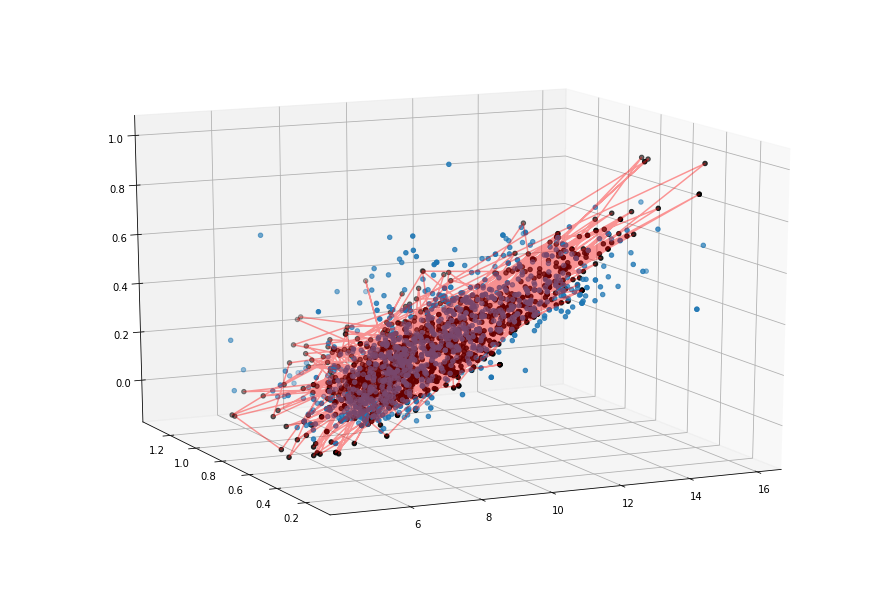

STEP: 1500, MSE: 0.0215, R2: 0.4548
Weights: [[ 0.09339912 -0.02851816]], Bias: [-0.5065279]


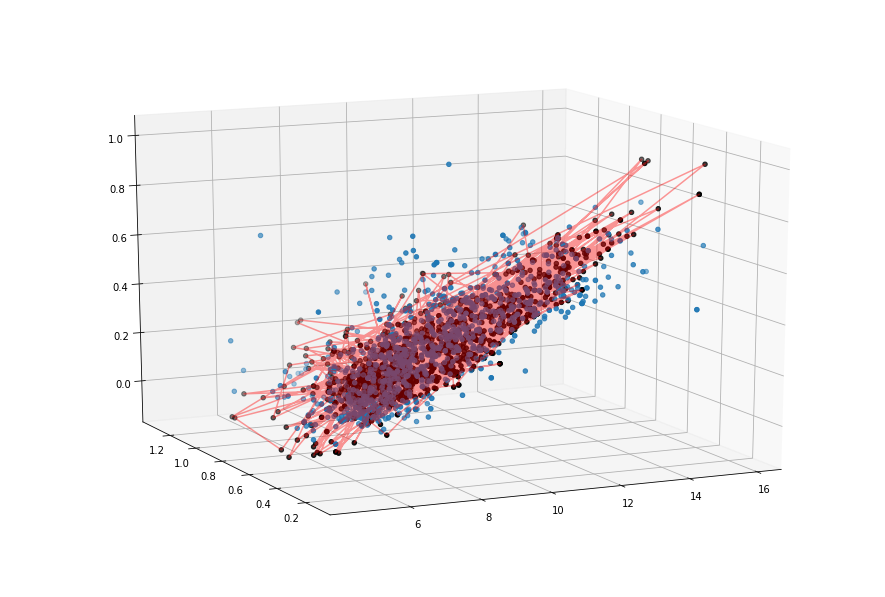

STEP: 1600, MSE: 0.0212, R2: 0.4641
Weights: [[ 0.09266342 -0.04204465]], Bias: [-0.49295086]


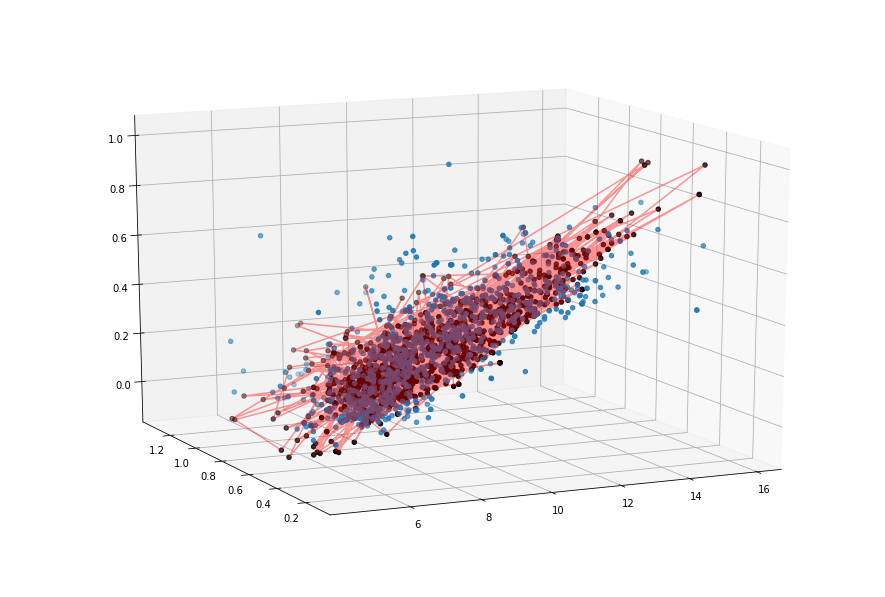

STEP: 1700, MSE: 0.0208, R2: 0.4728
Weights: [[ 0.09192623 -0.05499887]], Bias: [-0.47965324]


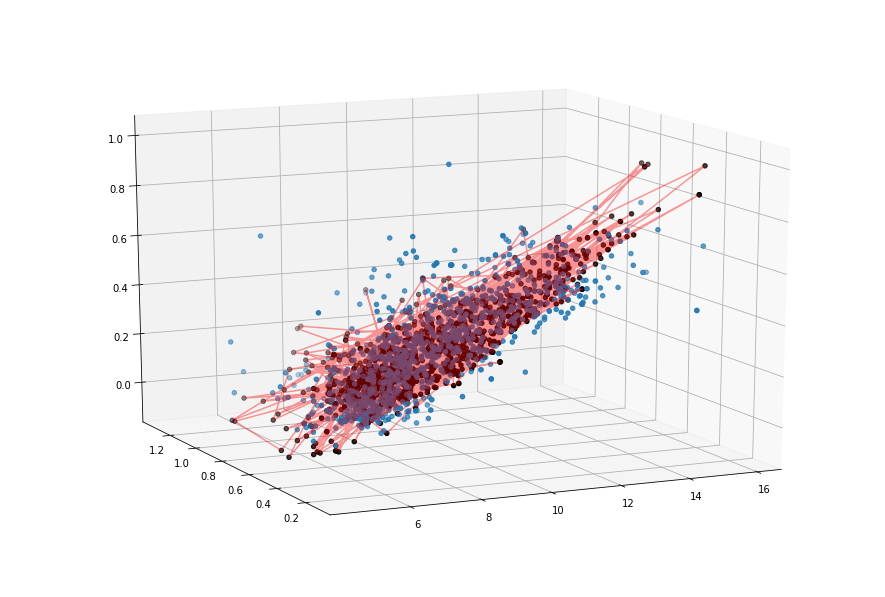

STEP: 1800, MSE: 0.0205, R2: 0.4810
Weights: [[ 0.091191   -0.06742155]], Bias: [-0.46664545]


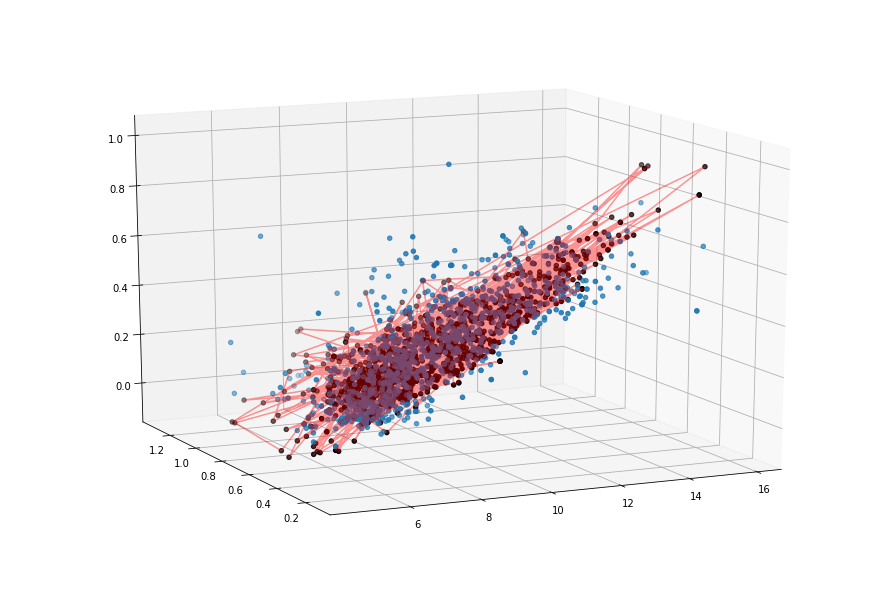

STEP: 1900, MSE: 0.0202, R2: 0.4887
Weights: [[ 0.09046062 -0.07934885]], Bias: [-0.45393512]


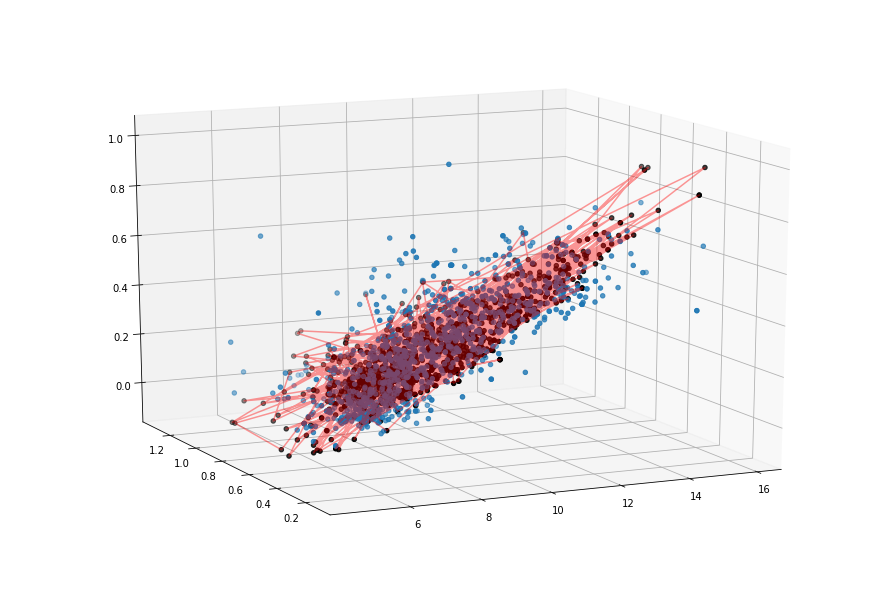

STEP: 2000, MSE: 0.0199, R2: 0.4960
Weights: [[ 0.08973745 -0.09081294]], Bias: [-0.44152713]


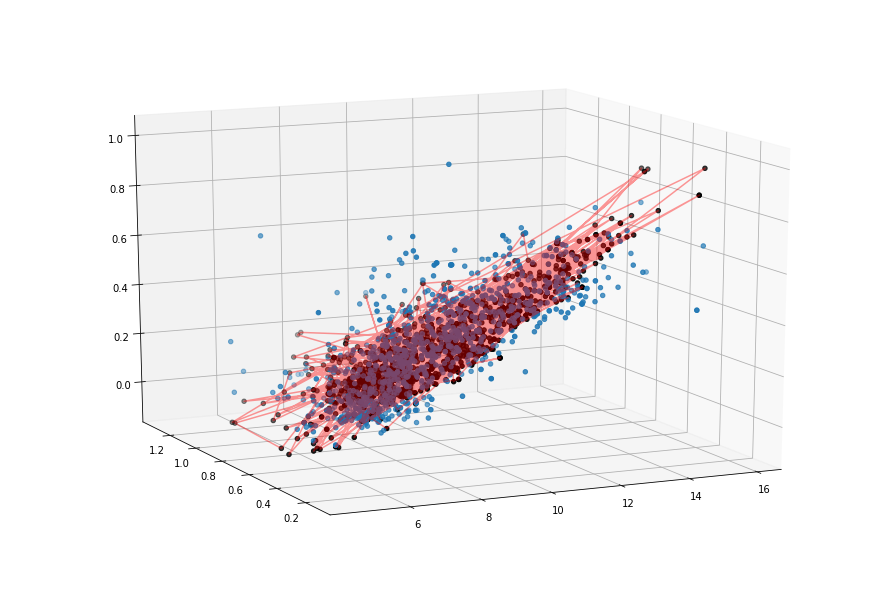

STEP: 2100, MSE: 0.0196, R2: 0.5028
Weights: [[ 0.08902343 -0.10184258]], Bias: [-0.42942432]


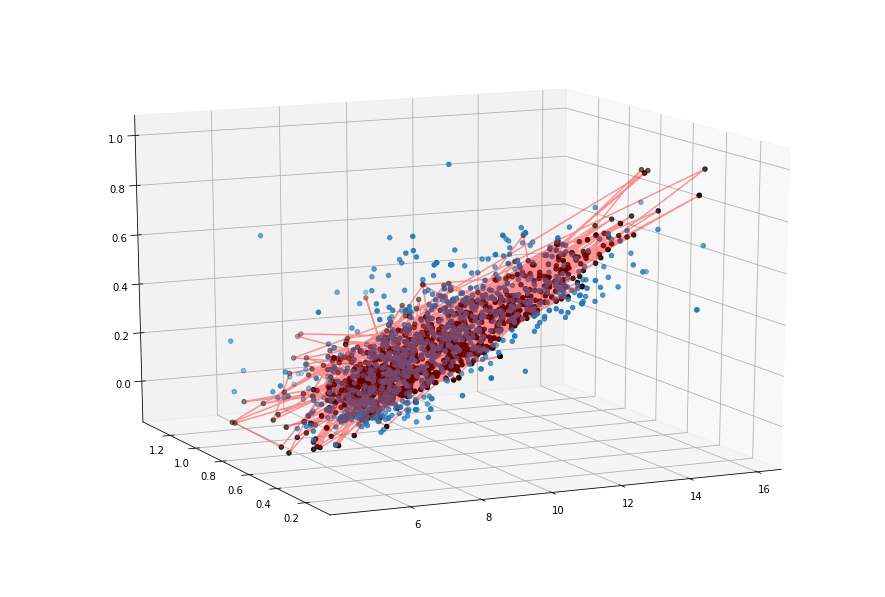

STEP: 2200, MSE: 0.0194, R2: 0.5092
Weights: [[ 0.08832012 -0.11246344]], Bias: [-0.41762745]


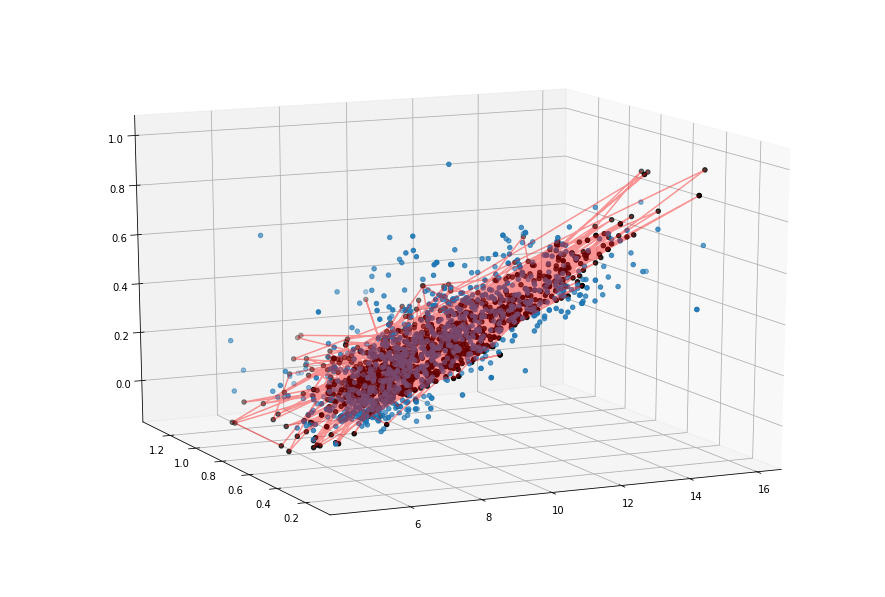

STEP: 2300, MSE: 0.0191, R2: 0.5152
Weights: [[ 0.08762879 -0.12269874]], Bias: [-0.40613642]


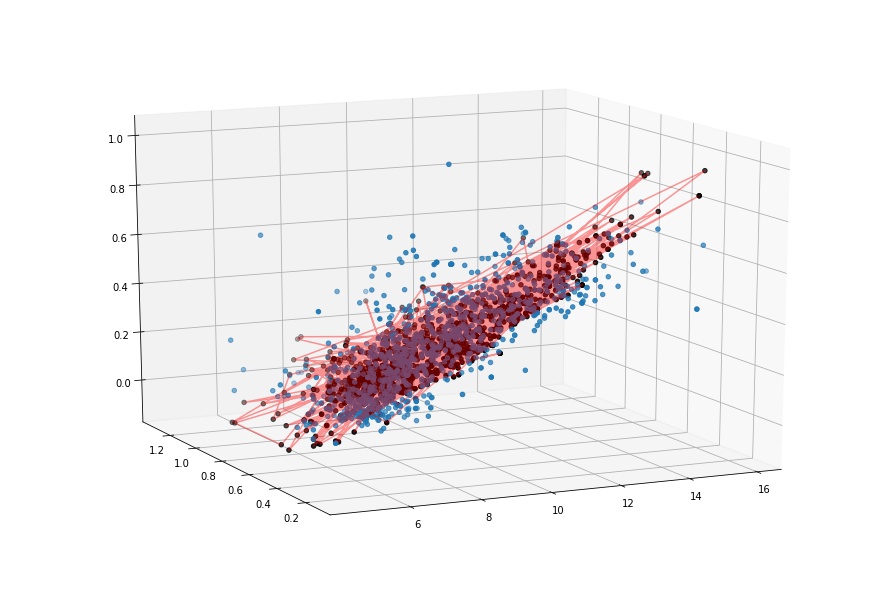

STEP: 2400, MSE: 0.0189, R2: 0.5208
Weights: [[ 0.08695038 -0.13256925]], Bias: [-0.39494893]


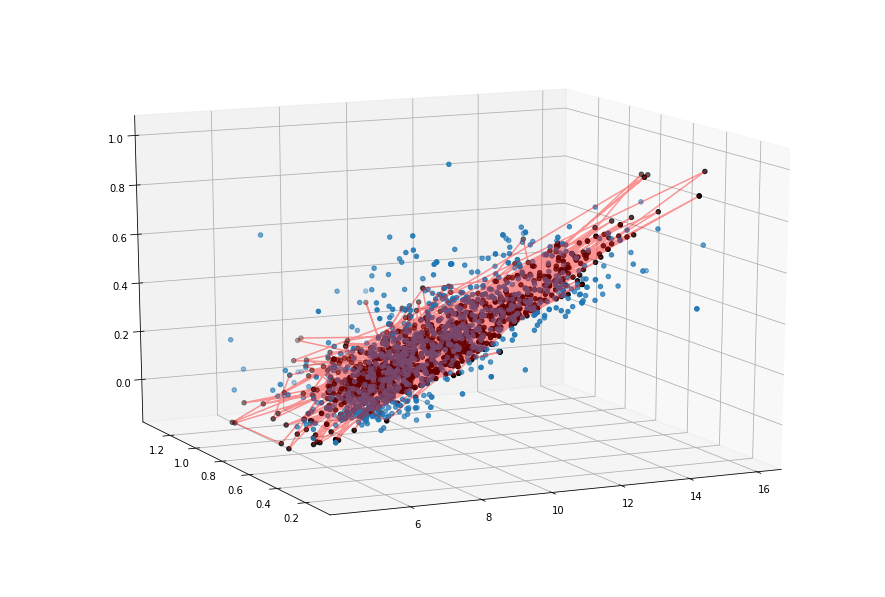

STEP: 2500, MSE: 0.0187, R2: 0.5261
Weights: [[ 0.08628573 -0.142094  ]], Bias: [-0.3840629]


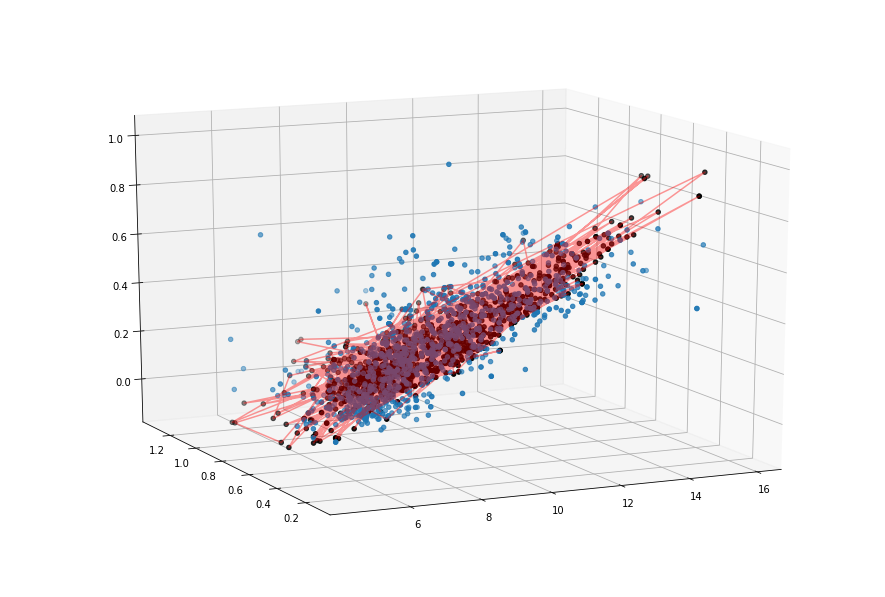

STEP: 2600, MSE: 0.0185, R2: 0.5311
Weights: [[ 0.08563531 -0.1512901 ]], Bias: [-0.37347364]


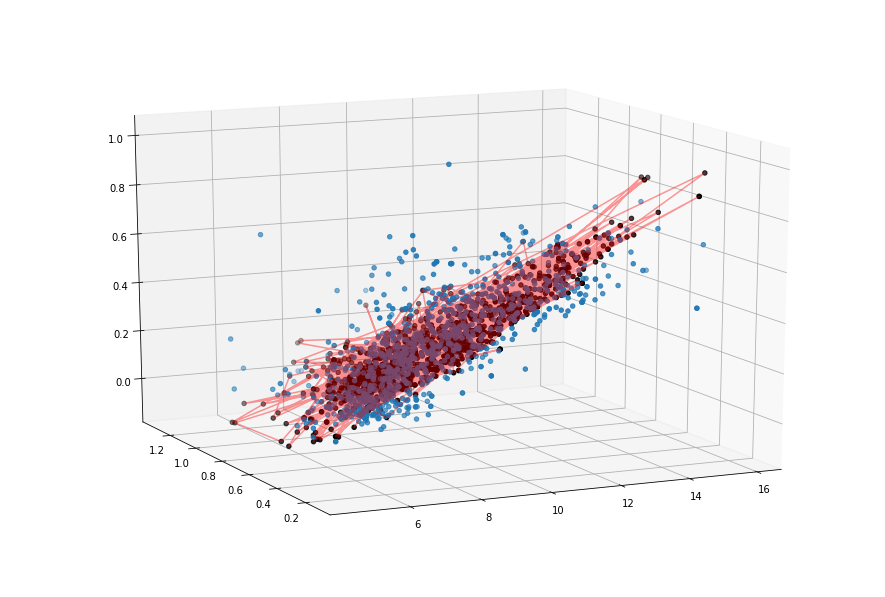

STEP: 2700, MSE: 0.0183, R2: 0.5358
Weights: [[ 0.08499956 -0.16017337]], Bias: [-0.36317733]


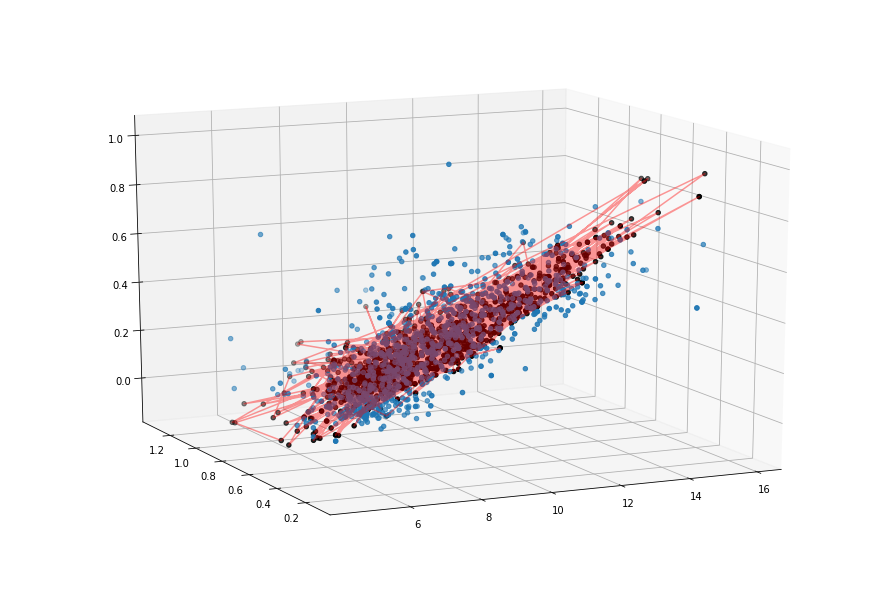

STEP: 2800, MSE: 0.0182, R2: 0.5402
Weights: [[ 0.08437878 -0.16875823]], Bias: [-0.3531691]


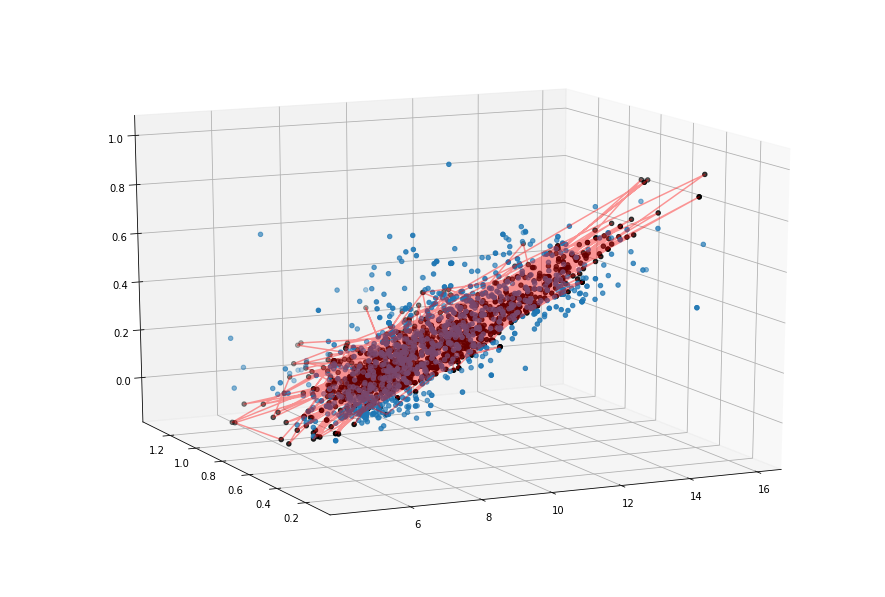

STEP: 2900, MSE: 0.0180, R2: 0.5444
Weights: [[ 0.08377313 -0.1770579 ]], Bias: [-0.3434437]


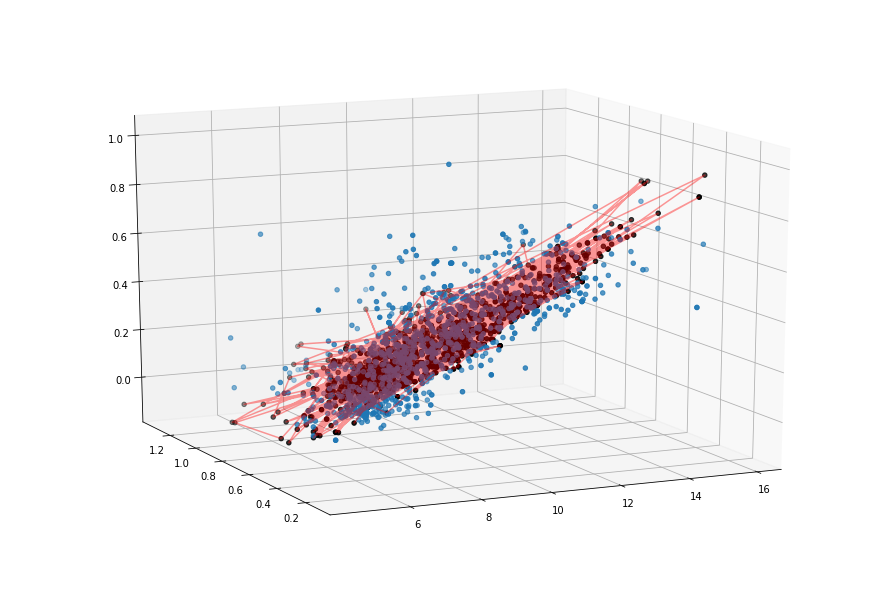

STEP: 3000, MSE: 0.0178, R2: 0.5483
Weights: [[ 0.08318269 -0.18508466]], Bias: [-0.3339955]


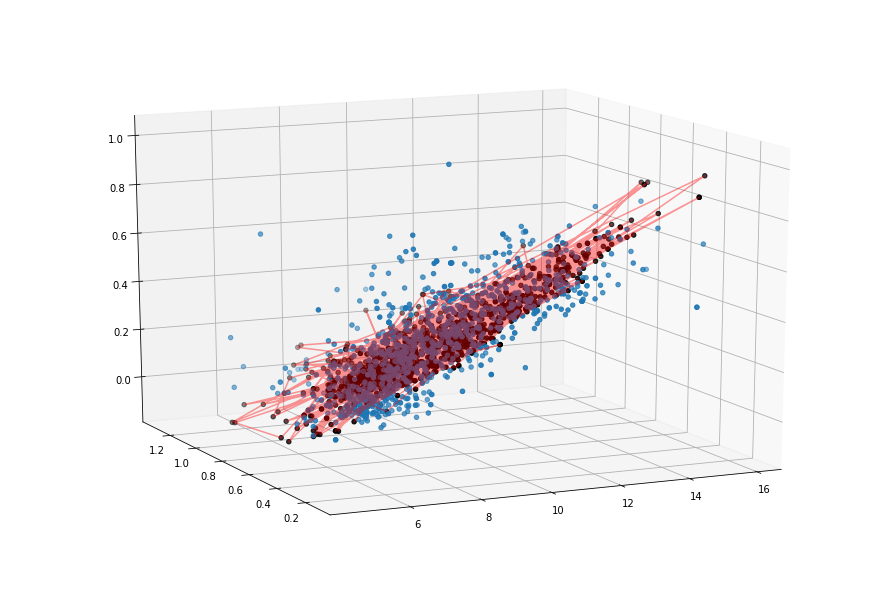

STEP: 3100, MSE: 0.0177, R2: 0.5519
Weights: [[ 0.08260744 -0.19284986]], Bias: [-0.32481858]


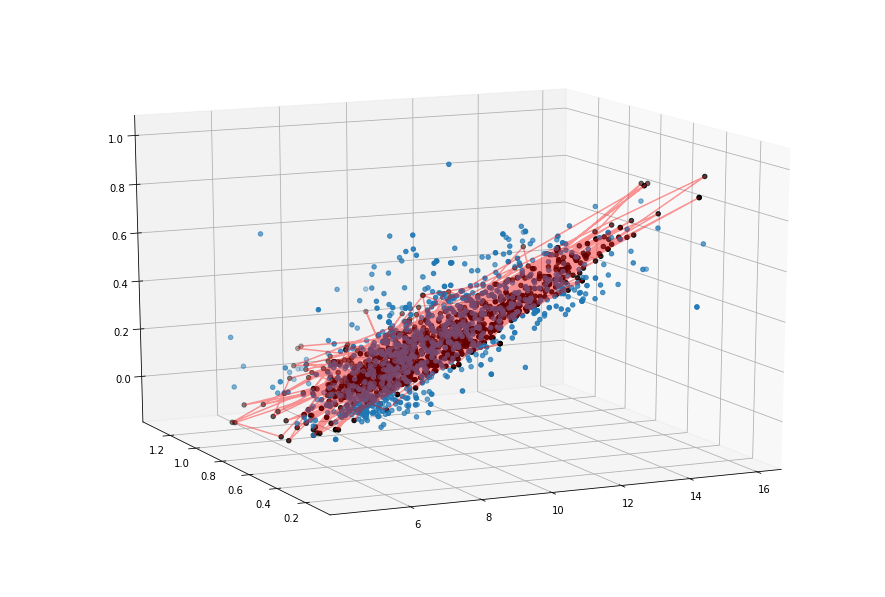

STEP: 3200, MSE: 0.0176, R2: 0.5554
Weights: [[ 0.08204732 -0.2003641 ]], Bias: [-0.31590694]


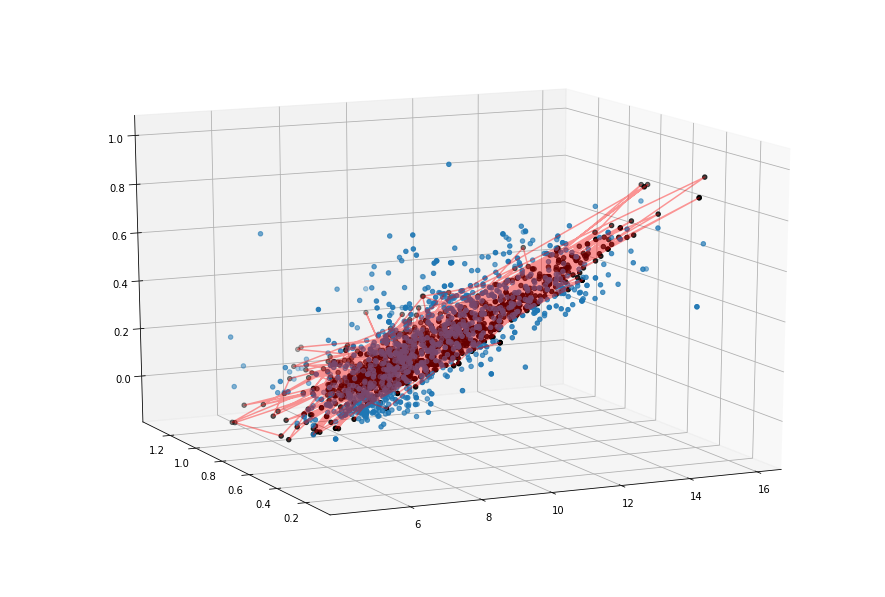

STEP: 3300, MSE: 0.0174, R2: 0.5586
Weights: [[ 0.08150219 -0.2076372 ]], Bias: [-0.30725428]


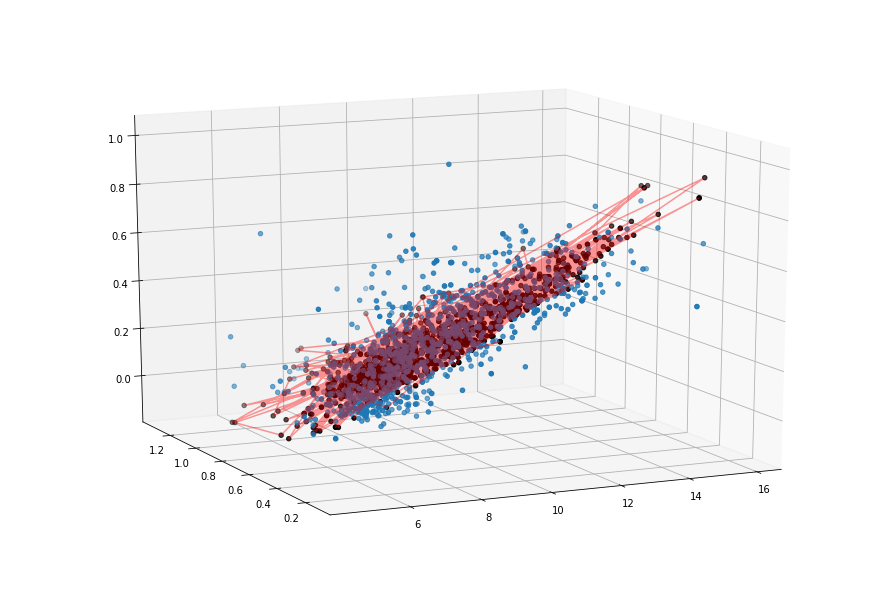

STEP: 3400, MSE: 0.0173, R2: 0.5617
Weights: [[ 0.0809719  -0.21467845]], Bias: [-0.2988545]


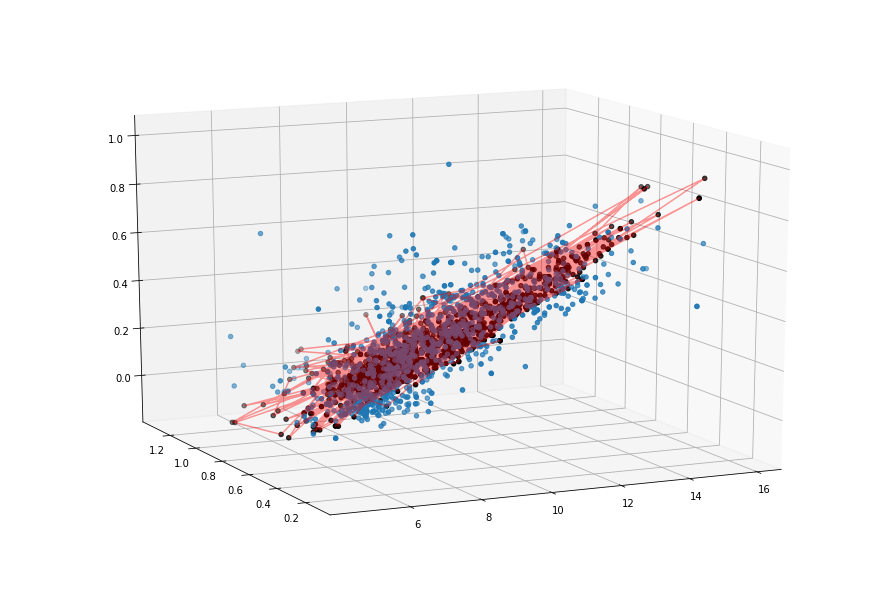

STEP: 3500, MSE: 0.0172, R2: 0.5645
Weights: [[ 0.08045622 -0.22149654]], Bias: [-0.29070112]


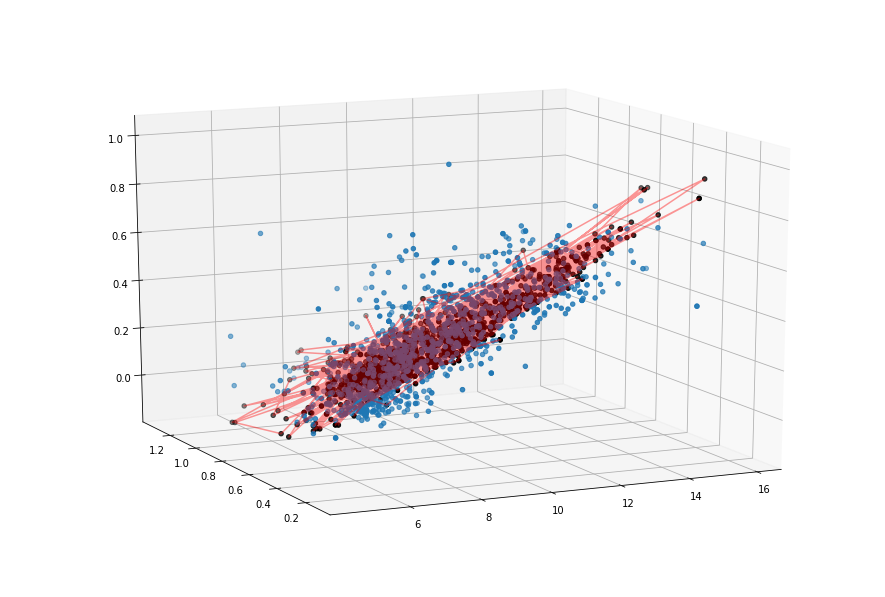

STEP: 3600, MSE: 0.0171, R2: 0.5672
Weights: [[ 0.07995491 -0.22809964]], Bias: [-0.28278777]


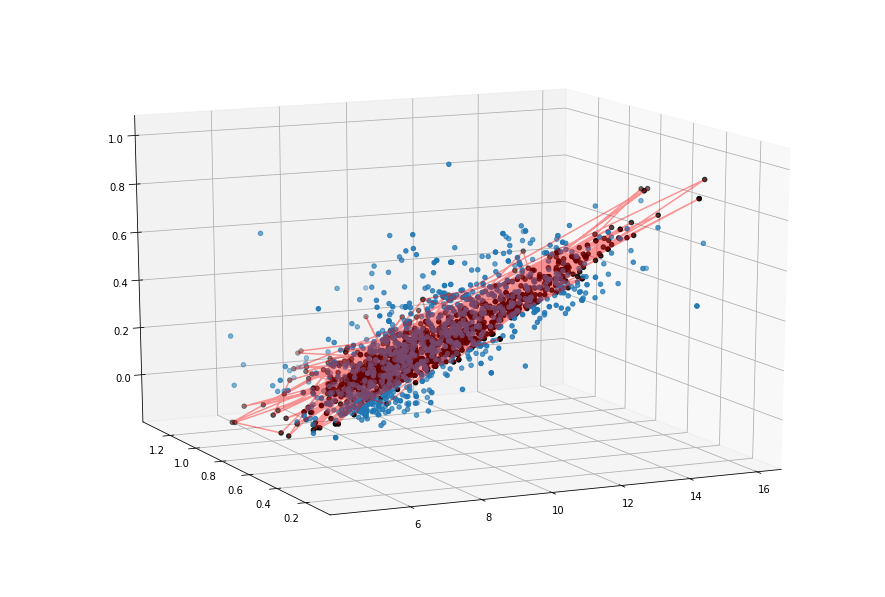

STEP: 3700, MSE: 0.0170, R2: 0.5698
Weights: [[ 0.07946776 -0.23449546]], Bias: [-0.2751084]


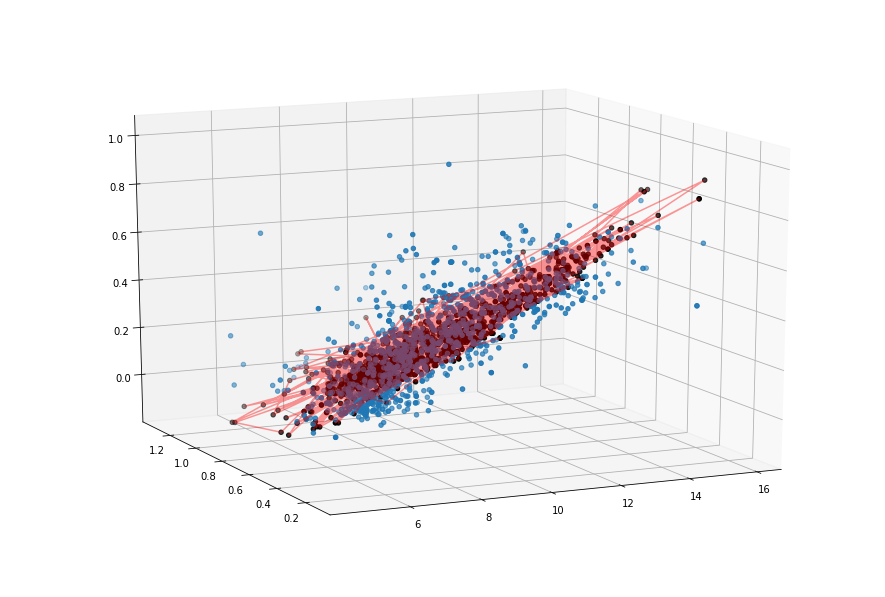

STEP: 3800, MSE: 0.0169, R2: 0.5722
Weights: [[ 0.07899445 -0.2406914 ]], Bias: [-0.2676567]


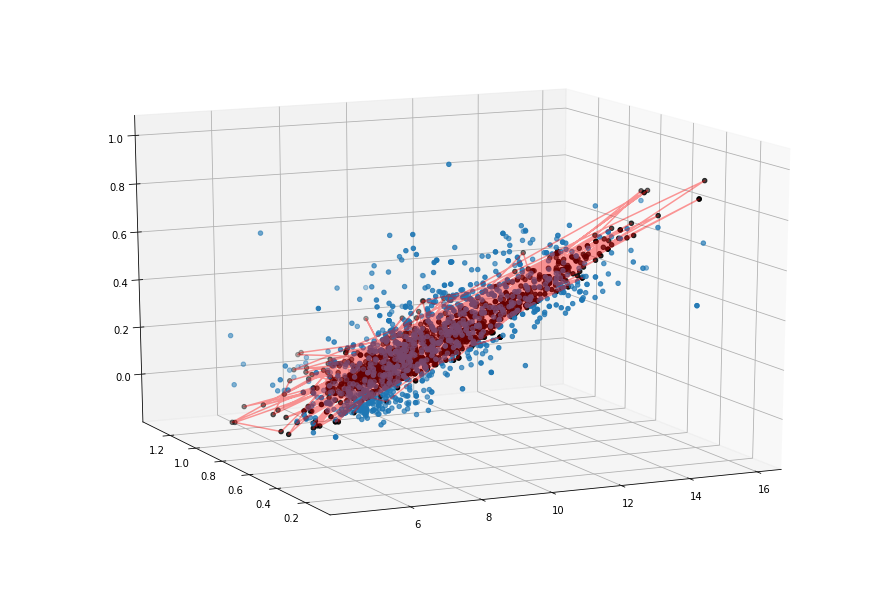

STEP: 3900, MSE: 0.0168, R2: 0.5744
Weights: [[ 0.07853471 -0.2466943 ]], Bias: [-0.26042643]


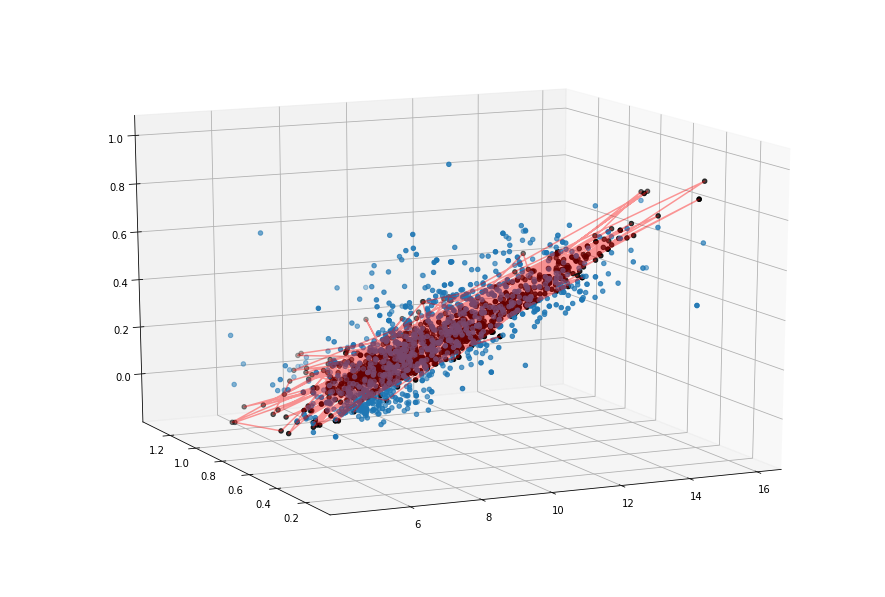

STEP: 4000, MSE: 0.0167, R2: 0.5765
Weights: [[ 0.07808822 -0.2525108 ]], Bias: [-0.25341144]


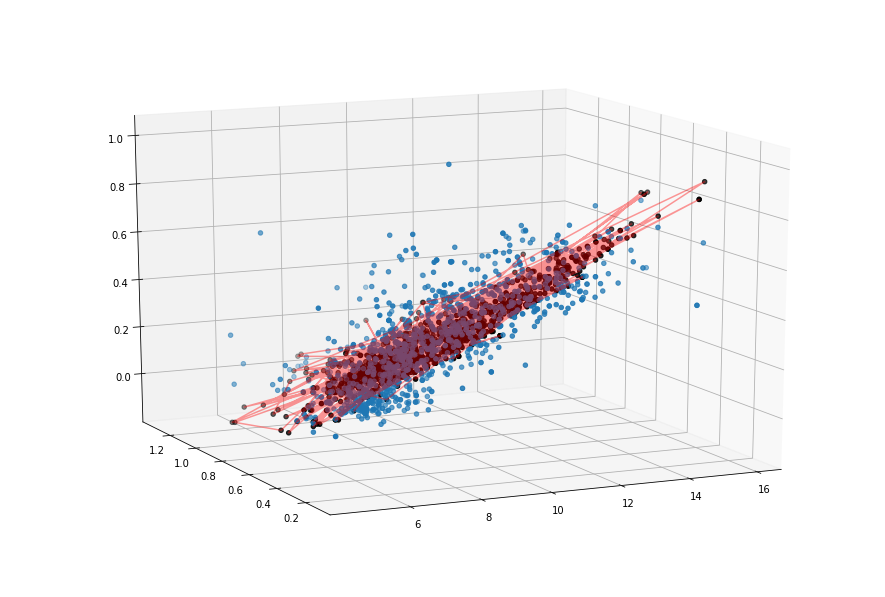

STEP: 4100, MSE: 0.0166, R2: 0.5785
Weights: [[ 0.0776547 -0.2581472]], Bias: [-0.24660583]


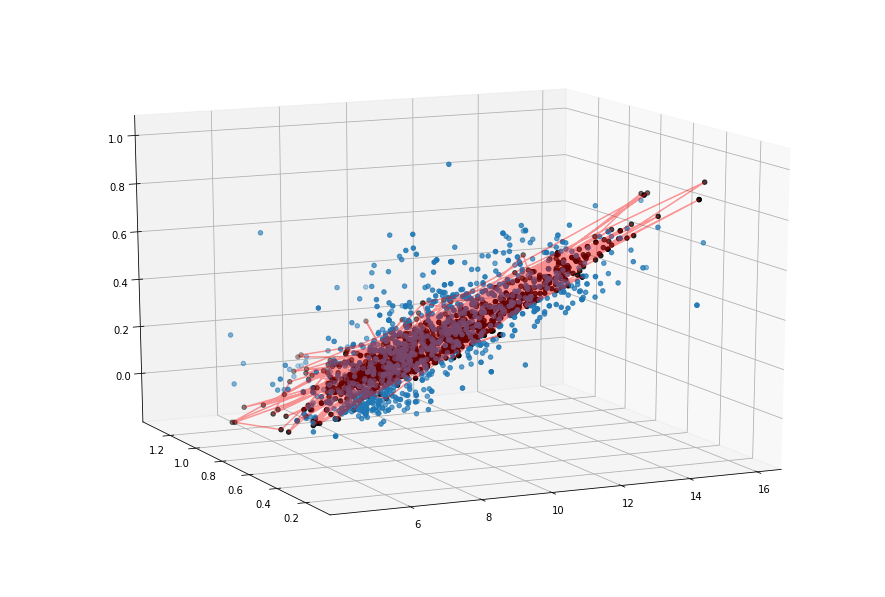

STEP: 4200, MSE: 0.0166, R2: 0.5804
Weights: [[ 0.07723381 -0.2636096 ]], Bias: [-0.24000369]


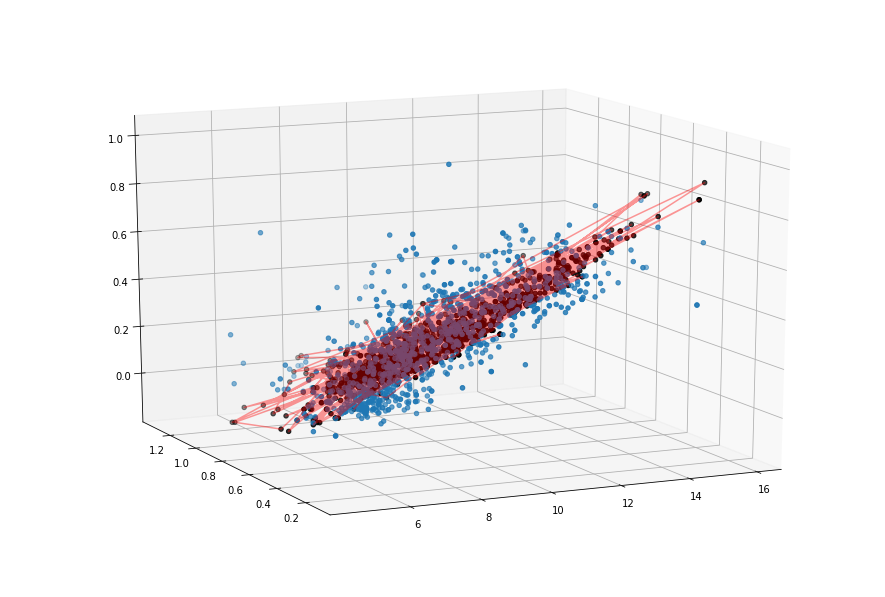

STEP: 4300, MSE: 0.0165, R2: 0.5821
Weights: [[ 0.07682528 -0.26890364]], Bias: [-0.23359928]


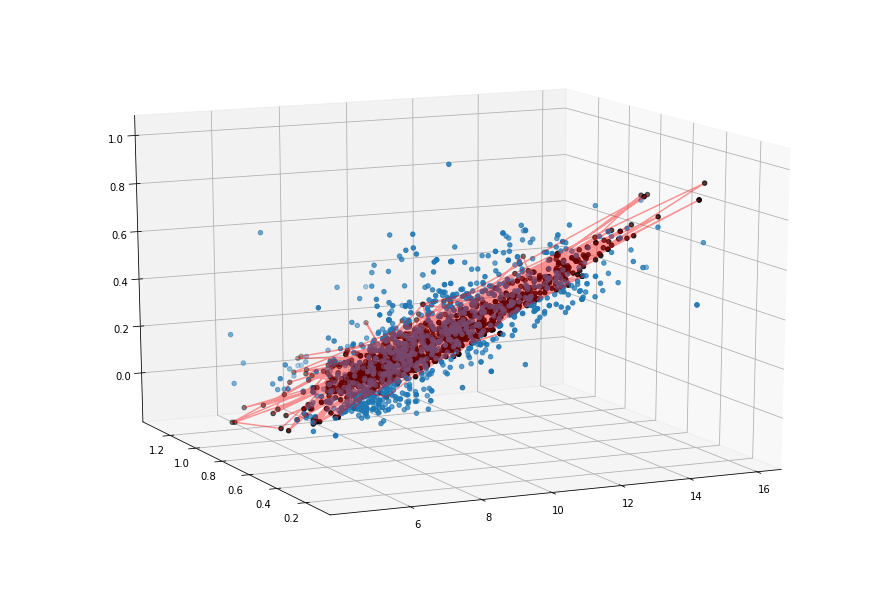

STEP: 4400, MSE: 0.0164, R2: 0.5838
Weights: [[ 0.07642876 -0.27403486]], Bias: [-0.22738692]


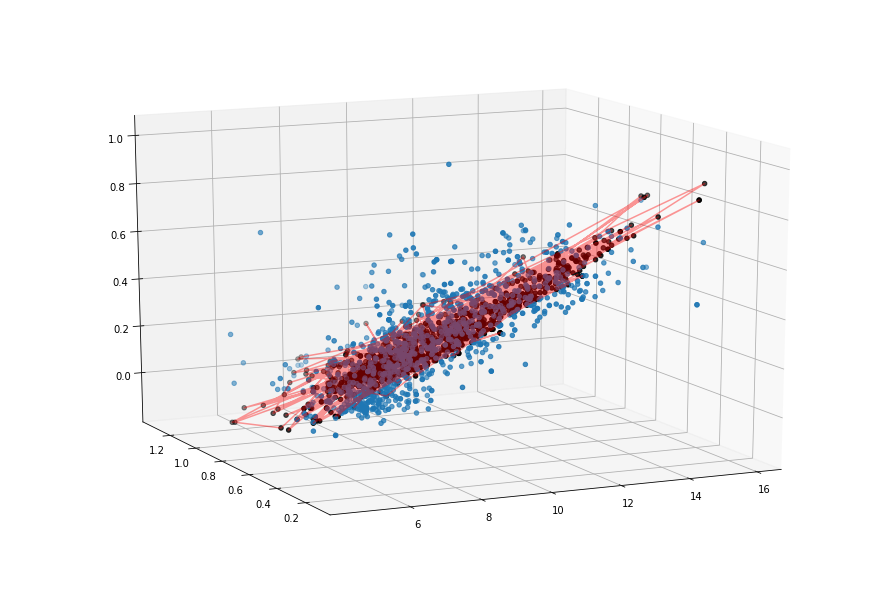

STEP: 4500, MSE: 0.0164, R2: 0.5853
Weights: [[ 0.07604395 -0.27900854]], Bias: [-0.22136112]


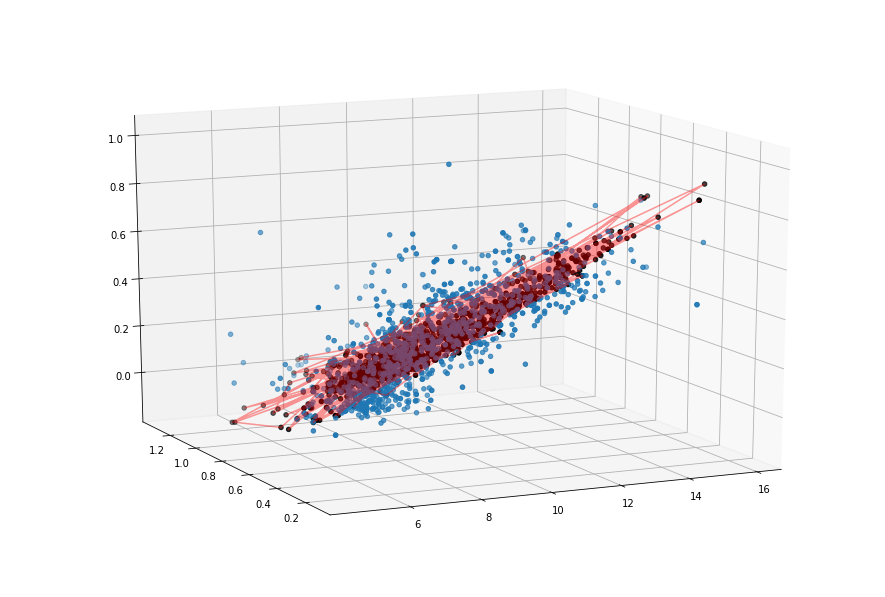

STEP: 4600, MSE: 0.0163, R2: 0.5868
Weights: [[ 0.07567051 -0.28382957]], Bias: [-0.21551634]


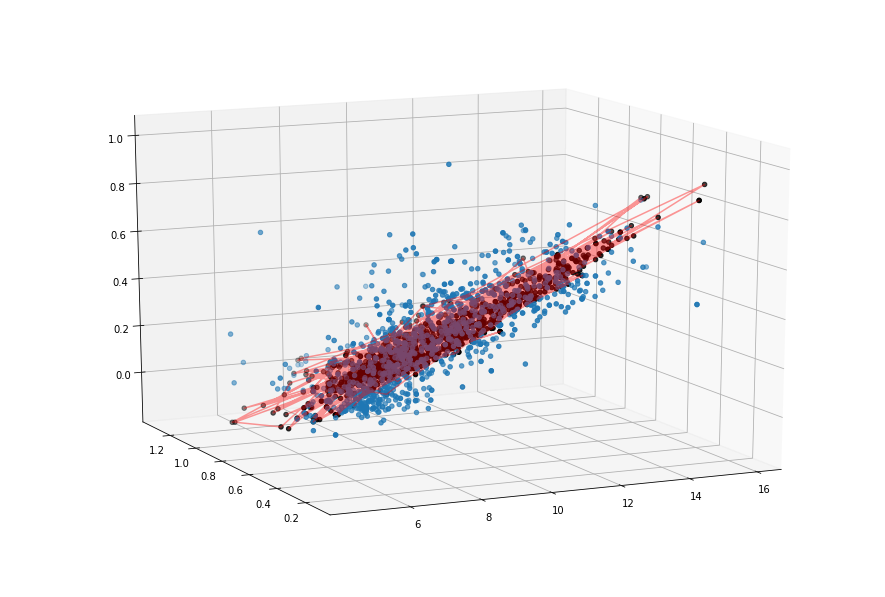

STEP: 4700, MSE: 0.0163, R2: 0.5881
Weights: [[ 0.0753082  -0.28850338]], Bias: [-0.20984742]


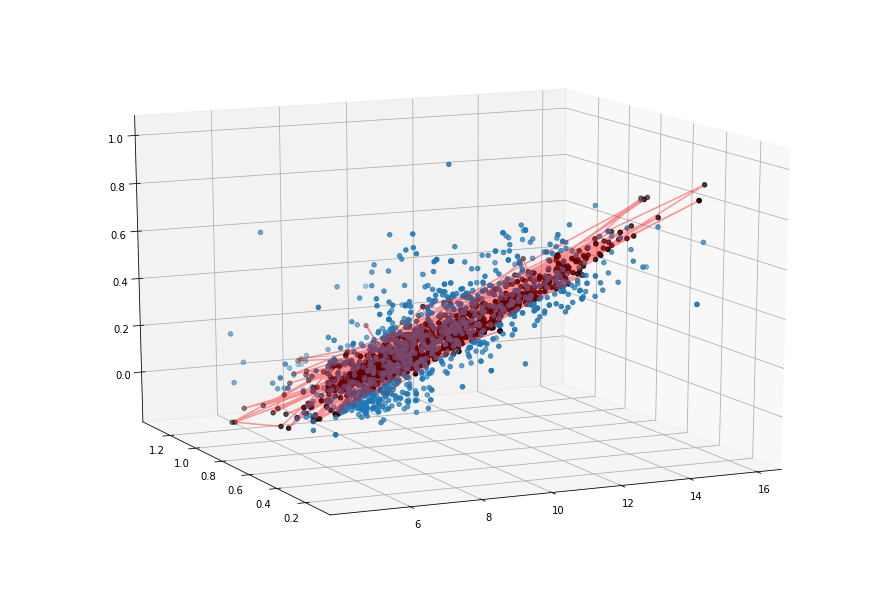

STEP: 4800, MSE: 0.0162, R2: 0.5894
Weights: [[ 0.07495666 -0.2930342 ]], Bias: [-0.20434915]


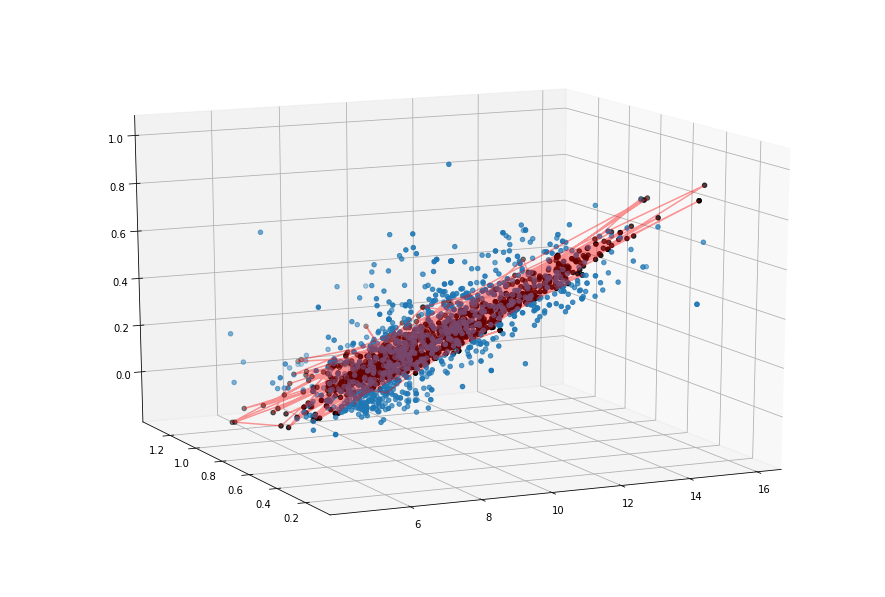

STEP: 4900, MSE: 0.0162, R2: 0.5906
Weights: [[ 0.07461561 -0.2974266 ]], Bias: [-0.19901656]


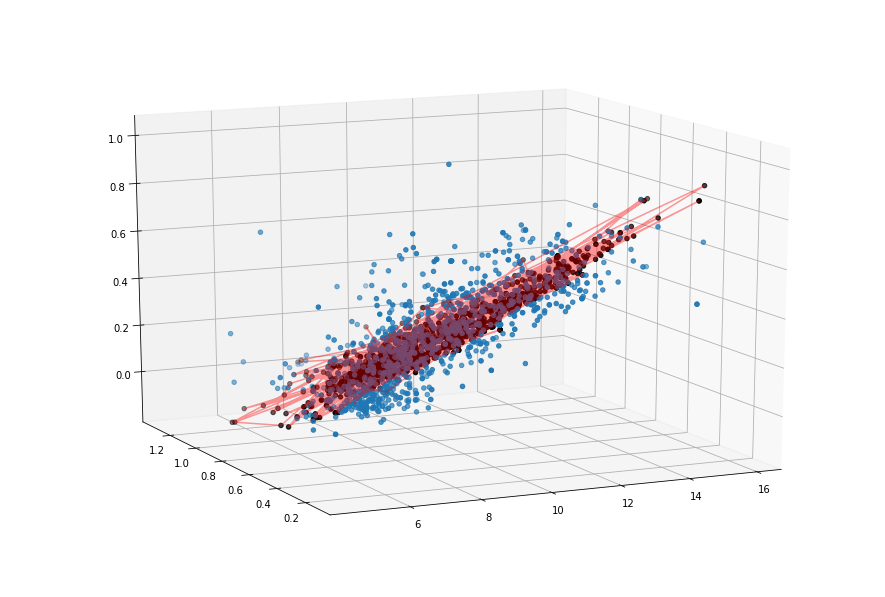

STEP: 5000, MSE: 0.0161, R2: 0.5918
Weights: [[ 0.07428474 -0.30168507]], Bias: [-0.19384477]


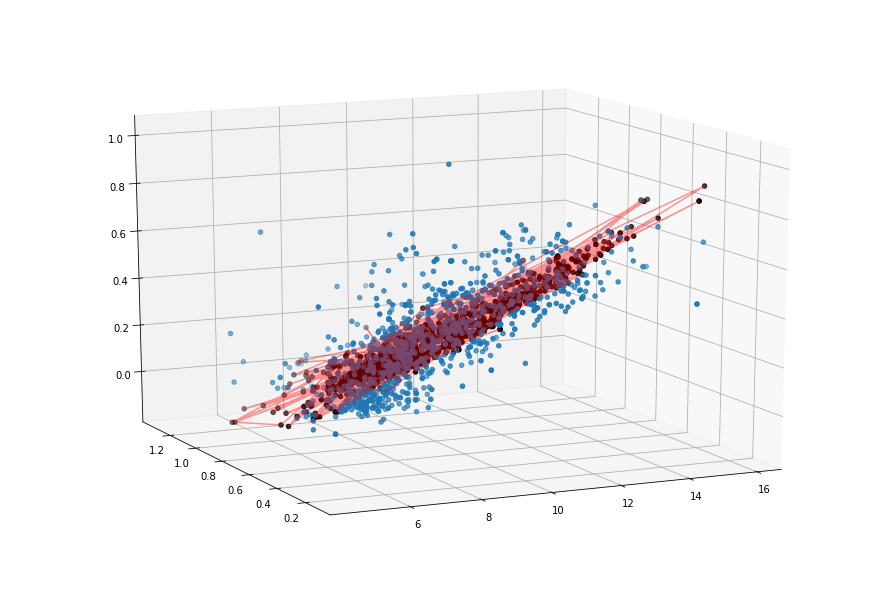

STEP: 5100, MSE: 0.0161, R2: 0.5928
Weights: [[ 0.07396379 -0.30581364]], Bias: [-0.18882899]


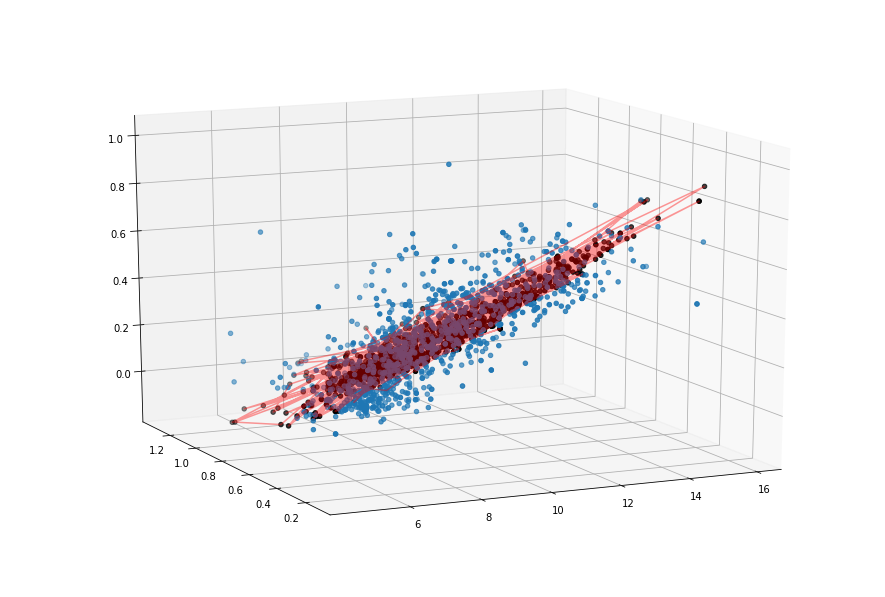

STEP: 5200, MSE: 0.0160, R2: 0.5938
Weights: [[ 0.07365245 -0.30981648]], Bias: [-0.1839645]


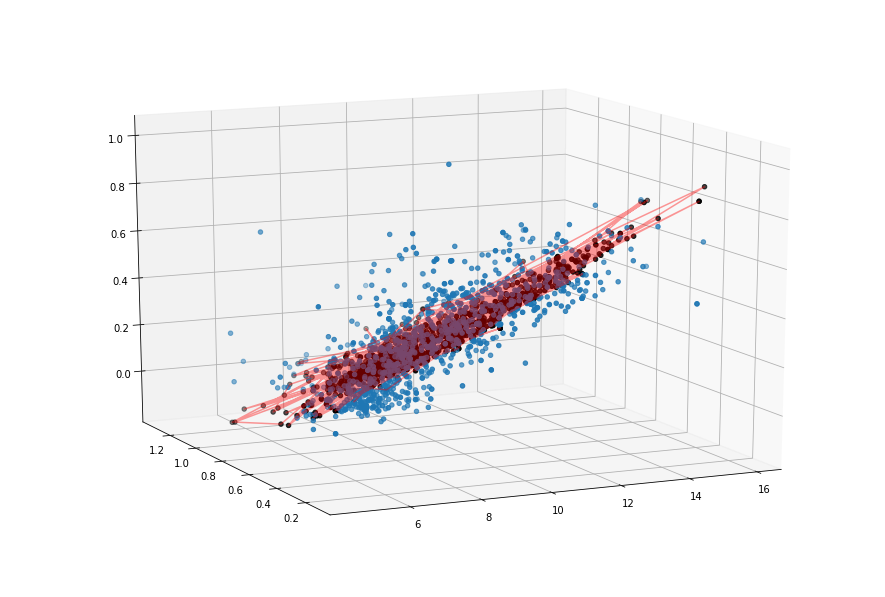

STEP: 5300, MSE: 0.0160, R2: 0.5948
Weights: [[ 0.07335046 -0.31369746]], Bias: [-0.17924698]


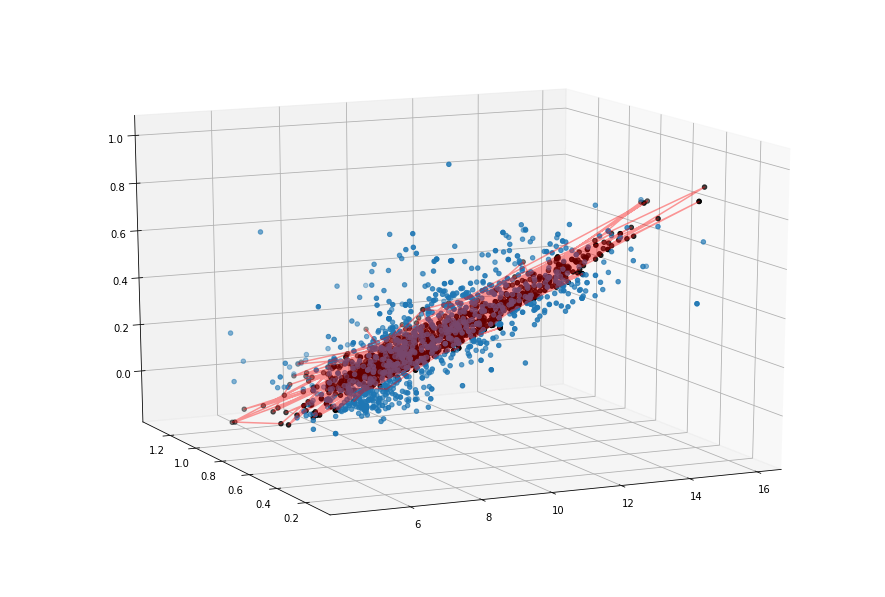

STEP: 5400, MSE: 0.0160, R2: 0.5957
Weights: [[ 0.07305753 -0.3174603 ]], Bias: [-0.17467192]


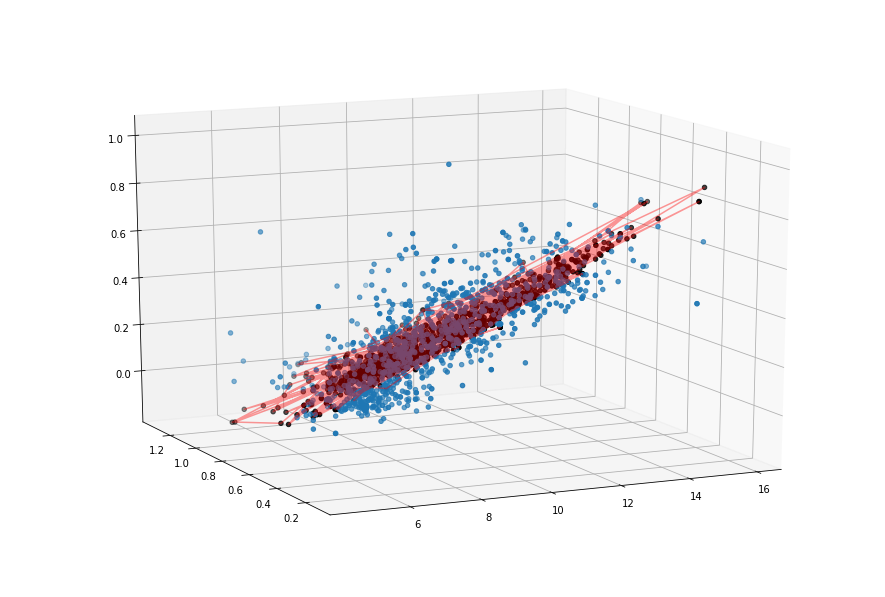

STEP: 5500, MSE: 0.0159, R2: 0.5965
Weights: [[ 0.07277342 -0.32110876]], Bias: [-0.17023511]


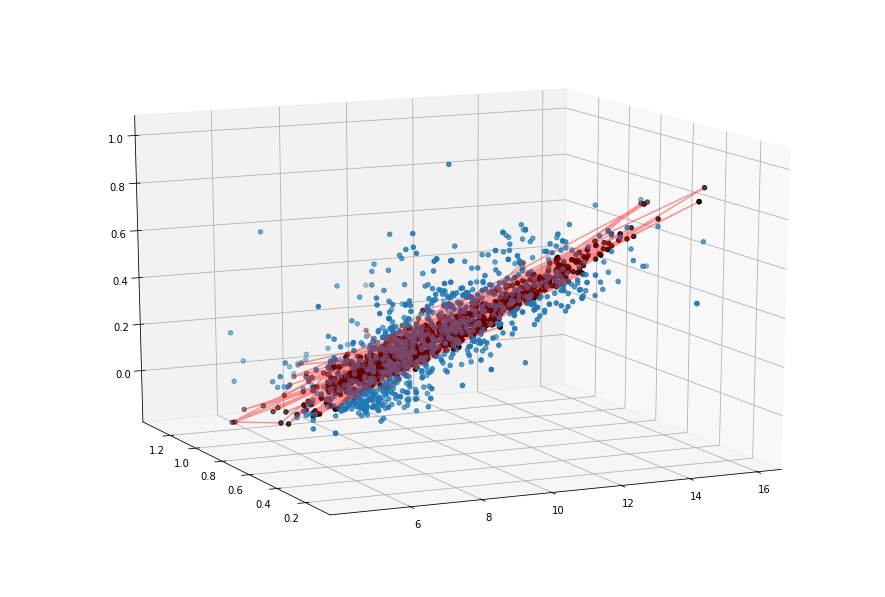

STEP: 5600, MSE: 0.0159, R2: 0.5973
Weights: [[ 0.07249787 -0.3246463 ]], Bias: [-0.16593237]


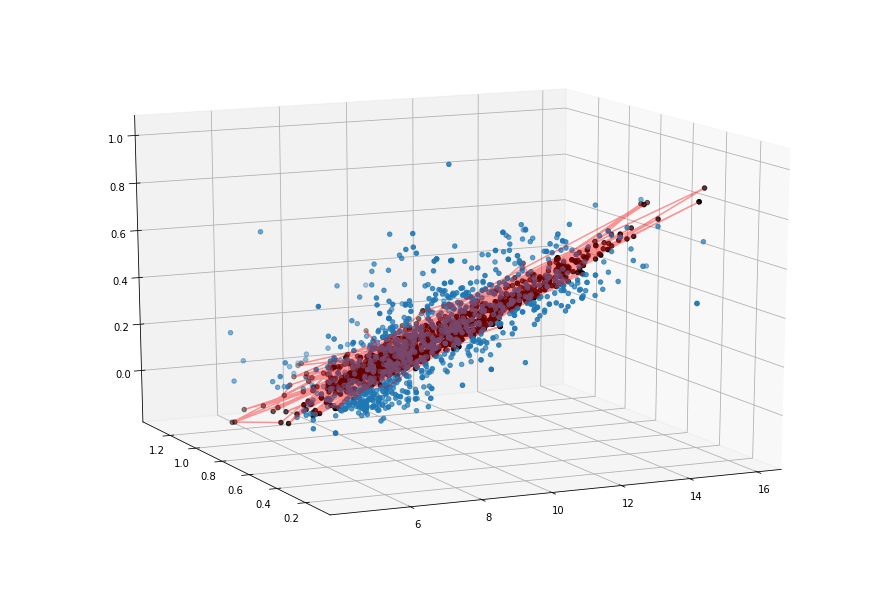

STEP: 5700, MSE: 0.0159, R2: 0.5981
Weights: [[ 0.0722306 -0.3280763]], Bias: [-0.16175973]


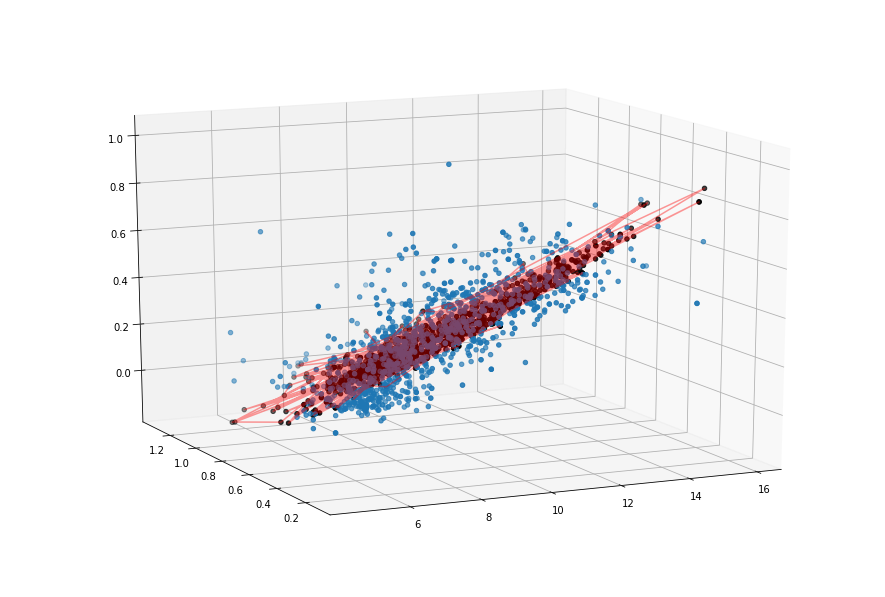

STEP: 5800, MSE: 0.0158, R2: 0.5987
Weights: [[ 0.07197139 -0.33140215]], Bias: [-0.1577133]


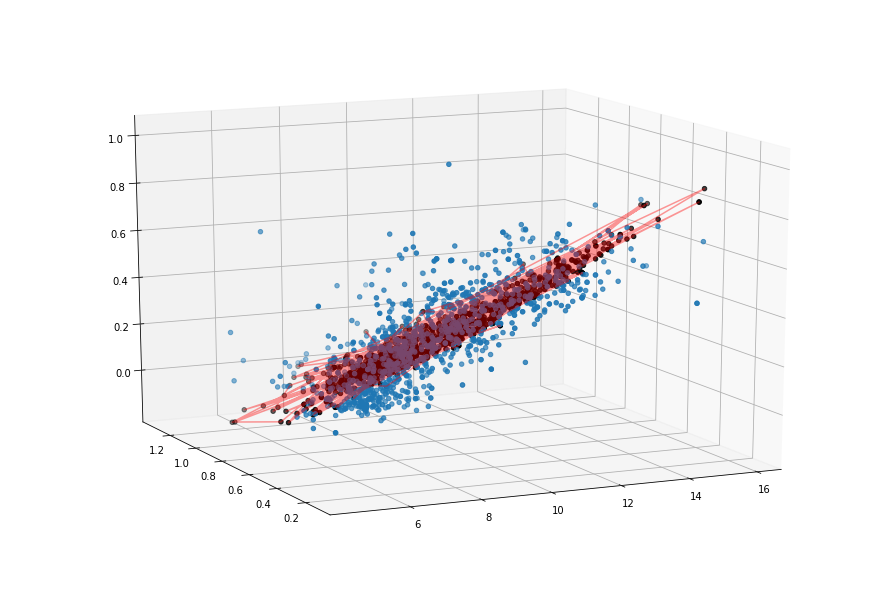

STEP: 5900, MSE: 0.0158, R2: 0.5994
Weights: [[ 0.07172003 -0.33462727]], Bias: [-0.15378922]


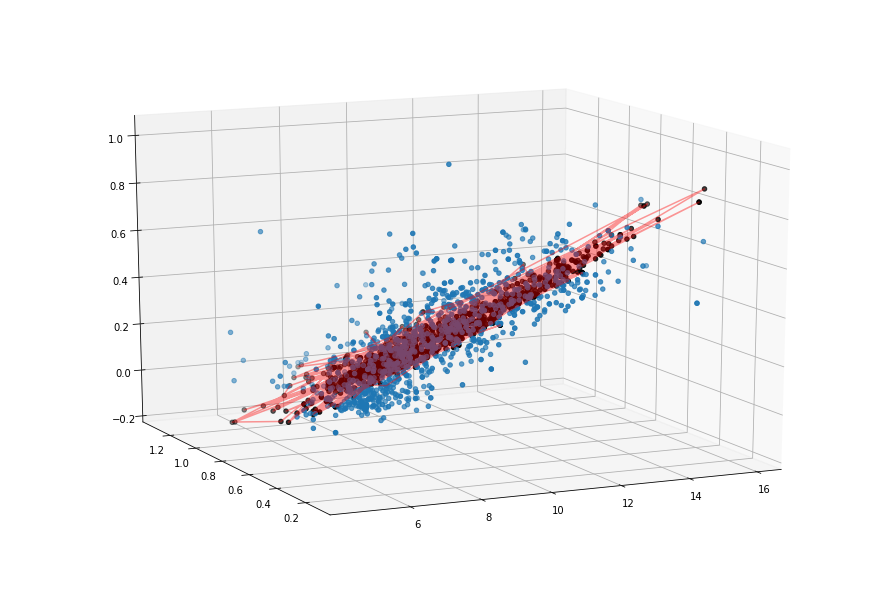

STEP: 6000, MSE: 0.0158, R2: 0.6000
Weights: [[ 0.07147622 -0.33775422]], Bias: [-0.14998384]


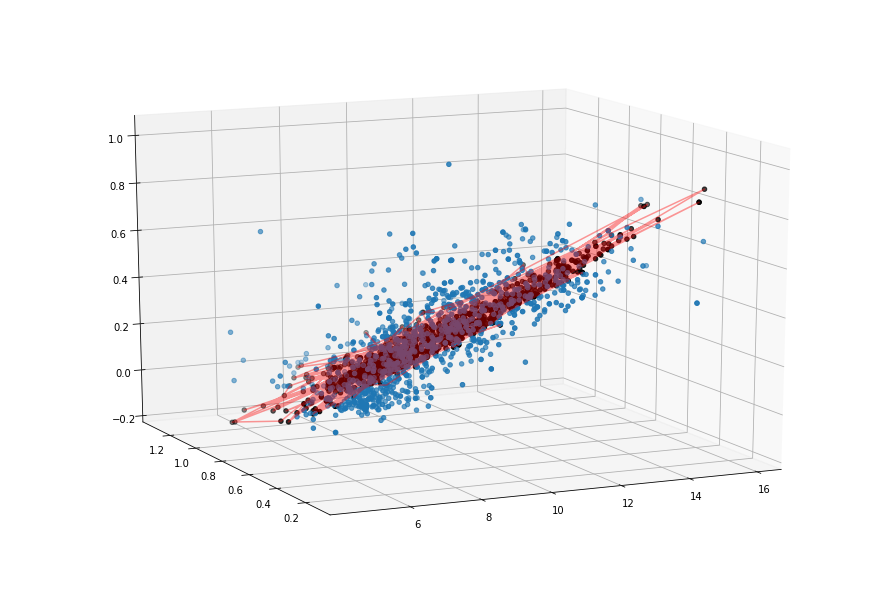

STEP: 6100, MSE: 0.0158, R2: 0.6006
Weights: [[ 0.07123978 -0.3407863 ]], Bias: [-0.14629358]


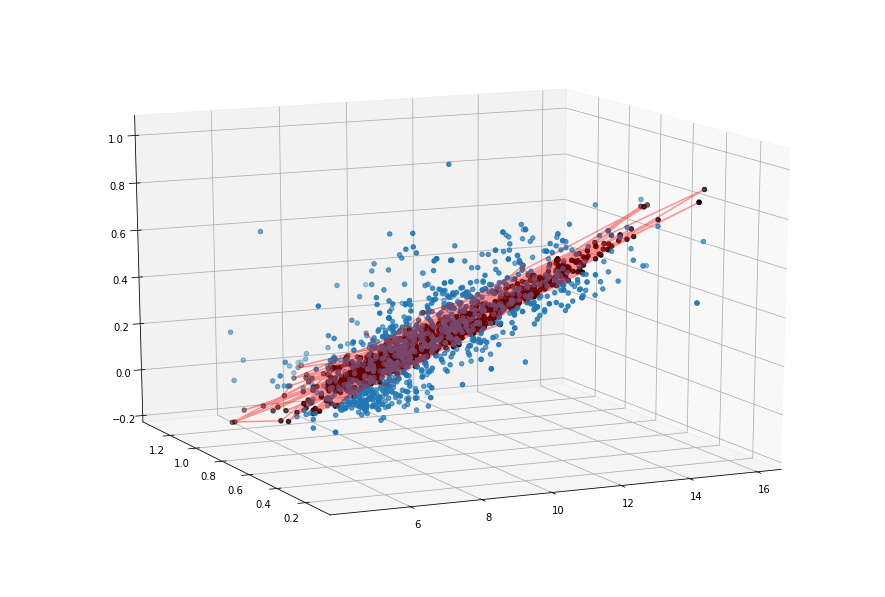

STEP: 6200, MSE: 0.0158, R2: 0.6011
Weights: [[ 0.07101048 -0.34372643]], Bias: [-0.14271502]


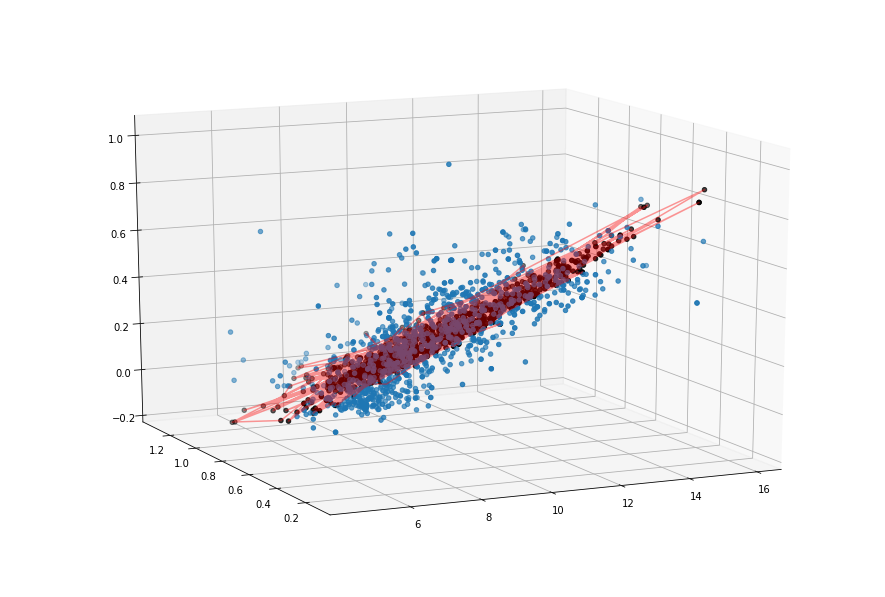

STEP: 6300, MSE: 0.0157, R2: 0.6017
Weights: [[ 0.07078811 -0.3465773 ]], Bias: [-0.1392448]


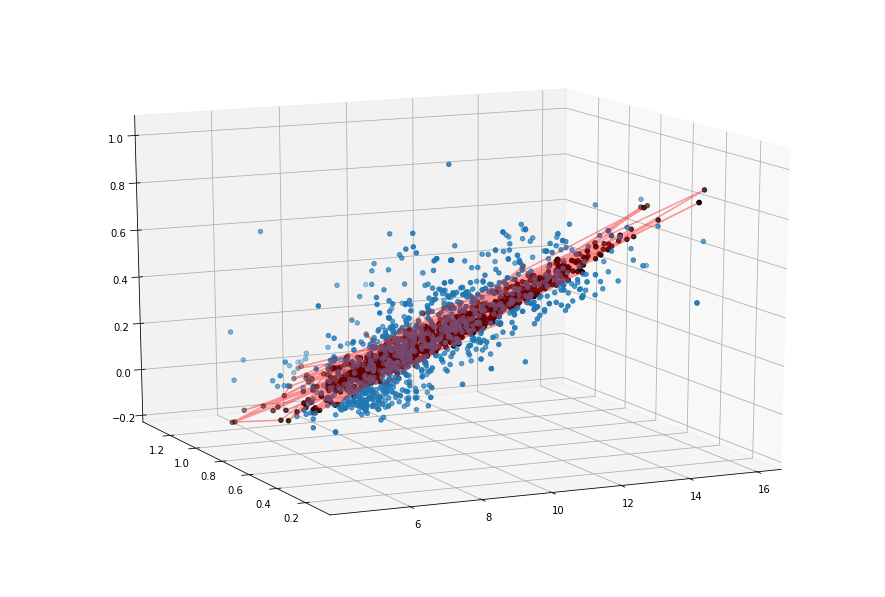

STEP: 6400, MSE: 0.0157, R2: 0.6021
Weights: [[ 0.07057246 -0.34934172]], Bias: [-0.13587962]


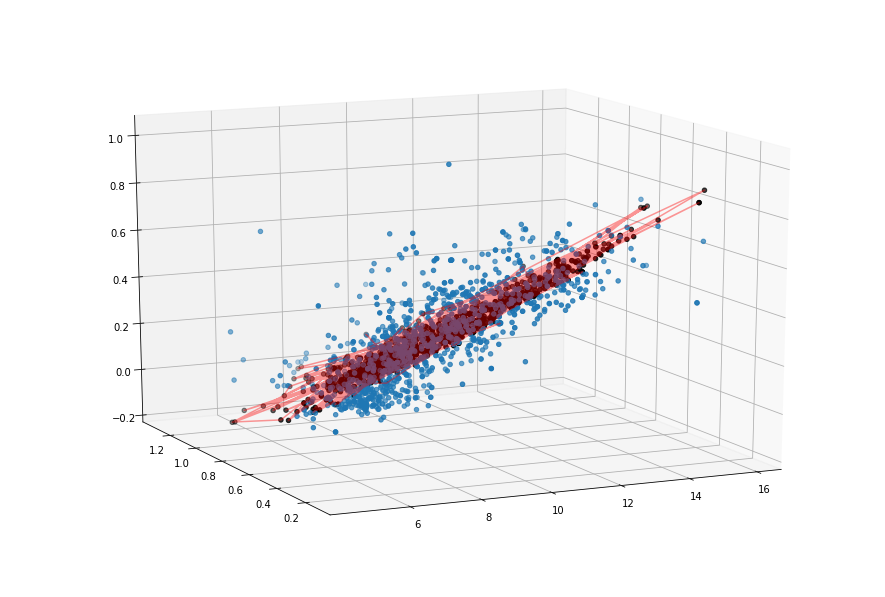

STEP: 6500, MSE: 0.0157, R2: 0.6026
Weights: [[ 0.07036333 -0.3520223 ]], Bias: [-0.1326163]


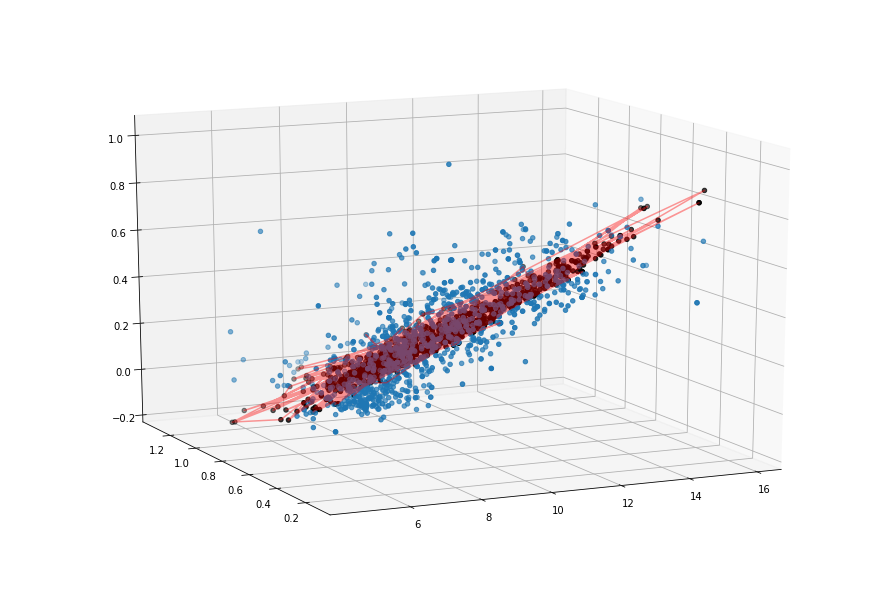

STEP: 6600, MSE: 0.0157, R2: 0.6030
Weights: [[ 0.07016053 -0.3546216 ]], Bias: [-0.12945178]


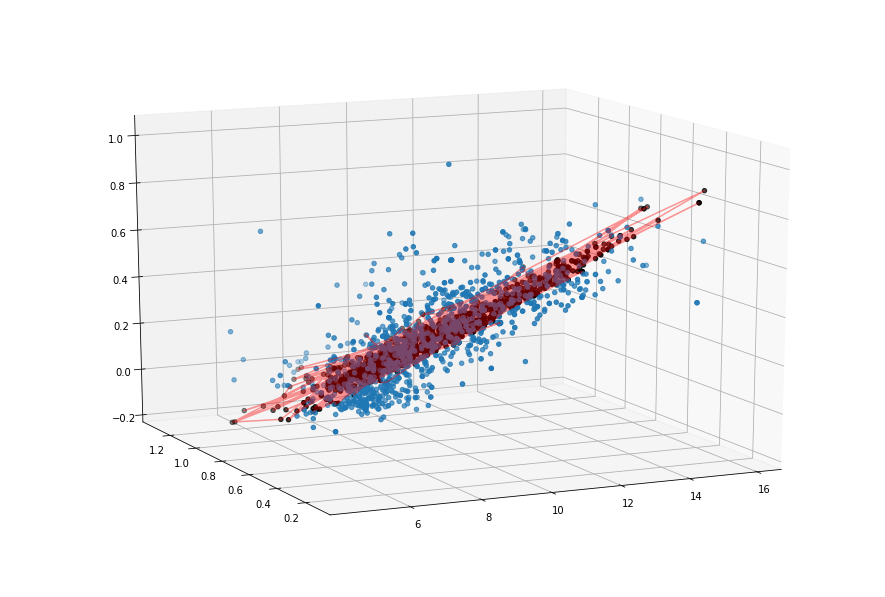

STEP: 6700, MSE: 0.0157, R2: 0.6034
Weights: [[ 0.06996385 -0.35714206]], Bias: [-0.12638307]


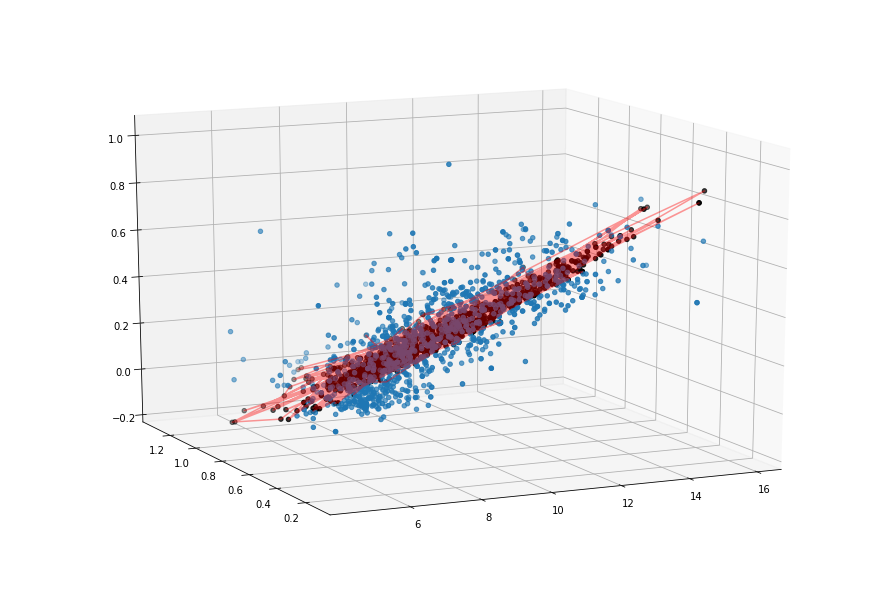

STEP: 6800, MSE: 0.0156, R2: 0.6038
Weights: [[ 0.06977312 -0.3595861 ]], Bias: [-0.12340723]


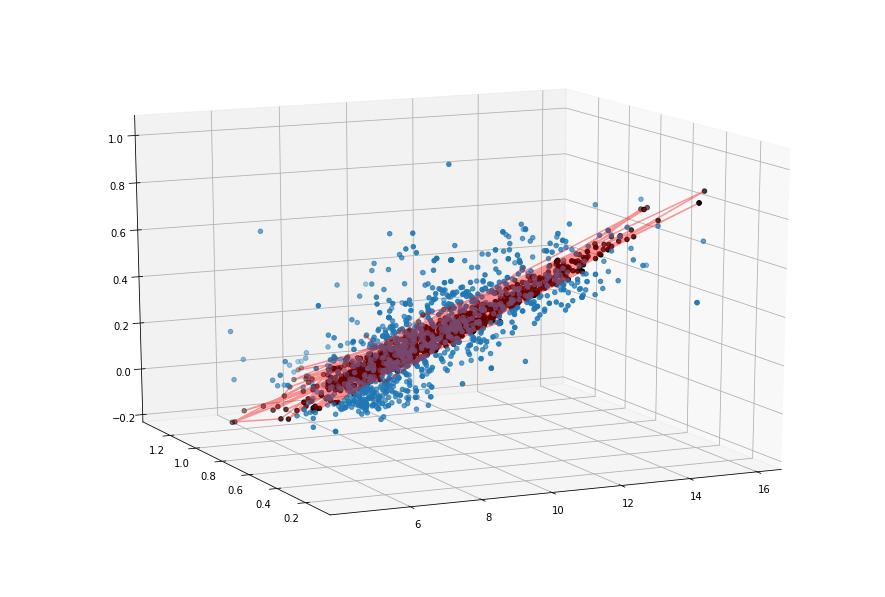

STEP: 6900, MSE: 0.0156, R2: 0.6041
Weights: [[ 0.06958818 -0.36195603]], Bias: [-0.12052155]


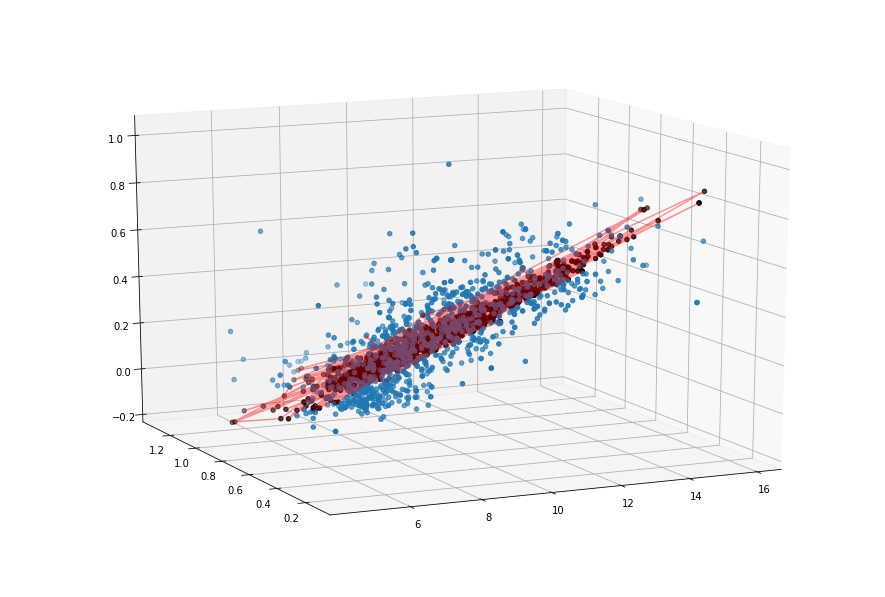

STEP: 7000, MSE: 0.0156, R2: 0.6045
Weights: [[ 0.06940882 -0.3642542 ]], Bias: [-0.11772326]


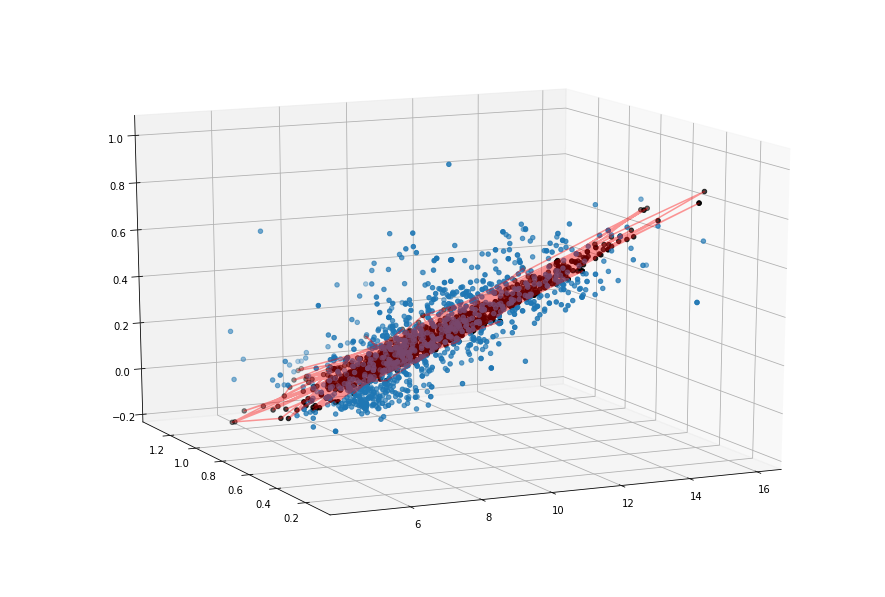

STEP: 7100, MSE: 0.0156, R2: 0.6048
Weights: [[ 0.06923489 -0.3664827 ]], Bias: [-0.11500973]


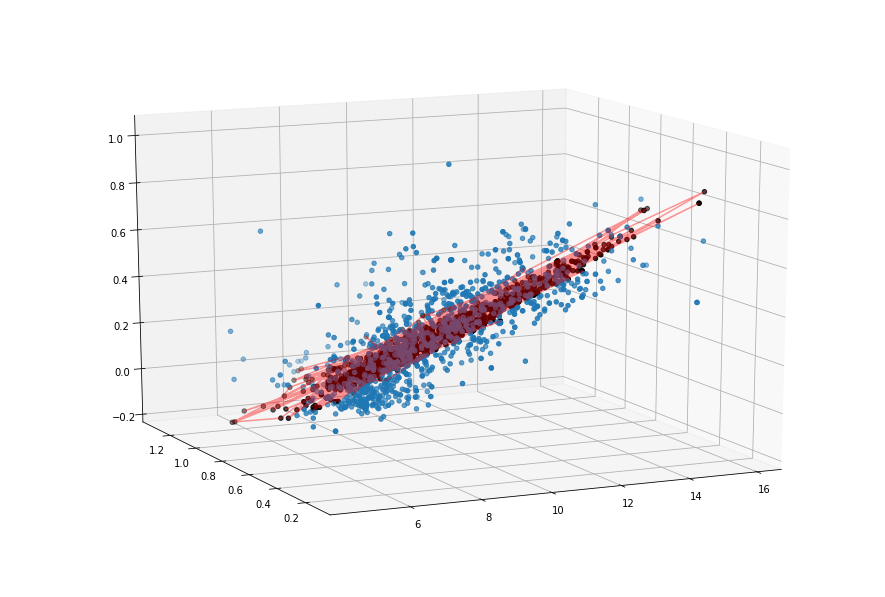

STEP: 7200, MSE: 0.0156, R2: 0.6051
Weights: [[ 0.06906623 -0.36864367]], Bias: [-0.11237834]


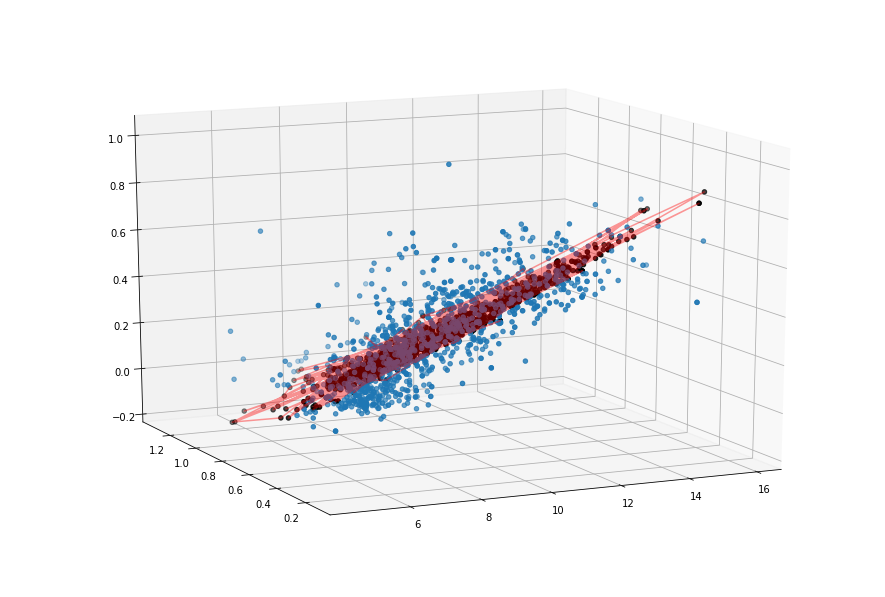

STEP: 7300, MSE: 0.0156, R2: 0.6054
Weights: [[ 0.06890268 -0.37073913]], Bias: [-0.10982667]


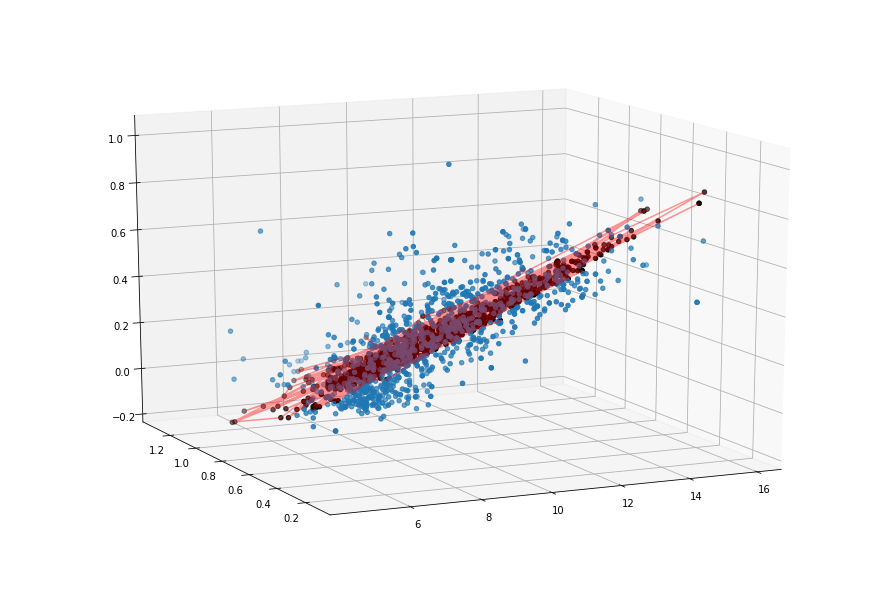

STEP: 7400, MSE: 0.0156, R2: 0.6056
Weights: [[ 0.06874407 -0.37277108]], Bias: [-0.10735225]


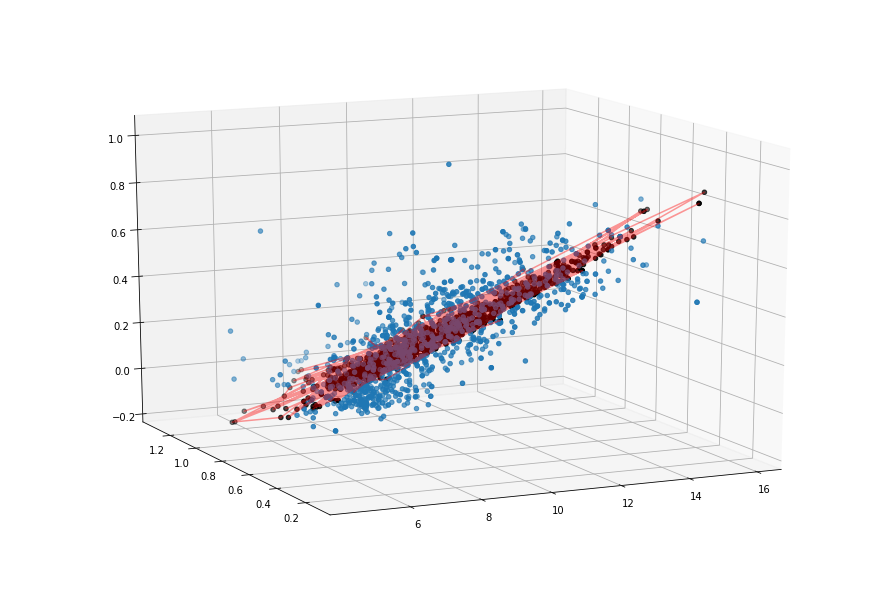

STEP: 7500, MSE: 0.0156, R2: 0.6059
Weights: [[ 0.06859026 -0.3747415 ]], Bias: [-0.10495271]


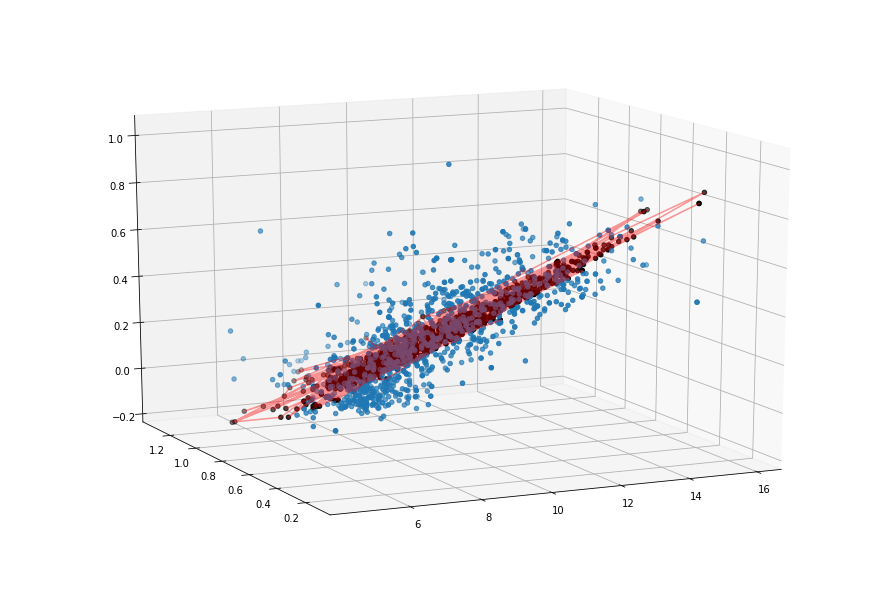

STEP: 7600, MSE: 0.0156, R2: 0.6061
Weights: [[ 0.06844112 -0.37665224]], Bias: [-0.10262593]


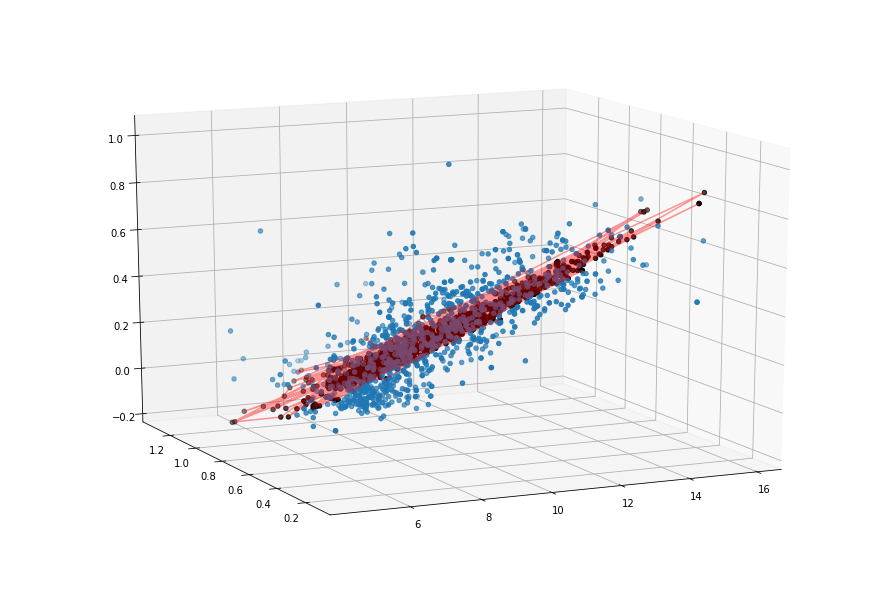

STEP: 7700, MSE: 0.0155, R2: 0.6063
Weights: [[ 0.06829648 -0.37850496]], Bias: [-0.10036964]


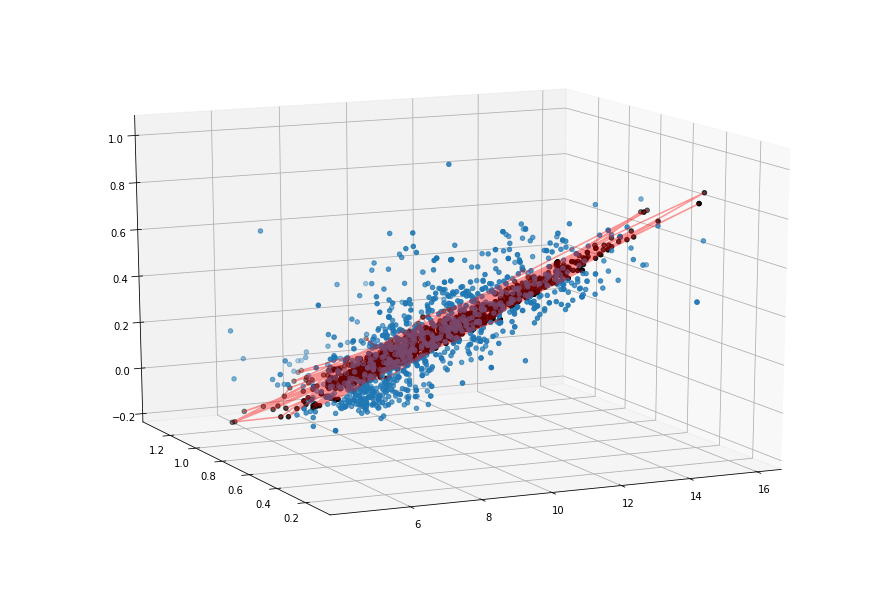

STEP: 7800, MSE: 0.0155, R2: 0.6065
Weights: [[ 0.06815623 -0.38030162]], Bias: [-0.09818167]


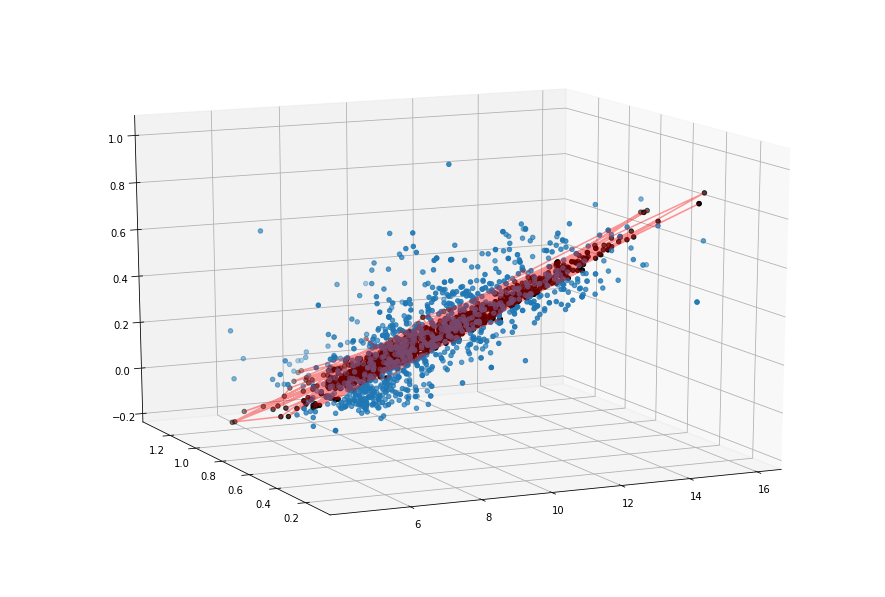

STEP: 7900, MSE: 0.0155, R2: 0.6067
Weights: [[ 0.06802023 -0.3820438 ]], Bias: [-0.09605998]


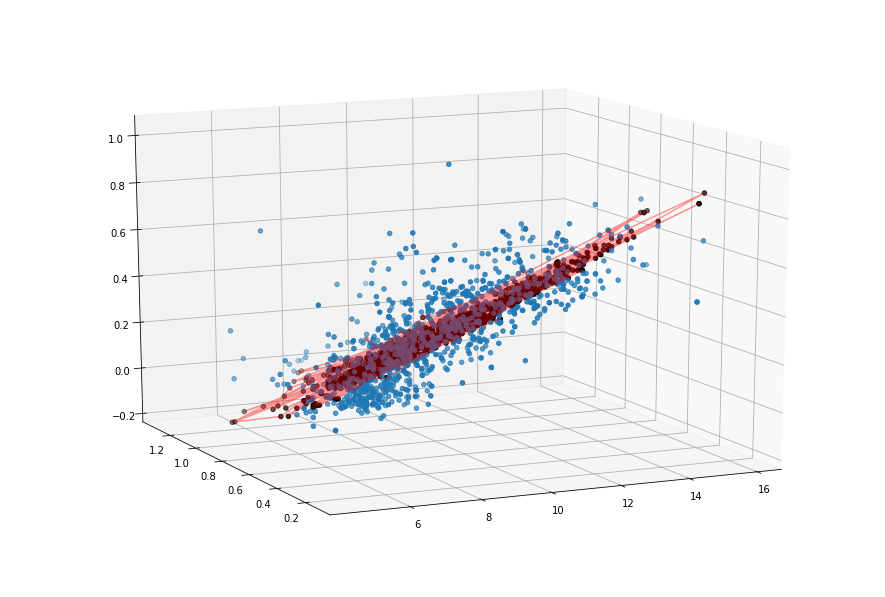

STEP: 8000, MSE: 0.0155, R2: 0.6069
Weights: [[ 0.06788835 -0.38373318]], Bias: [-0.09400254]


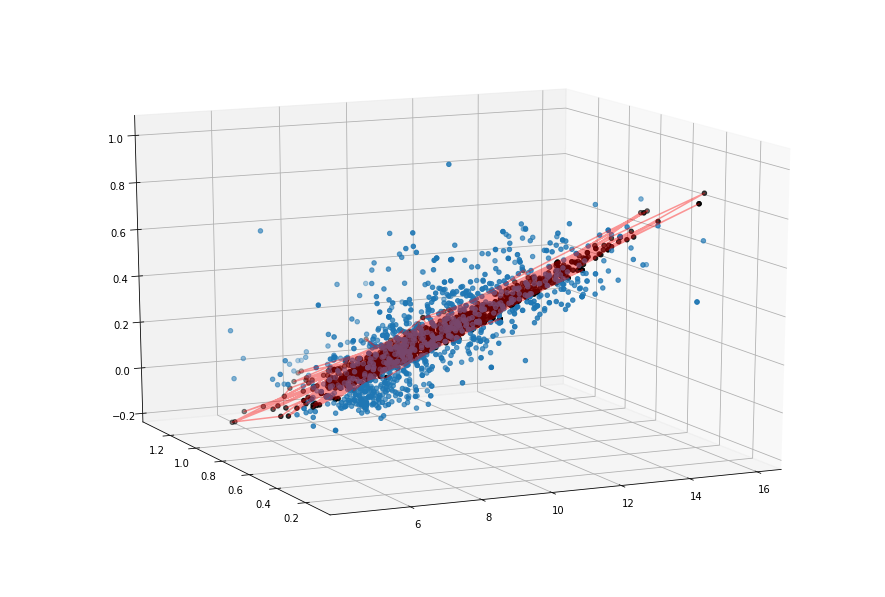

STEP: 8100, MSE: 0.0155, R2: 0.6071
Weights: [[ 0.06776045 -0.38537145]], Bias: [-0.09200743]


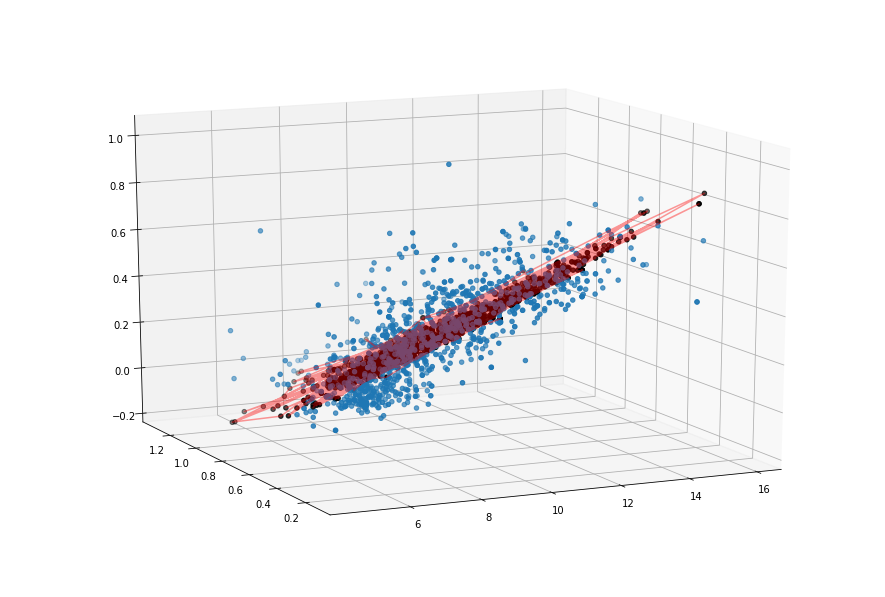

STEP: 8200, MSE: 0.0155, R2: 0.6072
Weights: [[ 0.06763644 -0.38696003]], Bias: [-0.09007276]


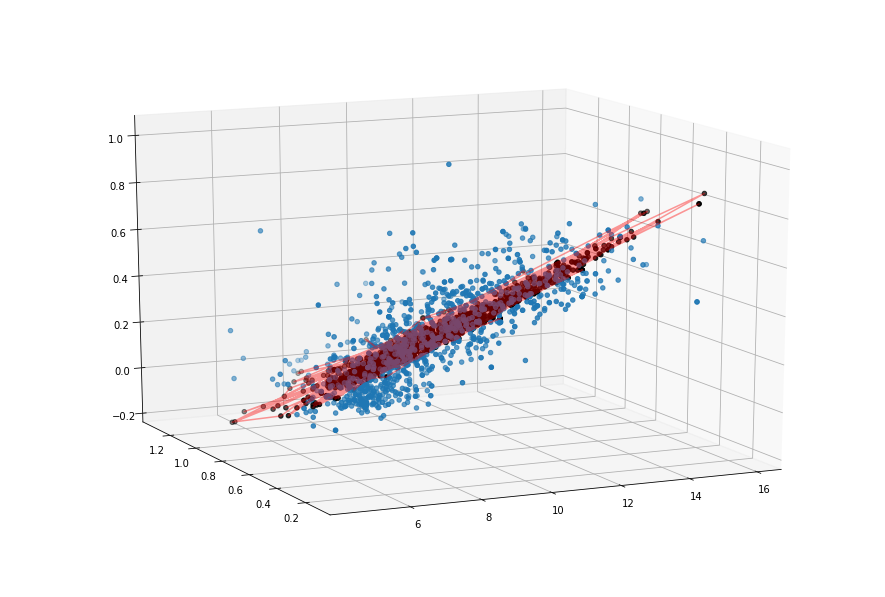

STEP: 8300, MSE: 0.0155, R2: 0.6074
Weights: [[ 0.06751618 -0.38850045]], Bias: [-0.08819669]


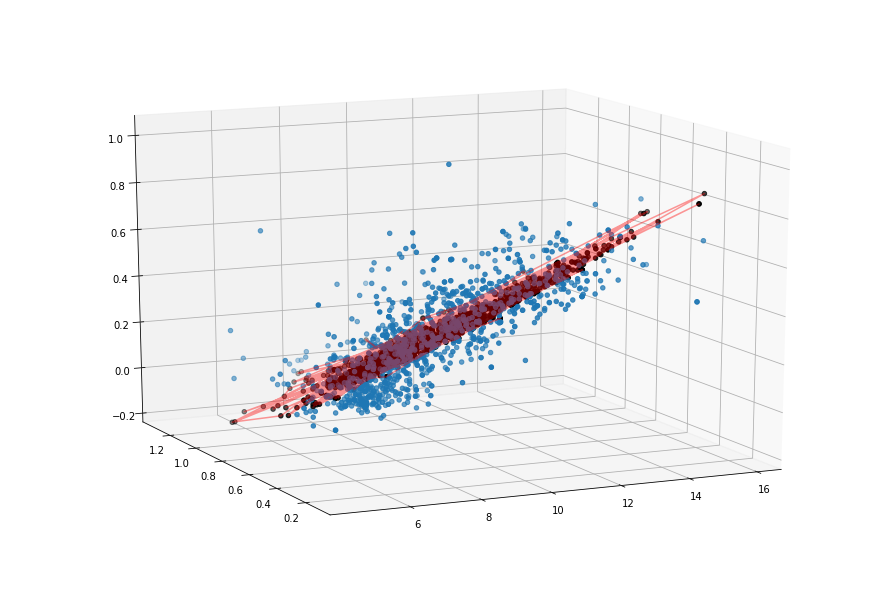

STEP: 8400, MSE: 0.0155, R2: 0.6075
Weights: [[ 0.06739955 -0.38999423]], Bias: [-0.08637747]


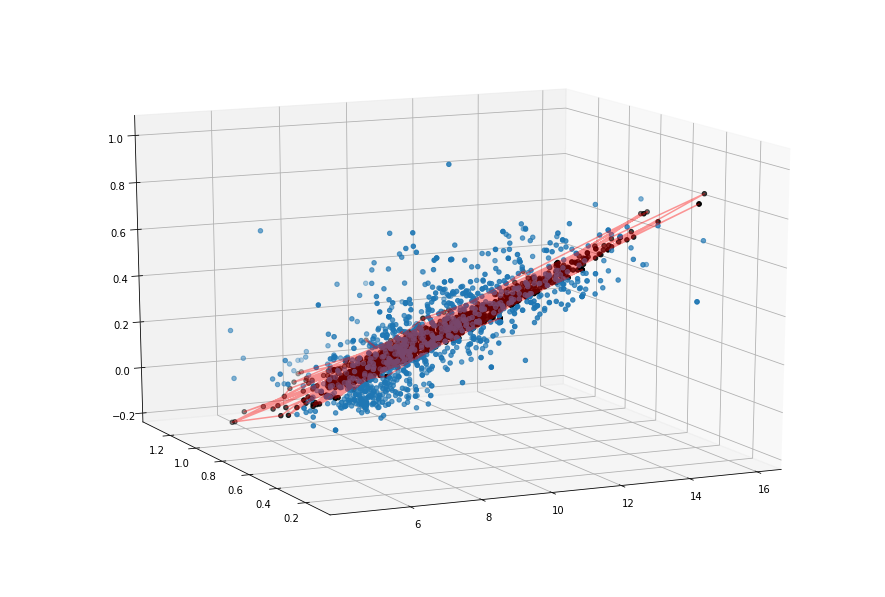

STEP: 8500, MSE: 0.0155, R2: 0.6076
Weights: [[ 0.06728647 -0.39144272]], Bias: [-0.08461335]


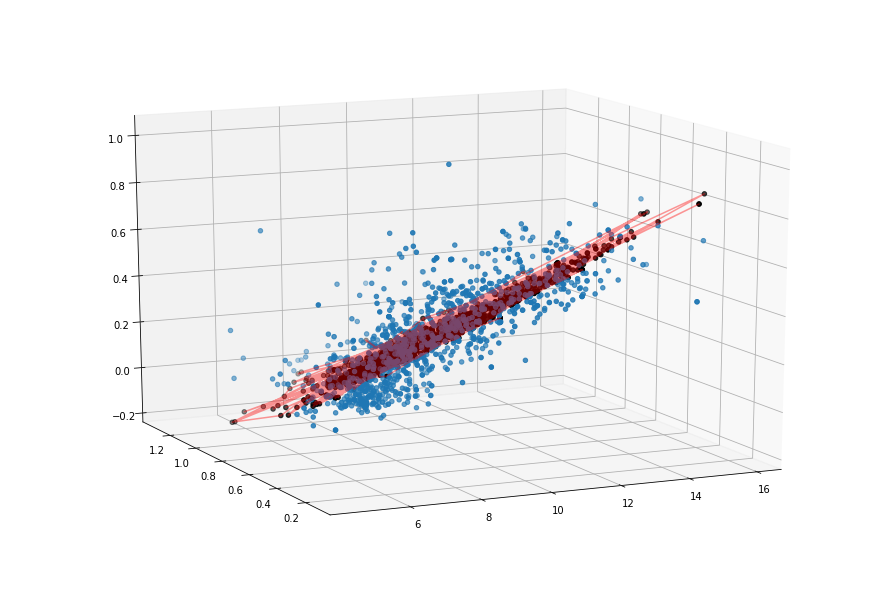

STEP: 8600, MSE: 0.0155, R2: 0.6078
Weights: [[ 0.0671768 -0.3928473]], Bias: [-0.08290267]


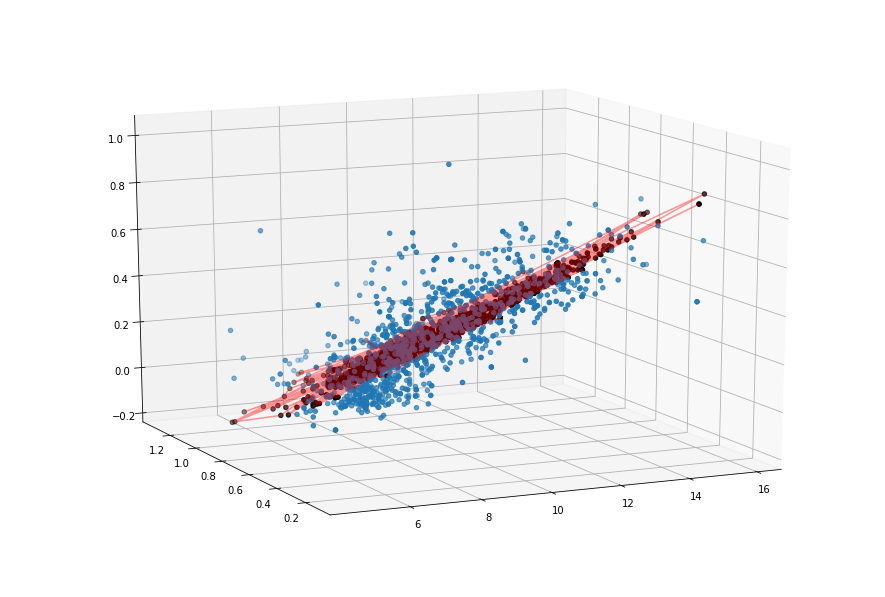

STEP: 8700, MSE: 0.0155, R2: 0.6079
Weights: [[ 0.06707047 -0.39420936]], Bias: [-0.0812438]


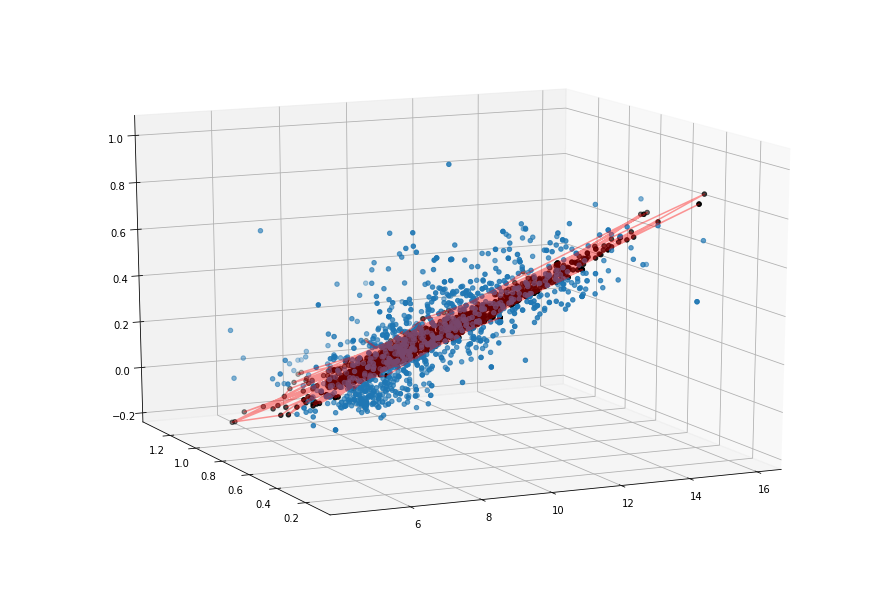

STEP: 8800, MSE: 0.0155, R2: 0.6080
Weights: [[ 0.06696735 -0.39553016]], Bias: [-0.07963519]


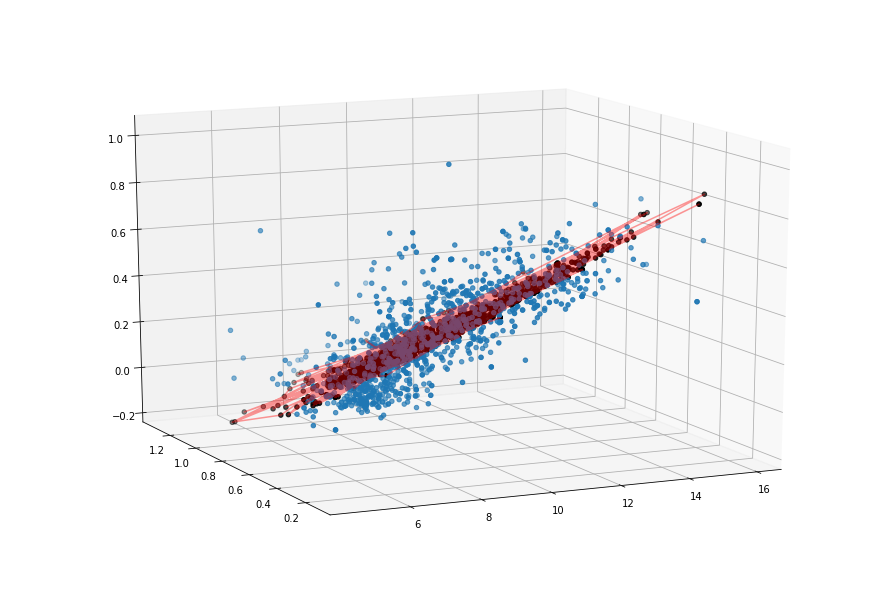

STEP: 8900, MSE: 0.0155, R2: 0.6081
Weights: [[ 0.06686735 -0.39681095]], Bias: [-0.0780753]


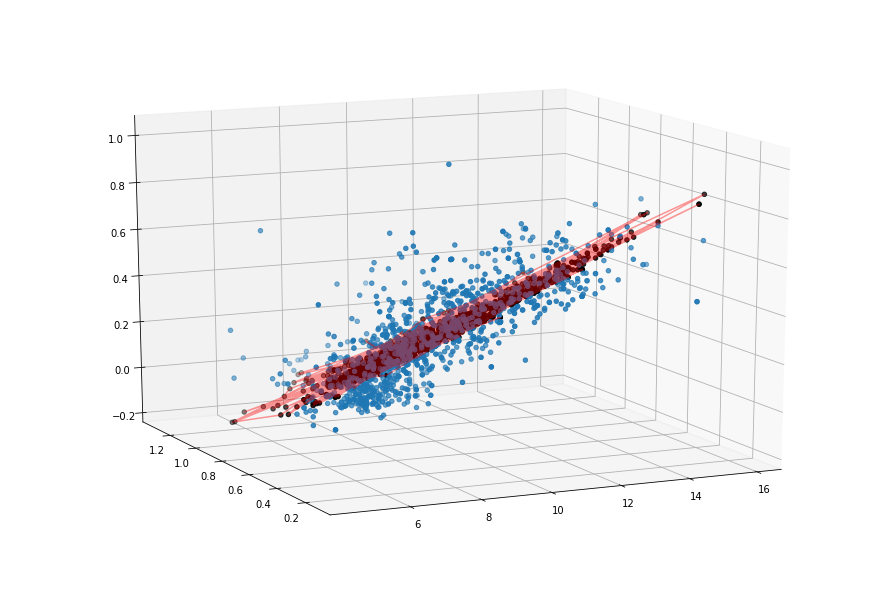

STEP: 9000, MSE: 0.0155, R2: 0.6082
Weights: [[ 0.06677039 -0.39805296]], Bias: [-0.0765627]


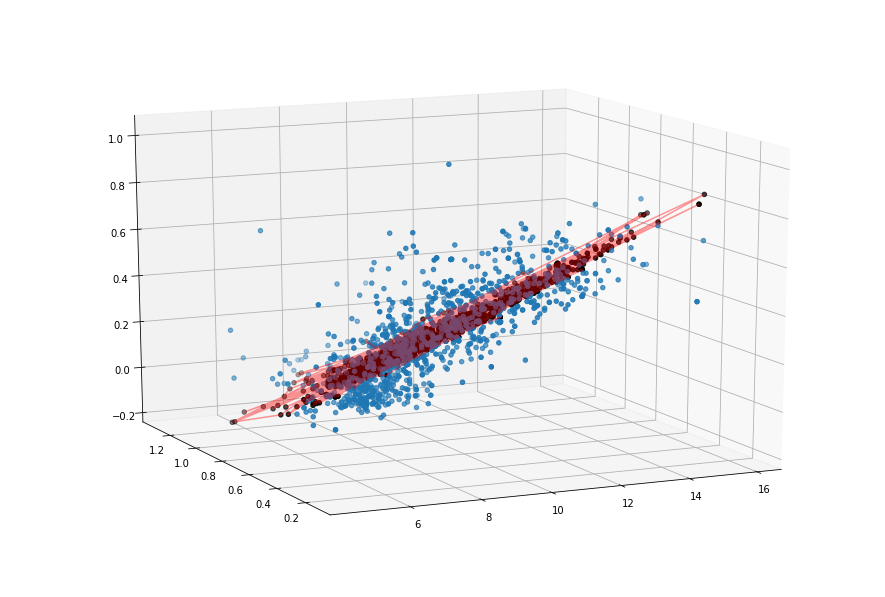

STEP: 9100, MSE: 0.0155, R2: 0.6083
Weights: [[ 0.06667636 -0.39925733]], Bias: [-0.0750959]


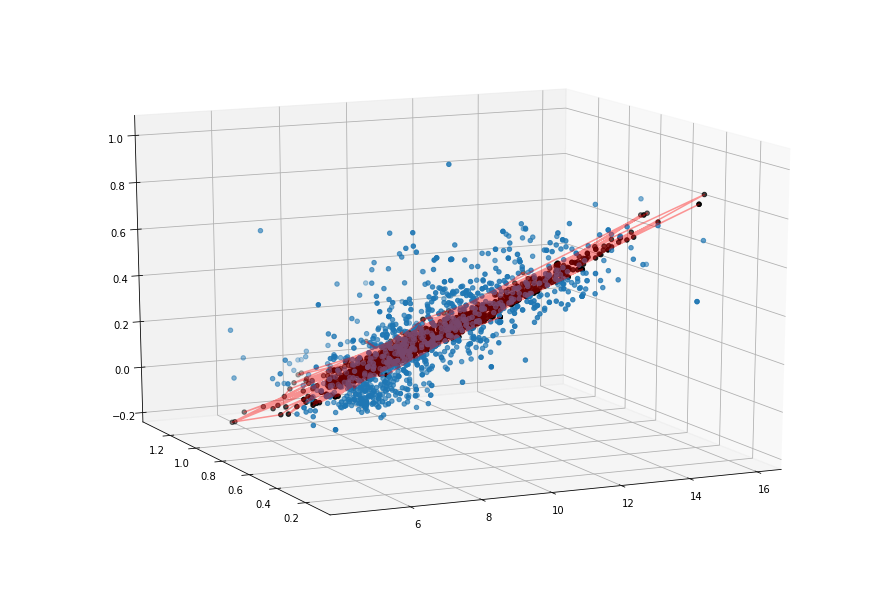

STEP: 9200, MSE: 0.0155, R2: 0.6084
Weights: [[ 0.06658518 -0.40042523]], Bias: [-0.07367354]


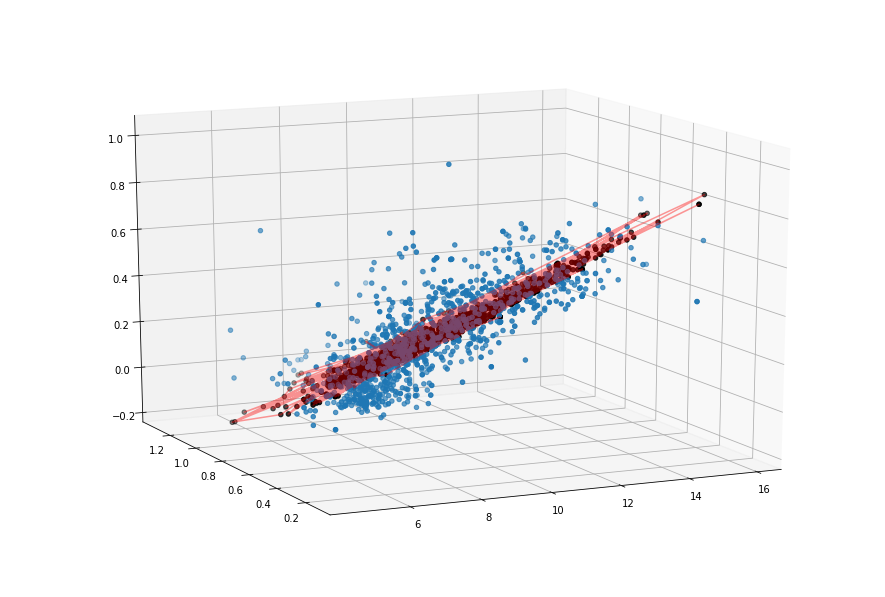

STEP: 9300, MSE: 0.0155, R2: 0.6084
Weights: [[ 0.06649677 -0.40155774]], Bias: [-0.07229424]


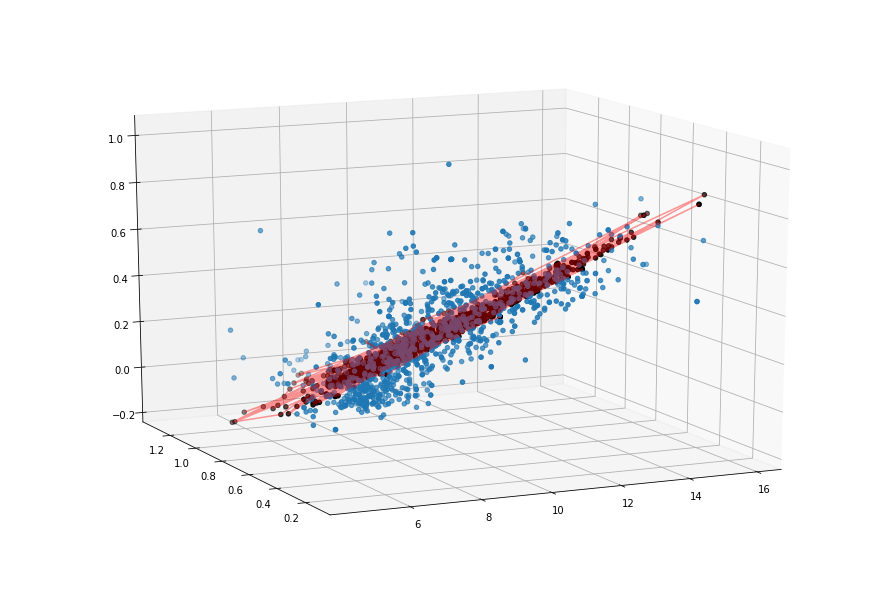

STEP: 9400, MSE: 0.0155, R2: 0.6085
Weights: [[ 0.06641103 -0.40265596]], Bias: [-0.07095674]


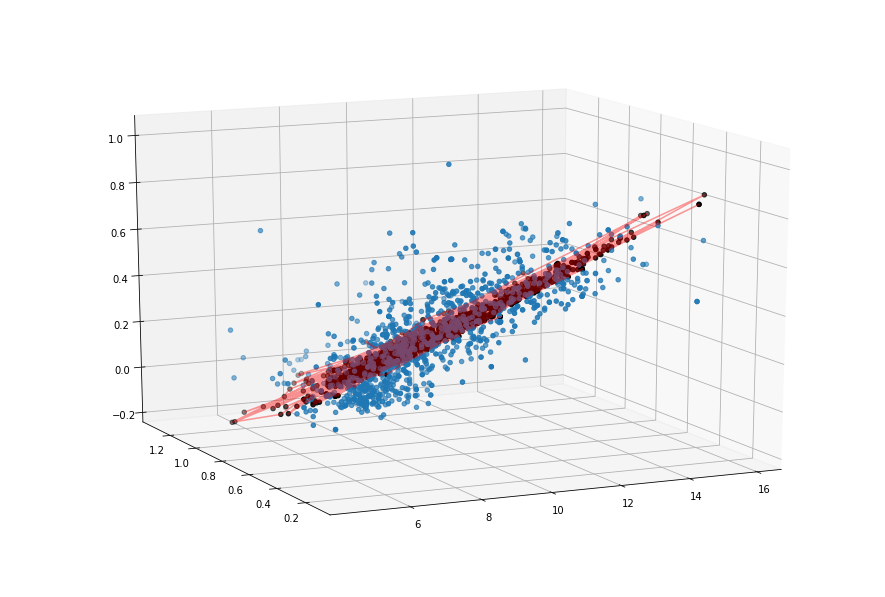

STEP: 9500, MSE: 0.0155, R2: 0.6086
Weights: [[ 0.06632788 -0.40372086]], Bias: [-0.06965975]


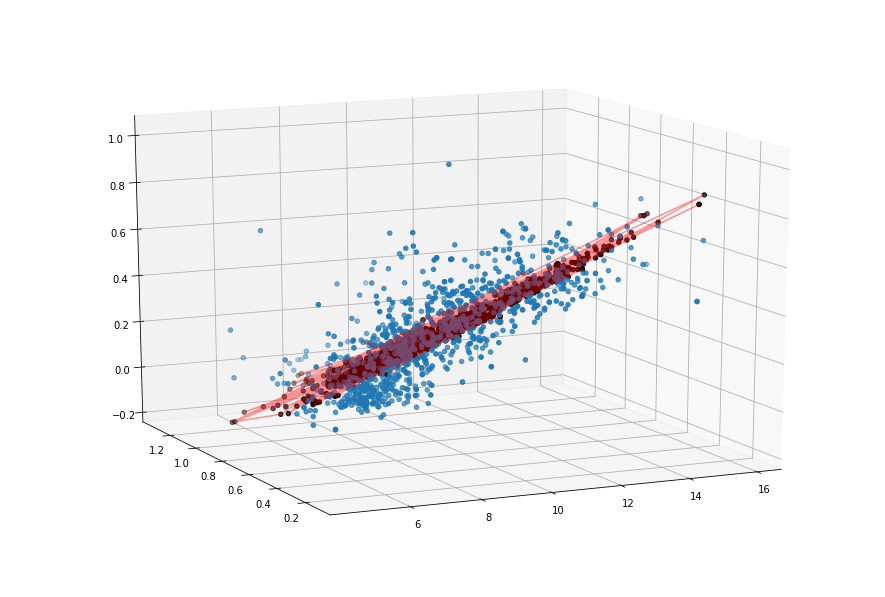

STEP: 9600, MSE: 0.0155, R2: 0.6087
Weights: [[ 0.06624725 -0.40475357]], Bias: [-0.06840203]


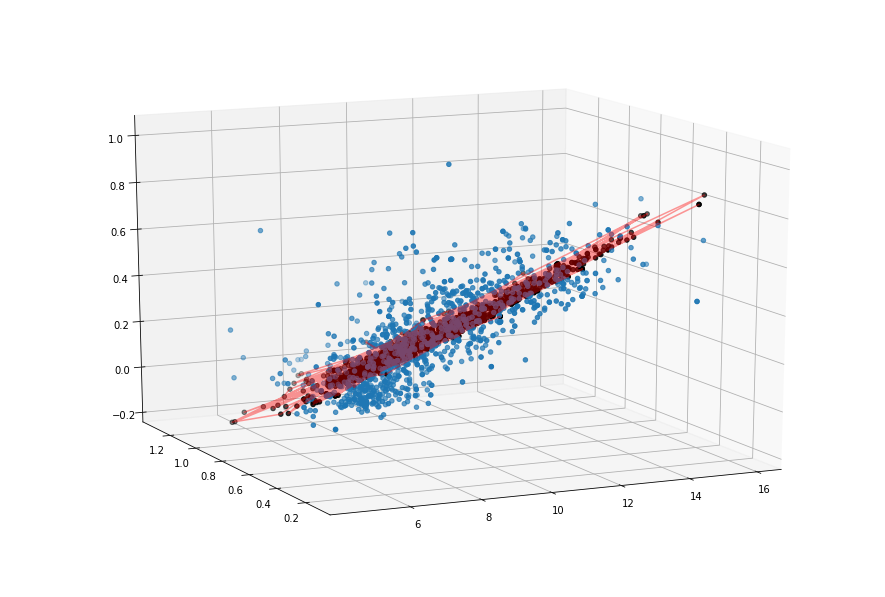

STEP: 9700, MSE: 0.0155, R2: 0.6087
Weights: [[ 0.06616907 -0.40575495]], Bias: [-0.06718238]


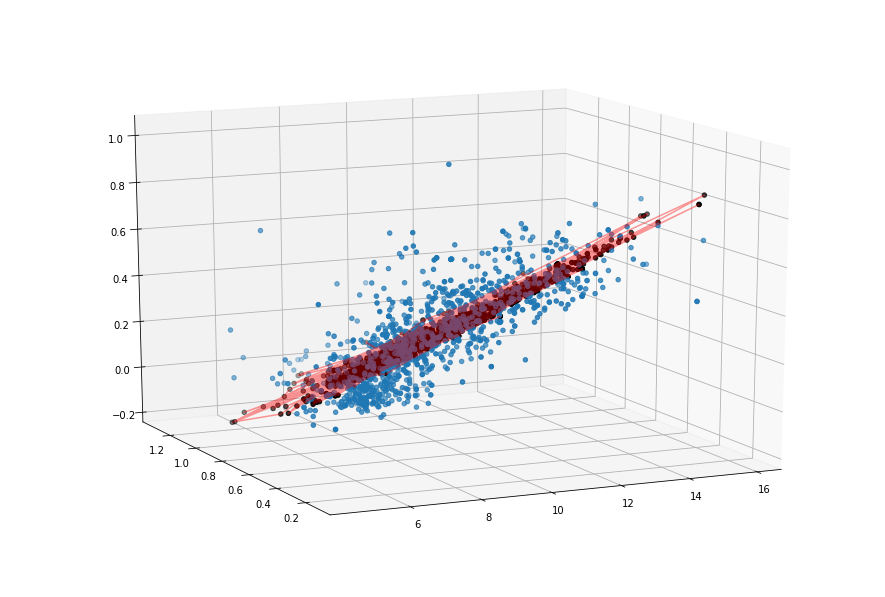

STEP: 9800, MSE: 0.0154, R2: 0.6088
Weights: [[ 0.06609325 -0.40672597]], Bias: [-0.06599973]


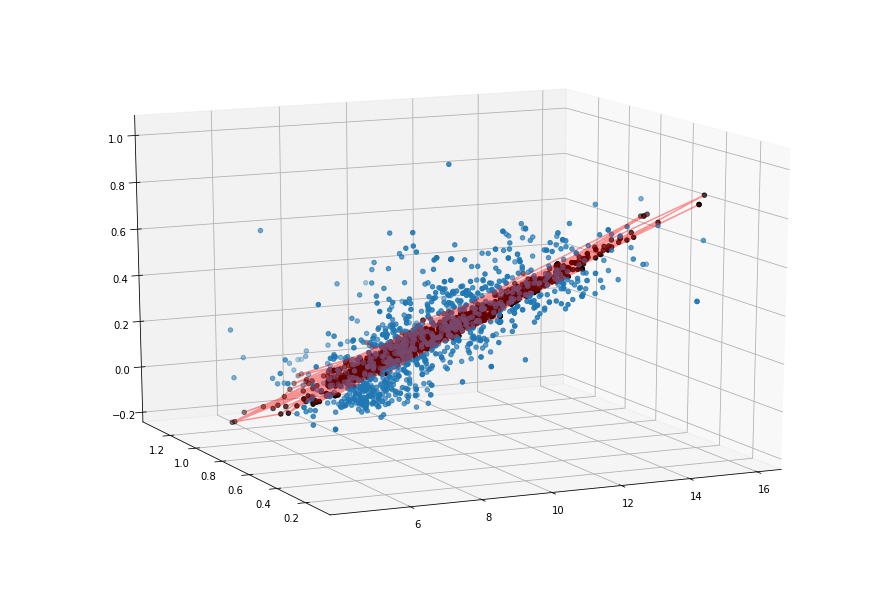

STEP: 9900, MSE: 0.0154, R2: 0.6088
Weights: [[ 0.06601974 -0.4076676 ]], Bias: [-0.06485295]


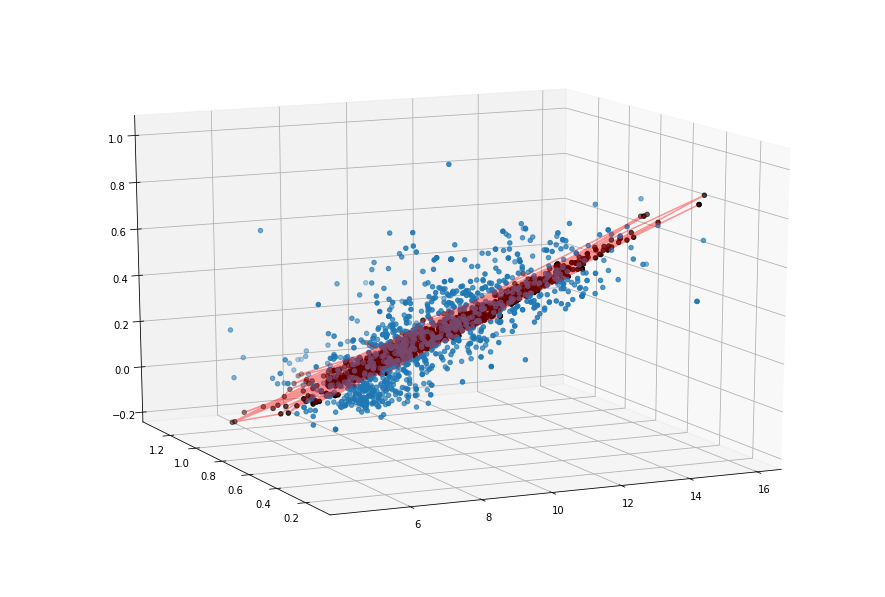

In [22]:
config = tf.ConfigProto(log_device_placement=True)
config.gpu_options.allow_growth = True
with tf.Session(config=config) as sess:
    sess.run(tf.global_variables_initializer())
    for step in range(training_epochs):
        
        feedDict = {X1: trainX1, Y_train: trainY}
        #sess.run(model1, feed_dict=feedDict)
        model1.run(feedDict)

        if step % display_step == 0:
            cost_step = costFunc.eval(feedDict)
            rsquare = rsquareFunc.eval(feedDict)
            msg0 = 'STEP: {:>3}, MSE: {:02.4f}, R2: {:02.4f}'.format(step, cost_step, rsquare)
            msg1 = 'Weights: {}, Bias: {}'.format(sess.run(W1).reshape((1,nDim1)), sess.run(b1))
            print(msg0)
            print(msg1)
            
            fig = plt.figure(figsize=(12, 8))
            #ax = fig.add_subplot(111, projection='3d')
            ax = Axes3D(fig, azim=-115, elev=15)
            Z1 = trainX1 @ sess.run(W1) + sess.run(b1)
            
            ax.scatter(trainX1.T[0], trainX1.T[1], trainY)
            ax.scatter(trainX1.T[0], trainX1.T[1], Z1.T[0], color='black')
            ax.plot(trainX1.T[0], trainX1.T[1], Z1.T[0], color='red', alpha=.4)
            plt.show()
            #print(trainX1 @ sess.run(W1) + sess.run(b1))
            #plt.plot(trainX1[0], trainX1[1], trainY, c='r', marker='o', label='STEP: {step}'.format(step=step))
            #plt.plot(trainX1, trainX1 @sess.run(W1) + sess.run(b1))
            #plt.show()

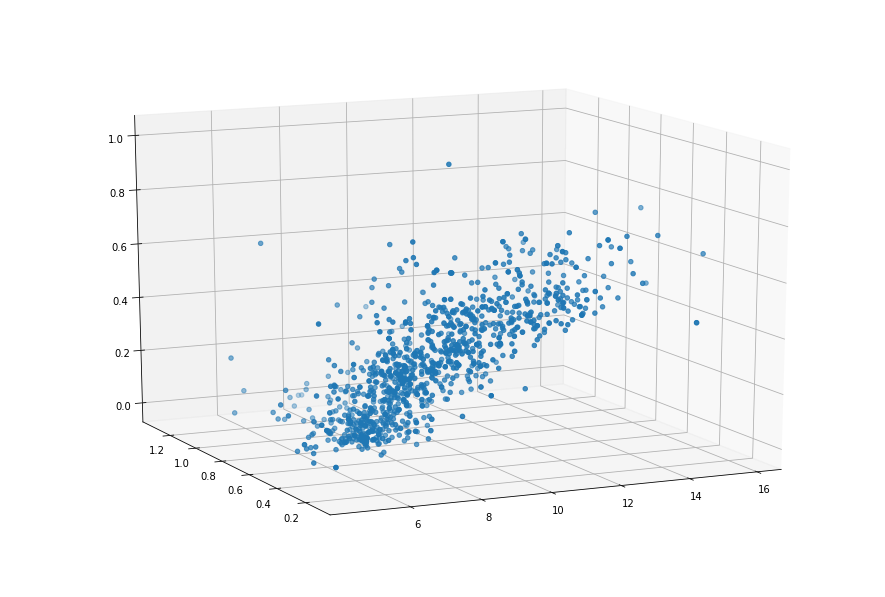

In [23]:
fig = plt.figure(figsize=(12, 8))
ax = Axes3D(fig, azim=-115, elev=15)

ax.scatter(trainX1.T[0], trainX1.T[1], trainY)
plt.show()

### Using `tf.placeholder`, 3 columns

In [24]:
# Variables
X2 = tf.placeholder(tf.float32, [None, nDim2])
Y_train = tf.placeholder(tf.float32, [None, 1])

W2 = tf.Variable(tf.random_normal([nDim2, 1]), name='weight')
b2 = tf.Variable(tf.random_normal([1]), name='bias')

In [25]:
y_pred_2 = tf.add(tf.matmul(X2, W2), b2)

costFunc = tf.reduce_mean(tf.square(Y_train - y_pred_2))  # Mean Squared Error
Y_mean = tf.reduce_mean(Y_train)
rsquareFunc = 1 - (tf.reduce_sum(tf.square(Y_train - y_pred_2)) / tf.reduce_sum(tf.square(Y_train - Y_mean)))
#rsquareFunc = tf.reduce_sum(tf.square(y_pred - Y_mean)) / tf.reduce_sum(tf.square(y_train - Y_mean))

optimizer = tf.train.GradientDescentOptimizer(learning_rate=learning_rate)
model2 = optimizer.minimize(costFunc)

In [26]:
config = tf.ConfigProto(log_device_placement=True)
config.gpu_options.allow_growth = True
with tf.Session(config=config) as sess:
    sess.run(tf.global_variables_initializer())
    for step in range(training_epochs):
        
        feedDict = feedDict = {X2: trainX2, Y_train: trainY}
        #sess.run(model1, feed_dict=feedDict)
        model2.run(feedDict)

        if step % display_step == 0:
            cost_step = costFunc.eval(feedDict)
            rsquare = rsquareFunc.eval(feedDict)
            msg0 = 'STEP: {:>3}, MSE: {:02.4f}, R2: {:02.4f}'.format(step, cost_step, rsquare)
            msg1 = 'Weights: {}, Bias: {}'.format(sess.run(W2).reshape((1,nDim2)), sess.run(b2))
            print(msg0)
            print(msg1)

STEP:   0, MSE: 1.7258, R2: -42.7012
Weights: [[ 0.5467051  -0.81062174 -0.810724  ]], Bias: [-0.48334065]
STEP: 100, MSE: 0.0788, R2: -0.9952
Weights: [[ 0.182402   -0.6659284  -0.19774492]], Bias: [-0.33052668]
STEP: 200, MSE: 0.0224, R2: 0.4326
Weights: [[ 1.0169202e-01 -6.1309206e-01 -1.8214667e-04]], Bias: [-0.27957332]
STEP: 300, MSE: 0.0170, R2: 0.5689
Weights: [[ 0.07705808 -0.5905423   0.05887803]], Bias: [-0.26325685]
STEP: 400, MSE: 0.0164, R2: 0.5836
Weights: [[ 0.06960554 -0.5776254   0.07555392]], Bias: [-0.25754276]
STEP: 500, MSE: 0.0163, R2: 0.5867
Weights: [[ 0.06741307 -0.5679918   0.07930354]], Bias: [-0.25506553]
STEP: 600, MSE: 0.0162, R2: 0.5886
Weights: [[ 0.06682691 -0.5596768   0.07915258]], Bias: [-0.25356823]
STEP: 700, MSE: 0.0162, R2: 0.5901
Weights: [[ 0.06672744 -0.55206144  0.07786426]], Bias: [-0.25235957]
STEP: 800, MSE: 0.0161, R2: 0.5915
Weights: [[ 0.06677182 -0.5449389   0.07628224]], Bias: [-0.2512285]
STEP: 900, MSE: 0.0161, R2: 0.5927
Weights: 

STEP: 8000, MSE: 0.0156, R2: 0.6060
Weights: [[ 0.06736713 -0.42557484  0.02849015]], Bias: [-0.16117774]
STEP: 8100, MSE: 0.0156, R2: 0.6060
Weights: [[ 0.06734742 -0.42546707  0.02814864]], Bias: [-0.15993626]
STEP: 8200, MSE: 0.0156, R2: 0.6061
Weights: [[ 0.06732764 -0.42536554  0.02780887]], Bias: [-0.1586967]
STEP: 8300, MSE: 0.0156, R2: 0.6061
Weights: [[ 0.06730779 -0.42526987  0.0274708 ]], Bias: [-0.15745893]
STEP: 8400, MSE: 0.0156, R2: 0.6061
Weights: [[ 0.06728785 -0.42517975  0.02713434]], Bias: [-0.15622291]
STEP: 8500, MSE: 0.0156, R2: 0.6062
Weights: [[ 0.06726784 -0.42509493  0.02679947]], Bias: [-0.15498862]
STEP: 8600, MSE: 0.0156, R2: 0.6062
Weights: [[ 0.06724777 -0.42501533  0.02646608]], Bias: [-0.15375616]
STEP: 8700, MSE: 0.0155, R2: 0.6063
Weights: [[ 0.06722766 -0.42494014  0.02613414]], Bias: [-0.15252568]
STEP: 8800, MSE: 0.0155, R2: 0.6063
Weights: [[ 0.06720751 -0.42486975  0.0258036 ]], Bias: [-0.15129697]
STEP: 8900, MSE: 0.0155, R2: 0.6063
Weights: [[

In [28]:
tf.__version__

'1.4.0'

Done.